In [1]:
%load_ext autoreload


In [2]:
%matplotlib inline
%autoreload 1
import pickle
import numpy as np
from functools import partial
import MDAnalysis

from pathlib import Path

import matplotlib.pyplot as plt
import numpy.typing as npt

import pandas as pd

from scipy import integrate, interpolate, stats, signal
from scipy.optimize import curve_fit
from tqdm.auto import tqdm
from tqdm.contrib.concurrent import process_map

%aimport util
from plot_helper import *


Matplotlib Version: 3.6.3


In [3]:
from MDAnalysis.analysis.leaflet import LeafletFinder

def largest_groups(atoms):
    """
    From a list of sizes, find out the indices of the two largest groups. These should correspond to the two leaflets of the bilayer.

    Keyword arguments:
    atoms -- list of sizes of clusters identified by LeafletFinder
    """
    largest = 0
    second_largest = 0

    for i in atoms:
        if atoms[i] > largest:
            largest_index = i
            largest = atoms[i]

    for i in atoms:
        if atoms[i] > second_largest and i != largest_index:
            second_largest_index = i
            second_largest = atoms[i]

    return (largest_index, second_largest_index)


def determine_leaflets(universe, selection="all"):
    """
    From a selection of phosphates, determine which belong to the upper and lower leaflets.

    Keyword arguments:
    universe -- an MDAnalysis Universe object
    phosphateSelection -- a string specifying how to select the phosphate atoms (e.g. "name P1")
    """
    leaflets = {}

    # calculate the z value of the phosphates defining the bilayer (assumes bilayer is in x and y..)
    ag = universe.atoms.select_atoms(selection)
    bilayerCentre = ag.center_of_geometry()[2]

    # apply the MDAnalysis LeafletFinder graph-based method to determine the two largest groups which
    #  should correspond to the upper and lower leaflets
    phosphates = LeafletFinder(universe, selection)

    # find the two largest groups - required as the first two returned by LeafletFinder, whilst usually are the largest, this is not always so
    (a, b) = largest_groups(phosphates.sizes())

    # check to see where the first leaflet lies
    if phosphates.group(a).centroid()[2] > bilayerCentre:
        leaflets["upper"] = phosphates.group(a)
        leaflets["lower"] = phosphates.group(b)
    else:
        leaflets["lower"] = phosphates.group(a)
        leaflets["upper"] = phosphates.group(b)

    return leaflets


In [4]:
lipids = ["POPC", "DOPC", "POPE", "DOPE", "CDL1", "CDL2", "POPG", "DOPG"]
leaflets = ["upper", "lower"]

queries = {
    "PC": "resname POPC or resname DOPC",
    "PE": "resname POPE or resname DOPE",
    "CDL": "resname CDL1 or resname CDL2",
    "PG": "resname POPG or resname DOPG",
}

po4_neighbor_sel = "name PO4 or name GL0"

def get_midpoints(x):
    return ((x + np.roll(x, -1))/2)[:-1]

def mean_curvature(Z):
    """
    Calculates mean curvature from Z cloud points.


    Parameters
    ----------
    Z: np.ndarray.
        Multidimensional array of shape (n,n).


    Returns
    -------
    H : np.ndarray.
        The result of gaussian curvature of Z. Returns multidimensional
        array object with values of gaussian curvature of shape `(n, n)`.

    """

    Zy, Zx = np.gradient(Z)
    Zxy, Zxx = np.gradient(Zx)
    Zyy, _ = np.gradient(Zy)

    H = (1 + Zx**2) * Zyy + (1 + Zy**2) * Zxx - 2 * Zx * Zy * Zxy
    H = H / (2 * (1 + Zx**2 + Zy**2)**(1.5))

    return H


In [5]:
def fftAutocovariance(signal):
    """
    FFT based calculation of the autocovariance function <df(0) - df(t)> without wrapping
    """
    centered_signal = signal - np.mean(signal, axis=0)
    zero_padding = np.zeros_like(centered_signal)
    padded_signal = np.concatenate((centered_signal, zero_padding))
    ft_signal = np.fft.fft(padded_signal, axis=0)
    pseudo_autocovariance = np.fft.ifft(np.abs(ft_signal)**2, axis=0)
    input_domain  = np.ones_like(centered_signal)
    mask = np.concatenate((input_domain, zero_padding))
    ft_mask = np.fft.fft(mask, axis=0)
    mask_correction_factors = np.fft.ifft(np.abs(ft_mask)**2, axis=0)
    autocovariance = pseudo_autocovariance/mask_correction_factors
    return np.real(autocovariance[0:len(signal)])

def fftAutocorrelation(signal):
    """
    FFT calculation of the normalized autocorrelation <df(0) - df(t)>/var(f) without wrapping
    """
    autocovariance = fftAutocovariance(signal)
    variance = autocovariance[0]
    # if variance == 0.:
    #     return np.zeros(autocovariance.shape)
    # else:
    return (autocovariance/variance)


In [6]:
show_figs = False
curr_fig_path = Path("Figures/curvature_spatial_autocorrelation")
curr_fig_path.mkdir(parents=True, exist_ok=True)

time_autocorrelations = {}

for sim in util.simulations:
    # for sim in ["1"]:
    print(sim)
    with open(
        util.analysis_path / f"{sim}/membrane_curvature_2nm.pickle", "rb"
    ) as handle:
        mc = pickle.load(handle)

    h = mc.results["height"][1:]
    mean_curvatures = np.zeros_like(h)
    for i in range(h.shape[0]):
        mean_curvatures[i] = mean_curvature(h[i])

    acr = fftAutocorrelation(mean_curvatures)
    print(acr.shape)
    acr = np.mean(acr, axis=(1, 2))  # get mean over axis 1 and 2

    if sim != "1_vbt":
        time_autocorrelations[util.sim_to_final_index[int(sim)]] = acr

    fig, ax = plt.subplots(1, 1, figsize=(3, 3))  # sharex=True,

    ax.plot(np.arange(0, 100), acr[0:100])

    ax.set_ylabel("Time Autocorrelation")
    ax.set_xlabel("Frame Lag")

    fig.tight_layout()

    if sim == "1_vbt":
        fig.savefig(curr_fig_path / f"1_vbt_curvature_localization_time.png", format="png")
        fig.savefig(curr_fig_path / f"1_vbt_curvature_localization_time.pdf", format="pdf")
    else:
        fig.savefig(
            curr_fig_path
            / f"{util.sim_to_final_index[int(sim)]}_curvature_localization_time.png",
            format="png",
        )
        fig.savefig(
            curr_fig_path
            / f"{util.sim_to_final_index[int(sim)]}_curvature_localization_time.pdf",
            format="pdf",
        )

    if show_figs:
        plt.show()

    fig.clear()
    plt.close(fig)

    ## COMPUTE 2D SPATIAL CORRELATION
    acr = []
    for i in tqdm(range(1, 100)):
        acr.append(
            signal.correlate2d(
                mean_curvatures[-i],
                mean_curvatures[-i],
                boundary="wrap",
            )
            / mean_curvatures.shape[1] ** 2
            / np.std(mean_curvatures[-i]) ** 2
        )

    acr = np.mean(np.array(acr), axis=0)
    fig, ax = plt.subplots(1, 1, figsize=(3, 3))  # sharex=True,

    im = ax.imshow(acr, vmin=-1, vmax=1)

    fig.colorbar(im, ax=ax)
    ax.set_ylabel("Y (nm)")
    ax.set_xlabel("X (nm)")

    limits = (len(acr) / 2 - 5, len(acr) / 2 + 4)
    # ax.set_xlim(*limits)
    # ax.set_ylim(*limits)

    fig.tight_layout()

    if sim == "1_vbt":
        fig.savefig(curr_fig_path / f"1_vbt_curvature_localization_space.png", format="png")
        fig.savefig(curr_fig_path / f"1_vbt_curvature_localization_space.pdf", format="pdf")
    else:
        fig.savefig(
            curr_fig_path
            / f"{util.sim_to_final_index[int(sim)]}_curvature_localization_space.png",
            format="png",
        )
        fig.savefig(
            curr_fig_path
            / f"{util.sim_to_final_index[int(sim)]}_curvature_localization_space.pdf",
            format="pdf",
        )

    if show_figs:
        plt.show()

    fig.clear()
    plt.close(fig)


MDAnalysis  : INFO     MDAnalysis 2.2.0 STARTED logging to 'MDAnalysis.log'
MDAnalysis  : INFO     MDAnalysis 2.2.0 STARTED logging to 'MDAnalysis.log'
MDAnalysis  : INFO     MDAnalysis 2.2.0 STARTED logging to 'MDAnalysis.log'


1
(10000, 21, 21)


  0%|          | 0/99 [00:00<?, ?it/s]

2
(10000, 21, 21)


  0%|          | 0/99 [00:00<?, ?it/s]

3
(10000, 21, 21)


  0%|          | 0/99 [00:00<?, ?it/s]

4
(10000, 20, 20)


  0%|          | 0/99 [00:00<?, ?it/s]

5
(10000, 20, 20)


  0%|          | 0/99 [00:00<?, ?it/s]

6
(10000, 20, 20)


  0%|          | 0/99 [00:00<?, ?it/s]

7
(10000, 27, 27)


  0%|          | 0/99 [00:00<?, ?it/s]

8
(10000, 21, 21)


  0%|          | 0/99 [00:00<?, ?it/s]

9
(10000, 22, 22)


  0%|          | 0/99 [00:00<?, ?it/s]

10
(10000, 20, 20)


  0%|          | 0/99 [00:00<?, ?it/s]

11
(10000, 20, 20)


  0%|          | 0/99 [00:00<?, ?it/s]

12
(10000, 20, 20)


  0%|          | 0/99 [00:00<?, ?it/s]

13
(10000, 21, 21)


  0%|          | 0/99 [00:00<?, ?it/s]

14
(10000, 21, 21)


  0%|          | 0/99 [00:00<?, ?it/s]

15
(10000, 21, 21)


  0%|          | 0/99 [00:00<?, ?it/s]

16
(10000, 21, 21)


  0%|          | 0/99 [00:00<?, ?it/s]

17
(10000, 21, 21)


  0%|          | 0/99 [00:00<?, ?it/s]

18
(10000, 21, 21)


  0%|          | 0/99 [00:00<?, ?it/s]

19
(10000, 28, 28)


  0%|          | 0/99 [00:00<?, ?it/s]

20
(10000, 22, 22)


  0%|          | 0/99 [00:00<?, ?it/s]

21
(10000, 22, 22)


  0%|          | 0/99 [00:00<?, ?it/s]

22
(10000, 21, 21)


  0%|          | 0/99 [00:00<?, ?it/s]

23
(10000, 21, 21)


  0%|          | 0/99 [00:00<?, ?it/s]

24
(10000, 21, 21)


  0%|          | 0/99 [00:00<?, ?it/s]

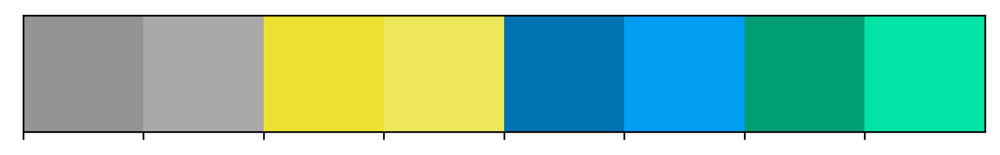

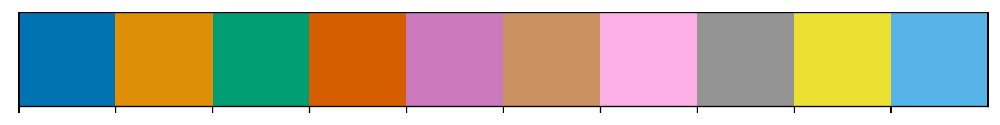

In [15]:
def lighten_color(color, amount=0.5):
    """
    Lightens the given color by multiplying (1-luminosity) by the given amount.
    Input can be matplotlib color string, hex string, or RGB tuple.

    Examples:
    >> lighten_color('g', 0.3)
    >> lighten_color('#F034A3', 0.6)
    >> lighten_color((.3,.55,.1), 0.5)
    """
    import matplotlib.colors as mc
    import colorsys
    try:
        c = mc.cnames[color]
    except:
        c = color
    c = colorsys.rgb_to_hls(*mc.to_rgb(c))
    return colorsys.hls_to_rgb(c[0], 1 - amount * (1 - c[1]), c[2])

light_factor = 0.8

p = sns.color_palette('colorblind')

palette = [lighten_color(p[i], j) for i, j in [(7, 1),(7, light_factor),(8,1),(8,light_factor),(0,1),(0,light_factor),(2,1),(2,light_factor)]]

sns.palplot(palette)
sns.palplot(p)


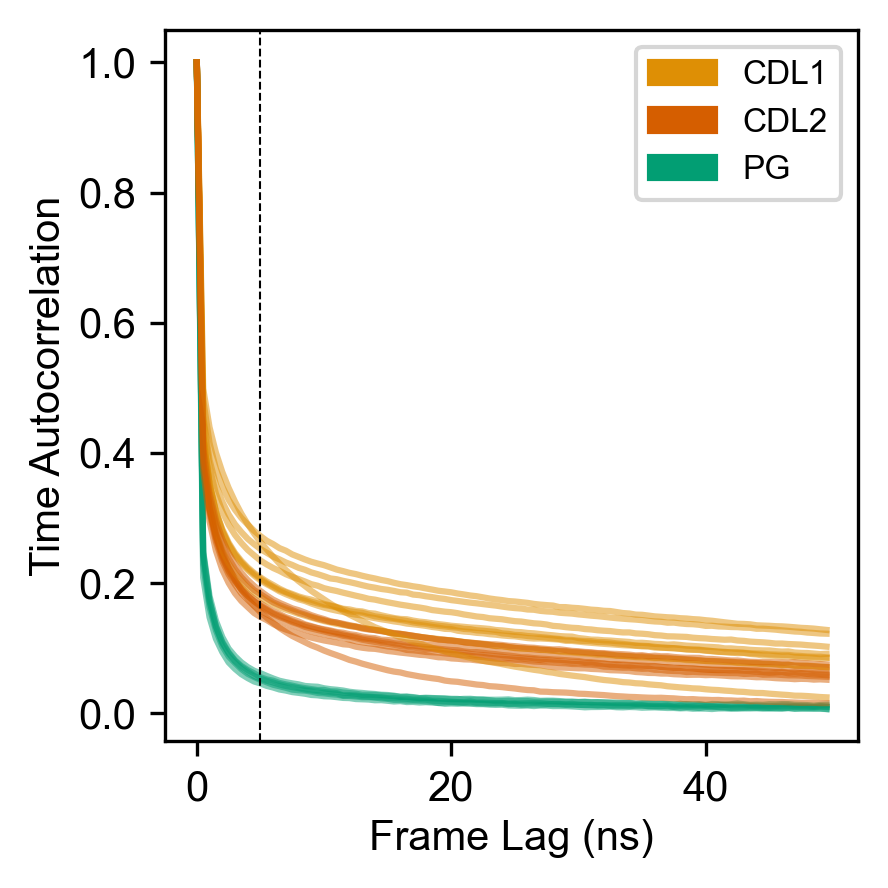

In [25]:
show_figs = True
curr_fig_path = Path("Figures/curvature_spatial_autocorrelation")
curr_fig_path.mkdir(parents=True, exist_ok=True)

color_index = [0, 1,1,1,3,3,3,2,2,2,1,1,3,3,2,2,1,1,3,3,1,3,]

# cmap = mpl.cm.get_cmap("viridis")
# c = cmap(np.linspace(0, 1, 22))

fig, ax = plt.subplots(1, 1, figsize=(3, 3))  # sharex=True,
for i in range(1,22):
    ax.plot(np.arange(0, 100)*500/1000, time_autocorrelations[i][0:100], color=p[color_index[i]], label=color_index[i], alpha=0.5)
    
ax.set_ylabel("Time Autocorrelation")
ax.set_xlabel("Frame Lag (ns)")

ax.axvline(5, color="k", linestyle="--", linewidth=0.5)

# Creating legend with color box 
patches = [mpatches.Patch(color=p[1], label='CDL1'), mpatches.Patch(color=p[3], label='CDL2'), mpatches.Patch(color=p[2], label='PG')
           ]
ax.legend(handles=patches, loc="upper right") 

fig.tight_layout()

fig.savefig(
    curr_fig_path / f"all_time.png",
    format="png",
)
fig.savefig(
    curr_fig_path / f"all_time.pdf",
    format="pdf",
)

if show_figs:
    plt.show()

fig.clear()
plt.close(fig)


In [30]:
# show_figs = True
# curr_fig_path = Path("Figures/curvature_spatial_autocorrelation")
# curr_fig_path.mkdir(parents=True, exist_ok=True)


# for sim in np.concatenate((util.simulations, ["1_vbt"])):
#     # for sim in ["1"]:
#     print(sim)
#     with open(
#         util.analysis_path / f"{sim}/membrane_curvature_2nm.pickle", "rb"
#     ) as handle:
#         mc = pickle.load(handle)

#     h = mc.results["height"][1:]
#     mean_curvatures = np.zeros_like(h)
#     for i in range(h.shape[0]):
#         mean_curvatures[i] = mean_curvature(h[i])

#     acr = fftAutocorrelation(mean_curvatures)
#     print(acr.shape)
#     acr = np.mean(acr, axis=(1, 2))  # get mean over axis 1 and 2

#     fig, ax = plt.subplots(1, 1, figsize=(3, 3))  # sharex=True,

#     ax.plot(np.arange(0, 100), acr[0:100])

#     ax.set_ylabel("Time Autocorrelation")
#     ax.set_xlabel("Frame Lag")

#     fig.tight_layout()

#     if sim == "1_vbt":
#         fig.savefig(curr_fig_path / f"1_vbt_curvature_localization_time.png", format="png")
#         fig.savefig(curr_fig_path / f"1_vbt_curvature_localization_time.pdf", format="pdf")
#     else:
#         fig.savefig(
#             curr_fig_path
#             / f"{util.sim_to_final_index[int(sim)]}_curvature_localization_time.png",
#             format="png",
#         )
#         fig.savefig(
#             curr_fig_path
#             / f"{util.sim_to_final_index[int(sim)]}_curvature_localization_time.pdf",
#             format="pdf",
#         )

#     if show_figs:
#         plt.show()

#     fig.clear()
#     plt.close(fig)

#     ## COMPUTE 2D SPATIAL CORRELATION
#     acr = []
#     for i in tqdm(range(1, 100)):
#         acr.append(
#             signal.correlate2d(
#                 mean_curvatures[-i],
#                 mean_curvatures[-i],
#                 boundary="wrap",
#             )
#             / mean_curvatures.shape[1] ** 2
#             / np.std(mean_curvatures[-i]) ** 2
#         )

#     acr = np.mean(np.array(acr), axis=0)

#     fig, ax = plt.subplots(1, 1, figsize=(3, 3))  # sharex=True,

#     im = ax.imshow(acr, vmin=-1, vmax=1)

#     fig.colorbar(im, ax=ax)
#     ax.set_ylabel("Y (nm)")
#     ax.set_xlabel("X (nm)")

#     limits = (len(acr) / 2 - 5, len(acr) / 2 + 4)
#     # ax.set_xlim(*limits)
#     # ax.set_ylim(*limits)

#     fig.tight_layout()

#     if sim == "1_vbt":
#         fig.savefig(curr_fig_path / f"1_vbt_curvature_localization_space.png", format="png")
#         fig.savefig(curr_fig_path / f"1_vbt_curvature_localization_space.pdf", format="pdf")
#     else:
#         fig.savefig(
#             curr_fig_path
#             / f"{util.sim_to_final_index[int(sim)]}_curvature_localization_space.png",
#             format="png",
#         )
#         fig.savefig(
#             curr_fig_path
#             / f"{util.sim_to_final_index[int(sim)]}_curvature_localization_space.pdf",
#             format="pdf",
#         )

#     if show_figs:
#         plt.show()

#     fig.clear()
#     plt.close(fig)


sim 1


/home/ctlee/.conda/envs/mda/lib/python3.10/site-packages/MDAnalysis/topology/guessers.py:146: UserWarning: Failed to guess the mass for the following atom types: G
  warnings.warn("Failed to guess the mass for the following atom types: {}".format(atom_type))


analyzing lipid PC


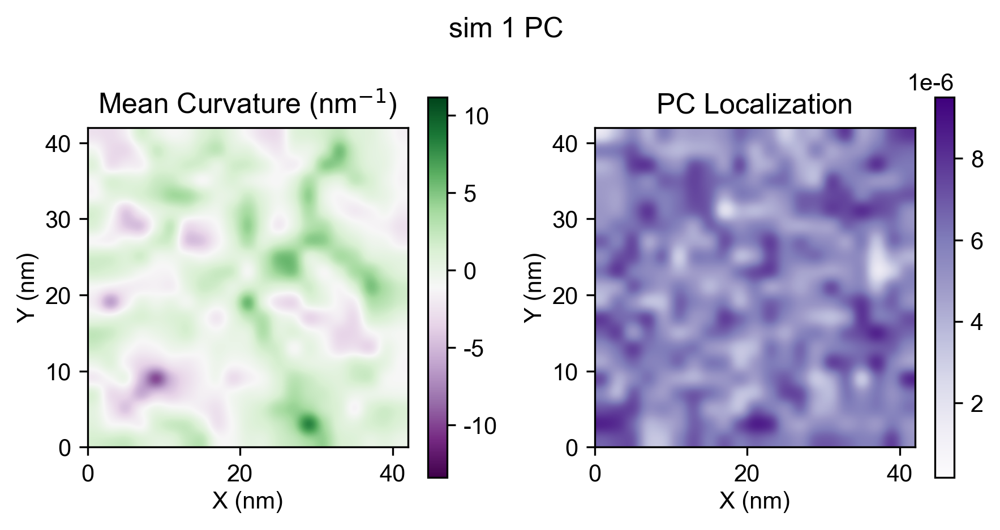

analyzing lipid PE


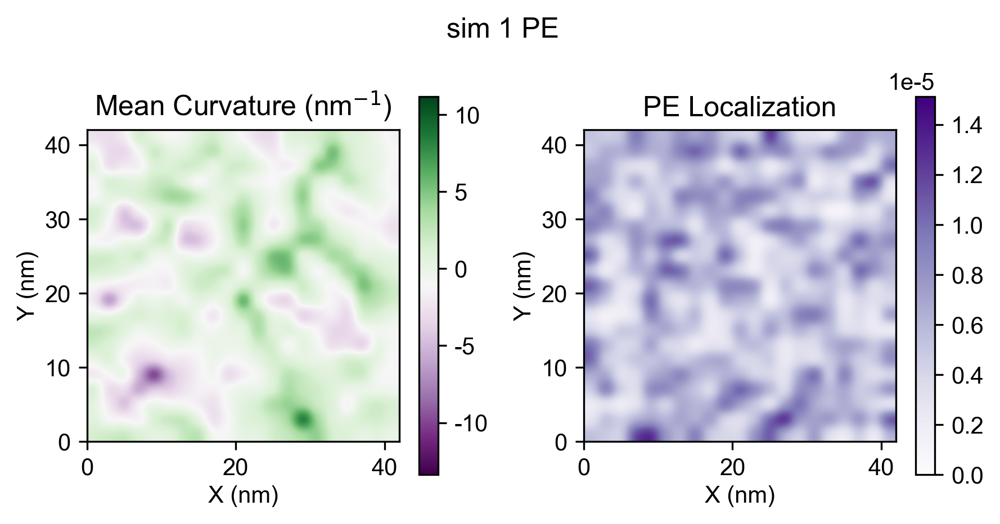

analyzing lipid CDL


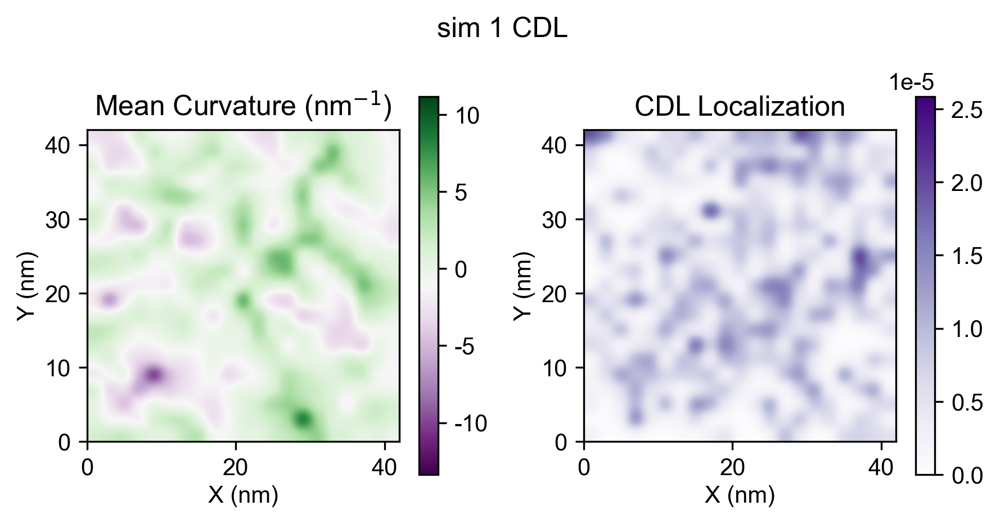

analyzing lipid PG
sim 2


analyzing lipid PC


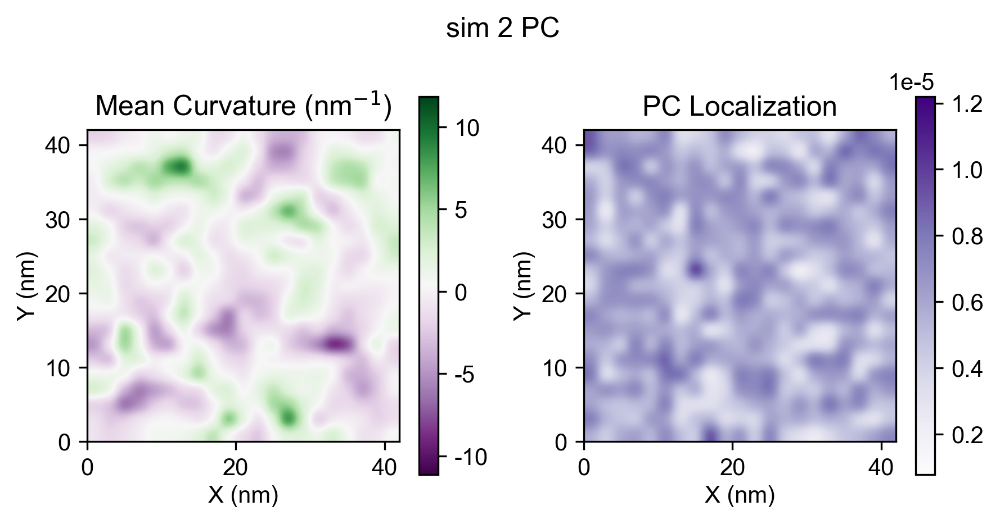

analyzing lipid PE


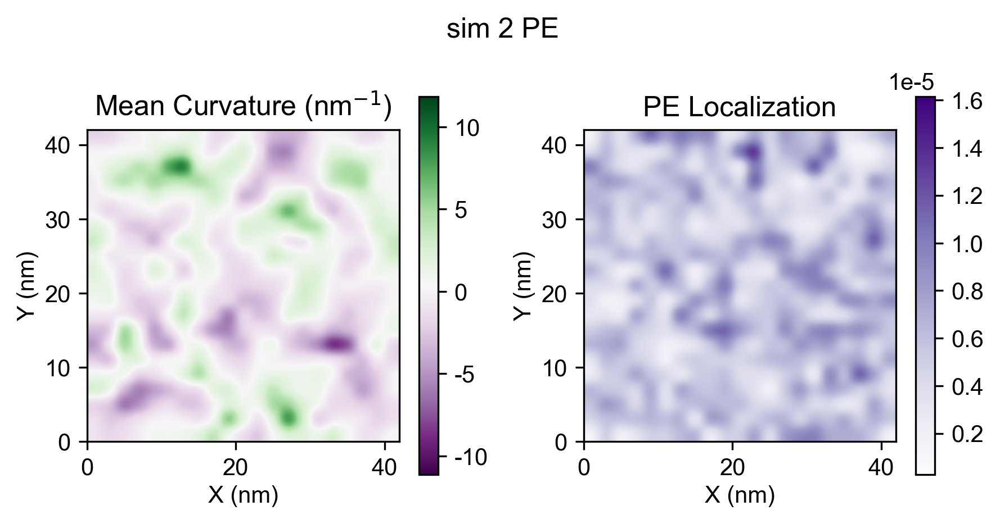

analyzing lipid CDL


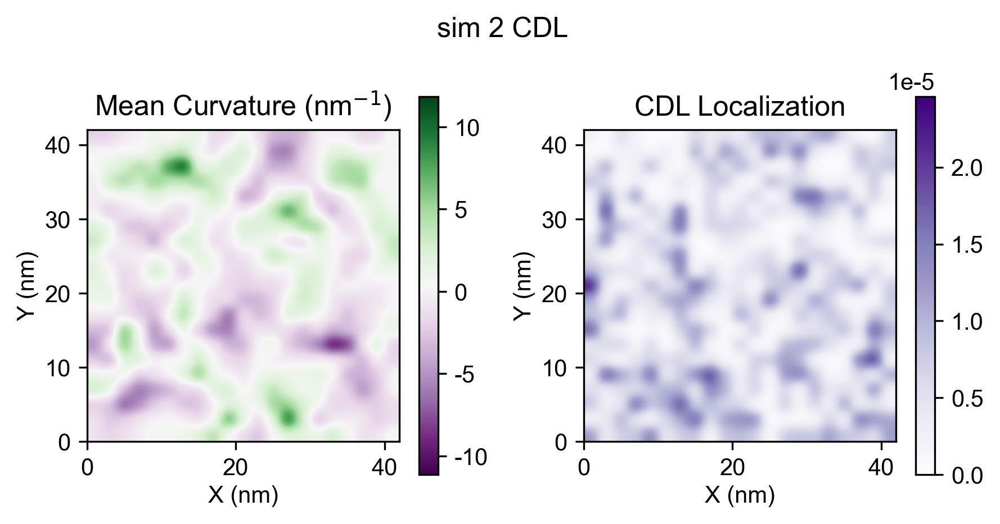

analyzing lipid PG
sim 3
analyzing lipid PC


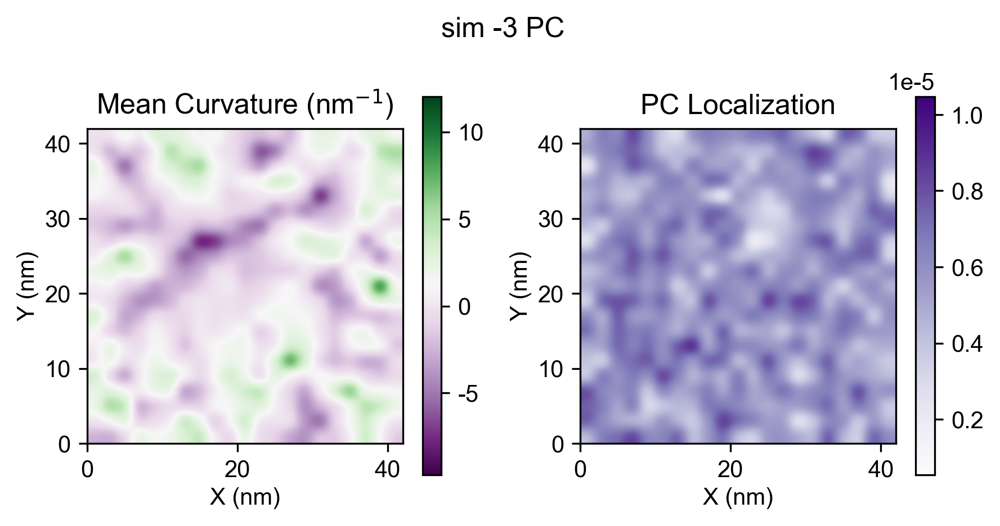

analyzing lipid PE


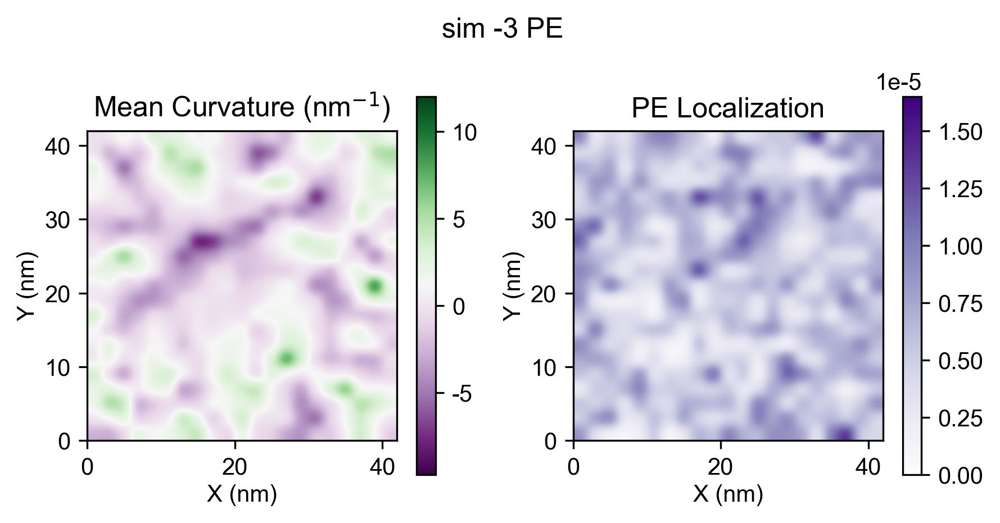

analyzing lipid CDL


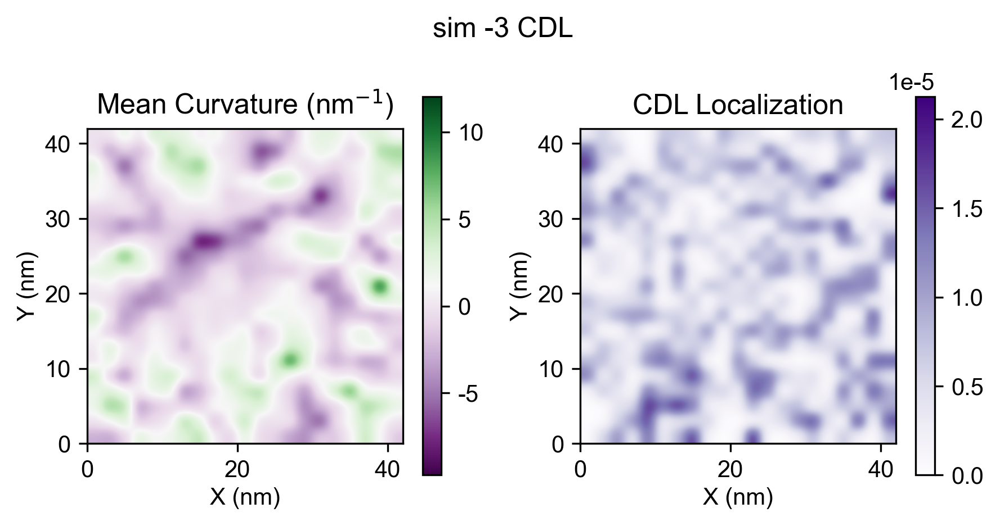

analyzing lipid PG
sim 4
analyzing lipid PC


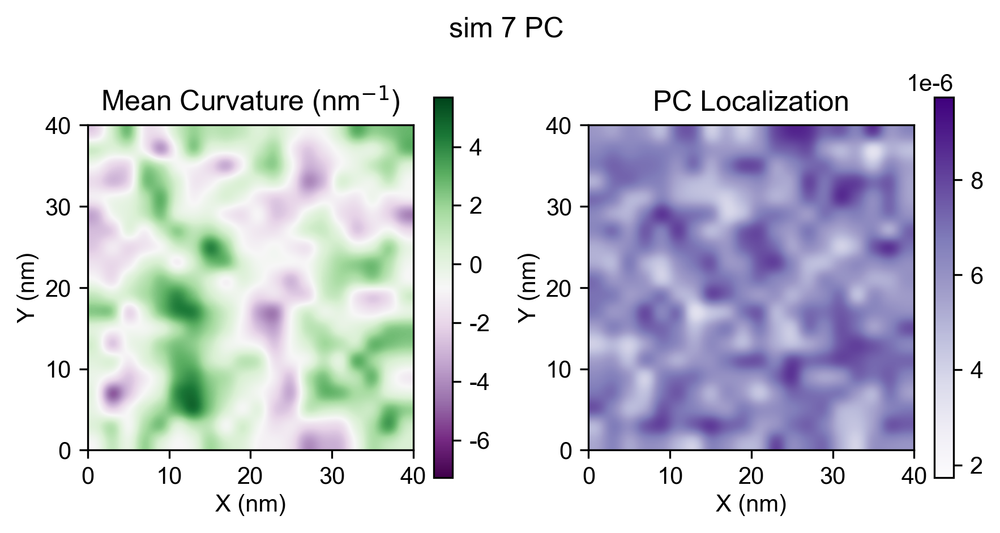

analyzing lipid PE


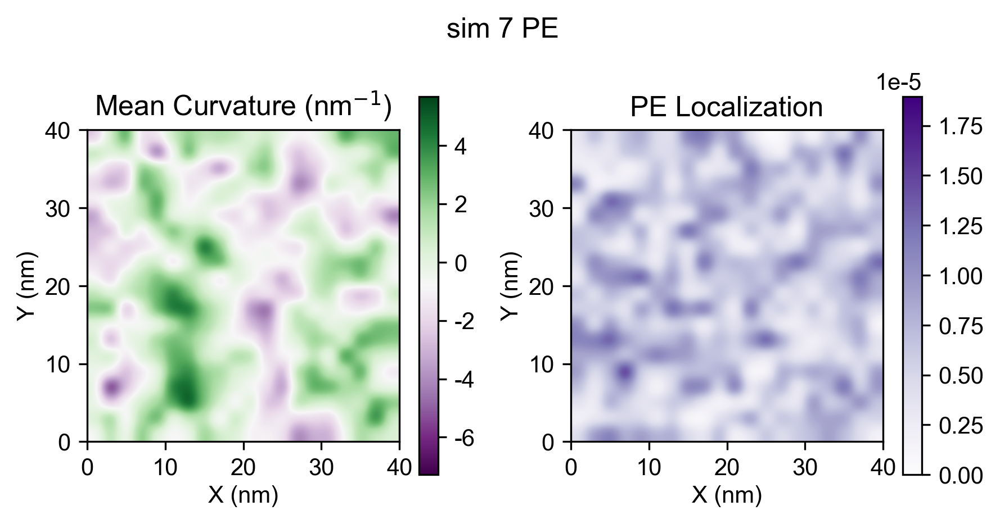

analyzing lipid CDL
analyzing lipid PG


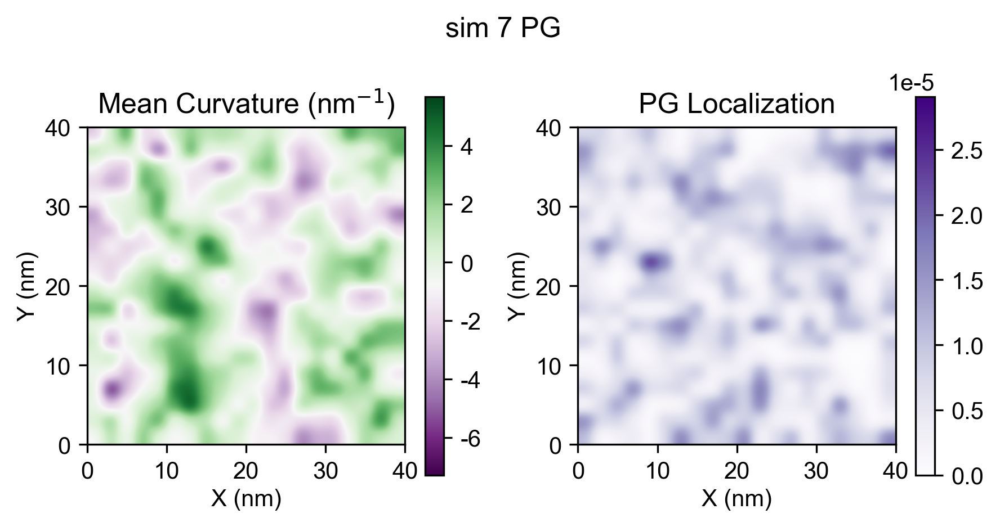

sim 5
analyzing lipid PC


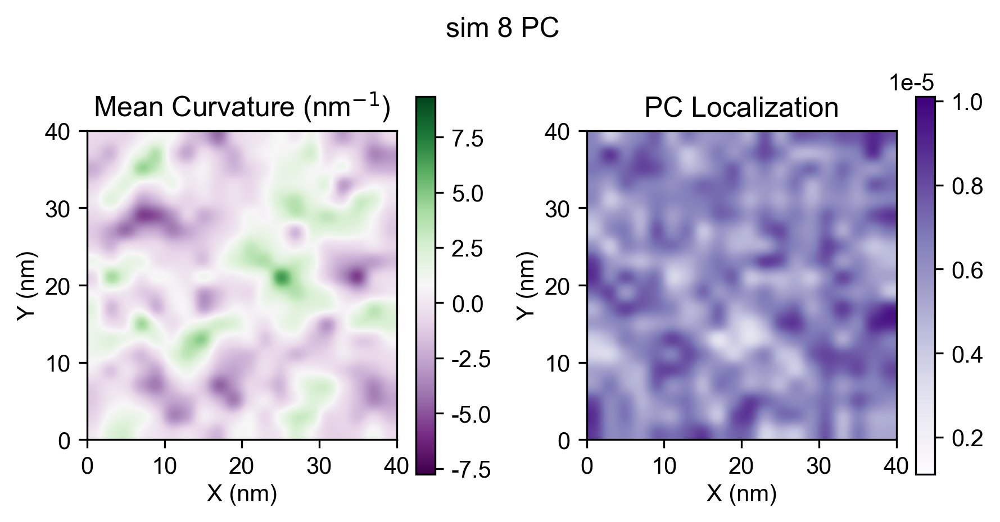

analyzing lipid PE


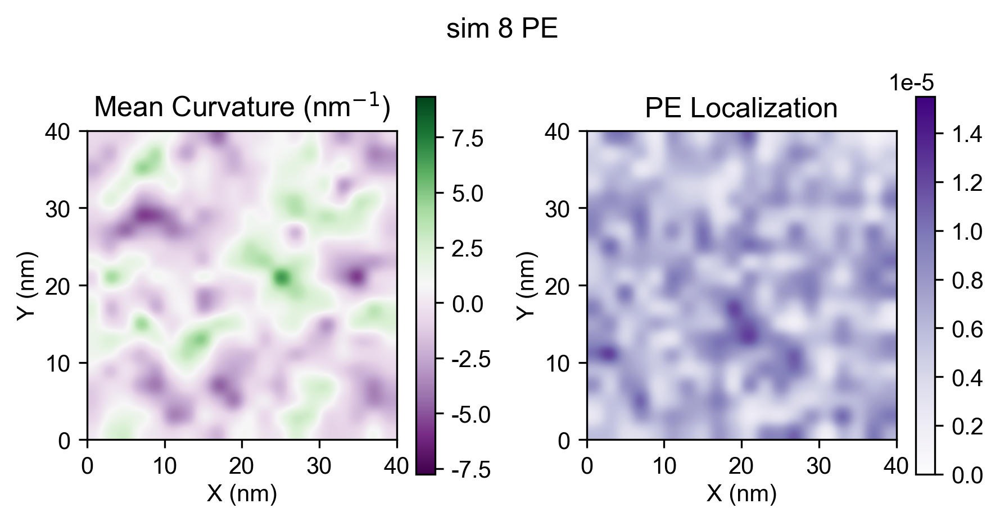

analyzing lipid CDL
analyzing lipid PG


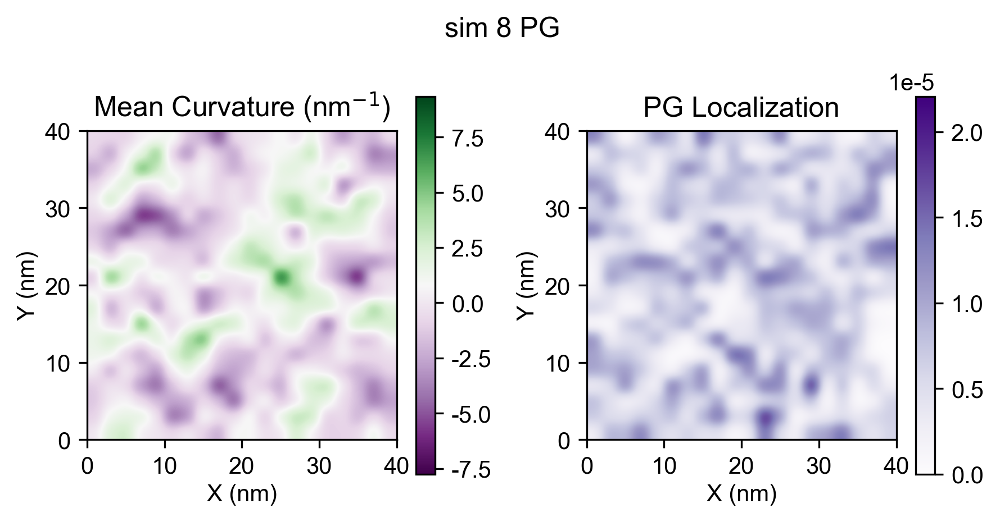

sim 6
analyzing lipid PC


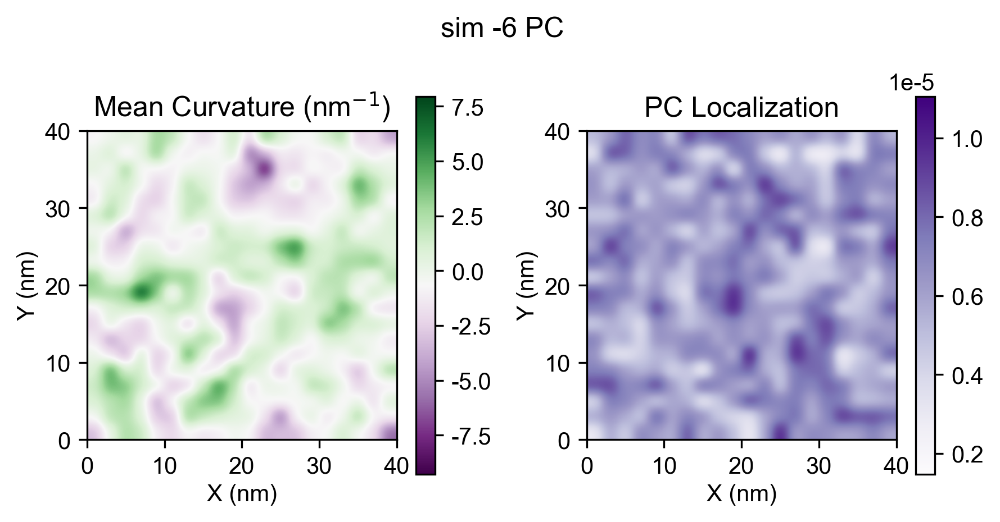

analyzing lipid PE


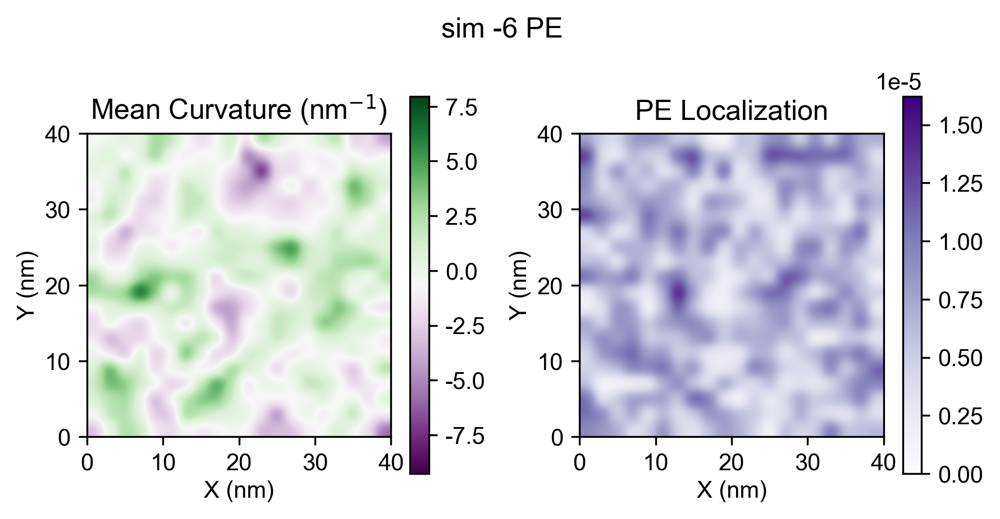

analyzing lipid CDL
analyzing lipid PG


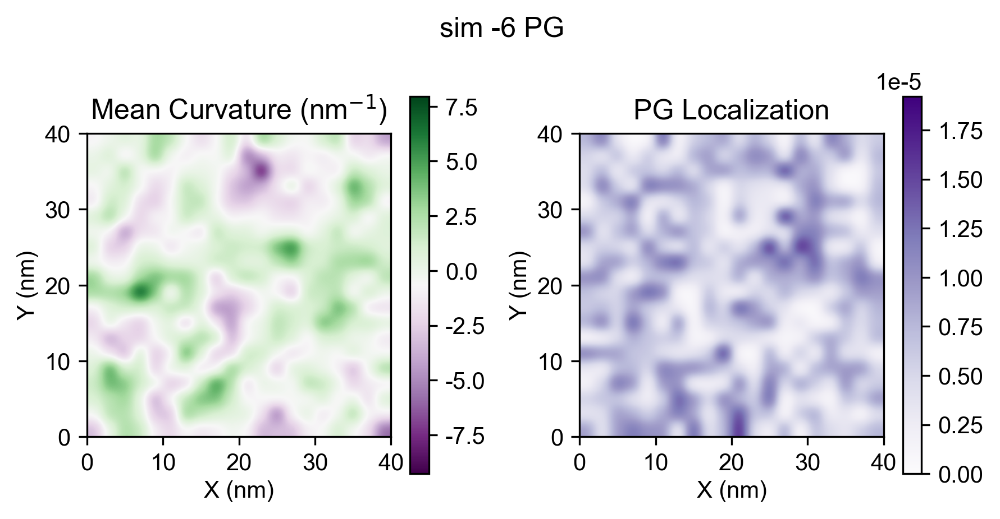

sim 7
analyzing lipid PC
analyzing lipid PE
analyzing lipid CDL


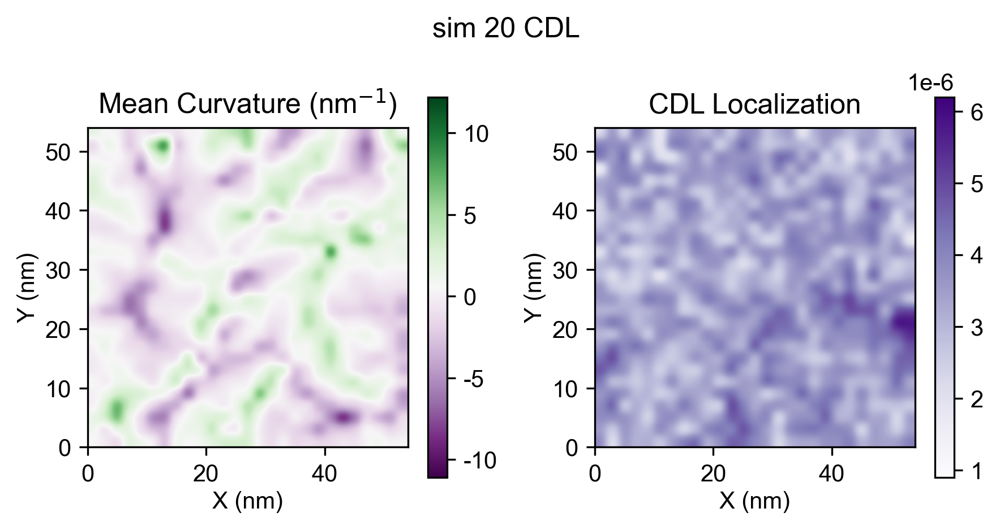

analyzing lipid PG
sim 8
analyzing lipid PC


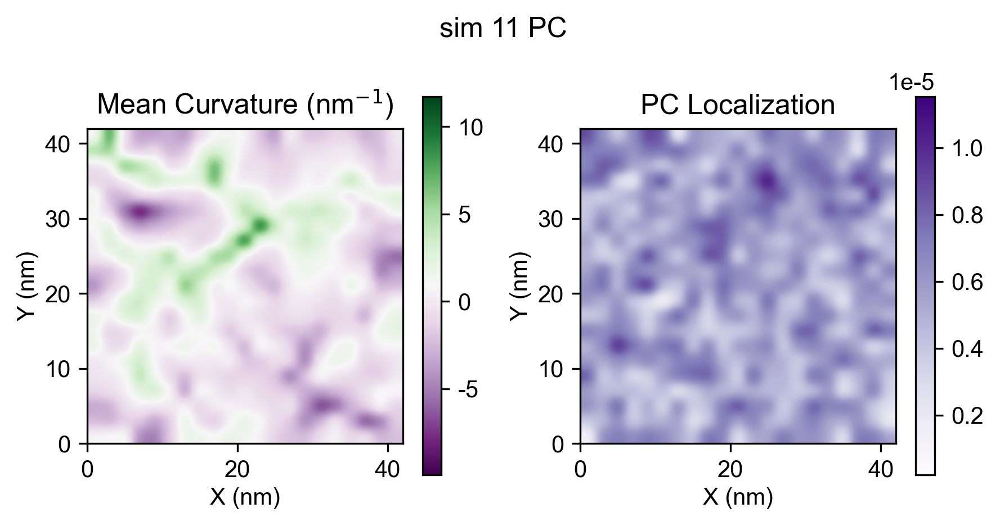

analyzing lipid PE


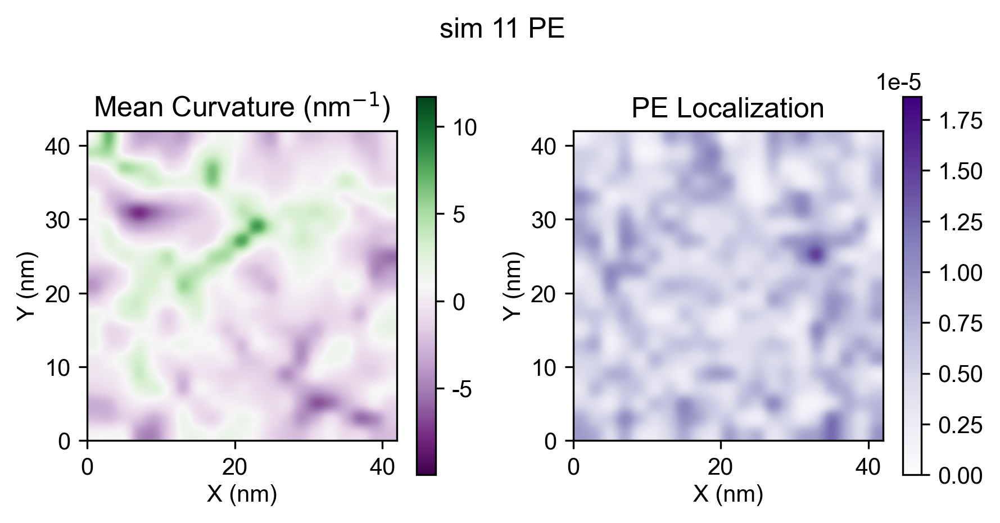

analyzing lipid CDL


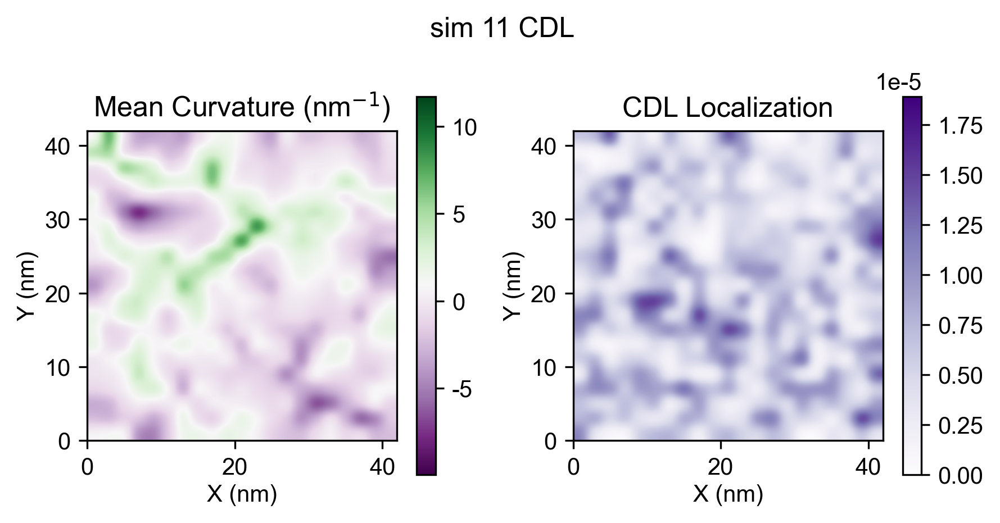

analyzing lipid PG
sim 9
analyzing lipid PC


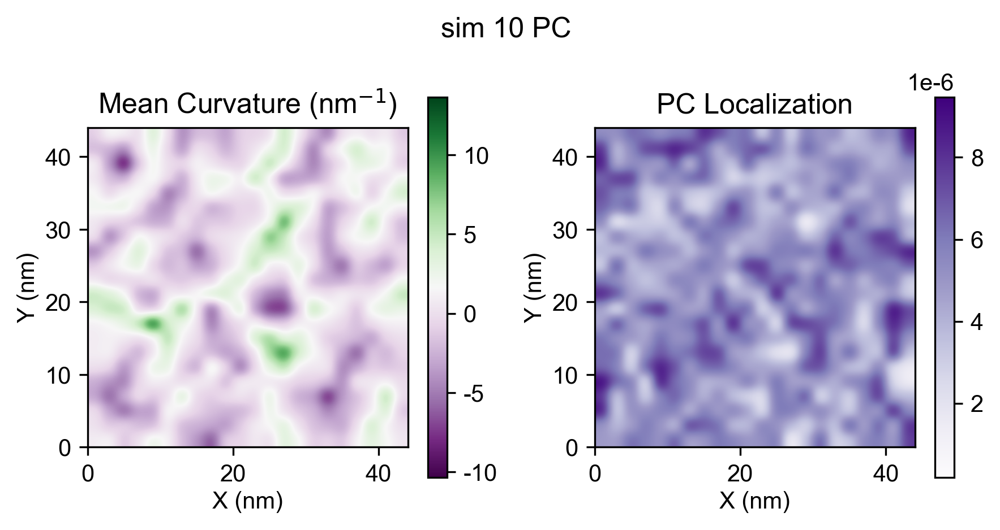

analyzing lipid PE


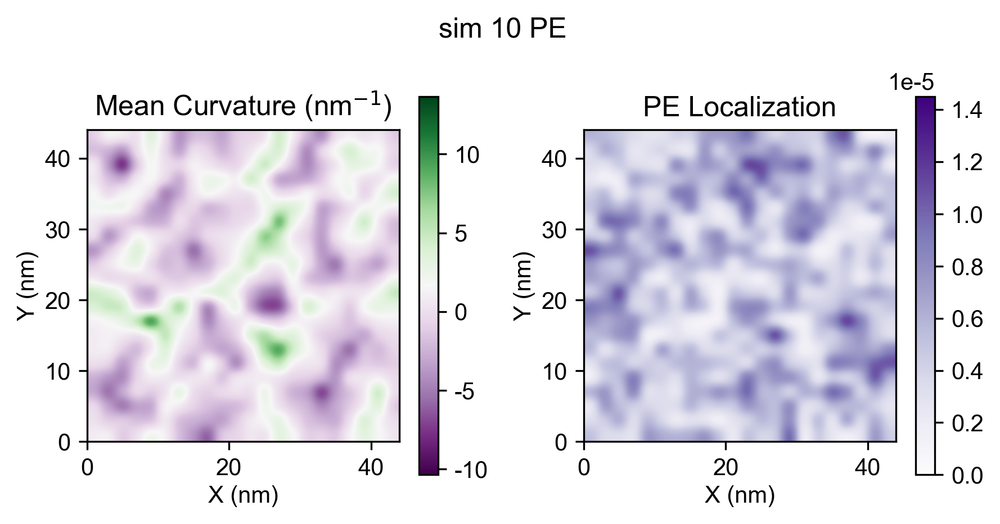

analyzing lipid CDL


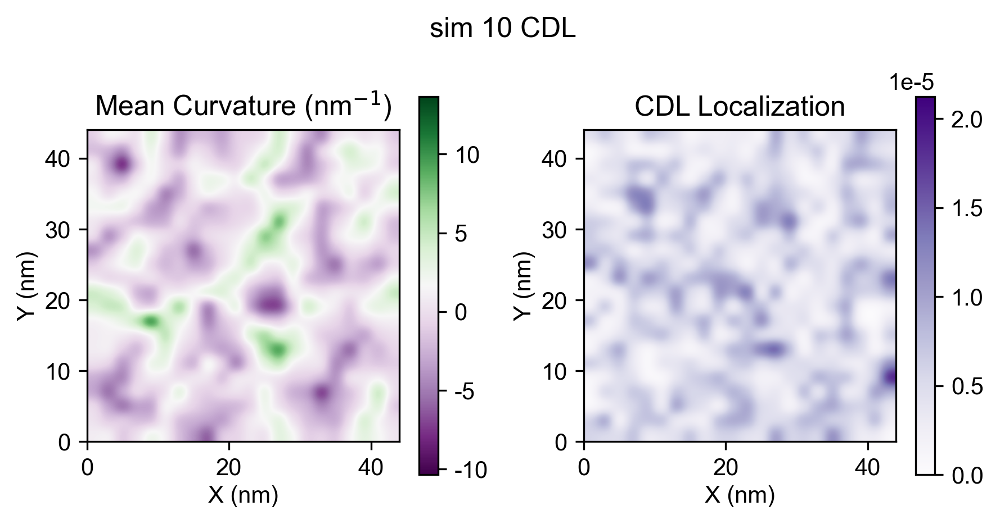

analyzing lipid PG
sim 10
analyzing lipid PC


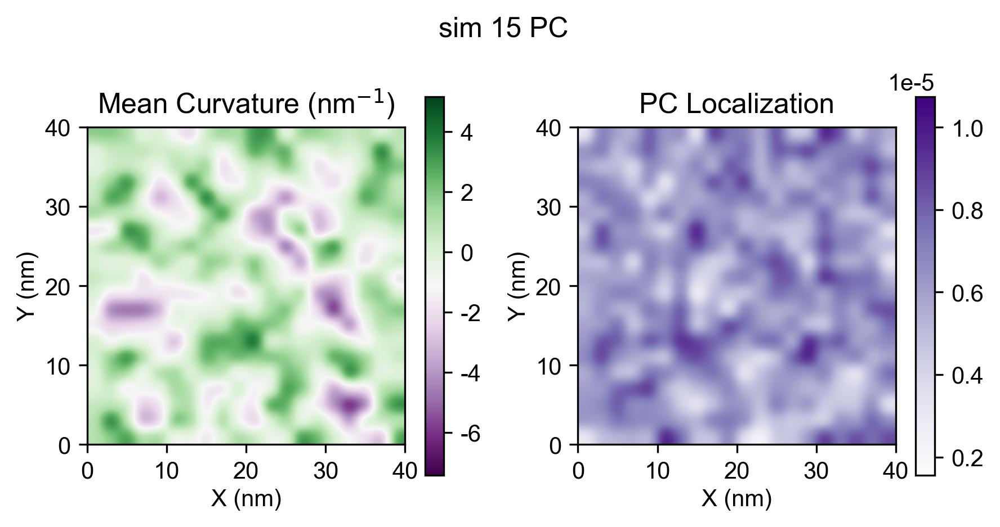

analyzing lipid PE


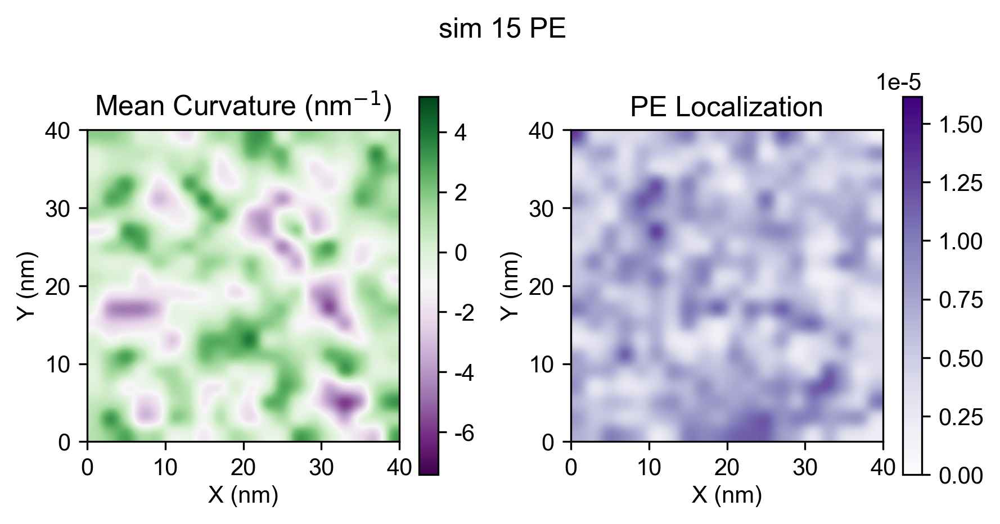

analyzing lipid CDL
analyzing lipid PG


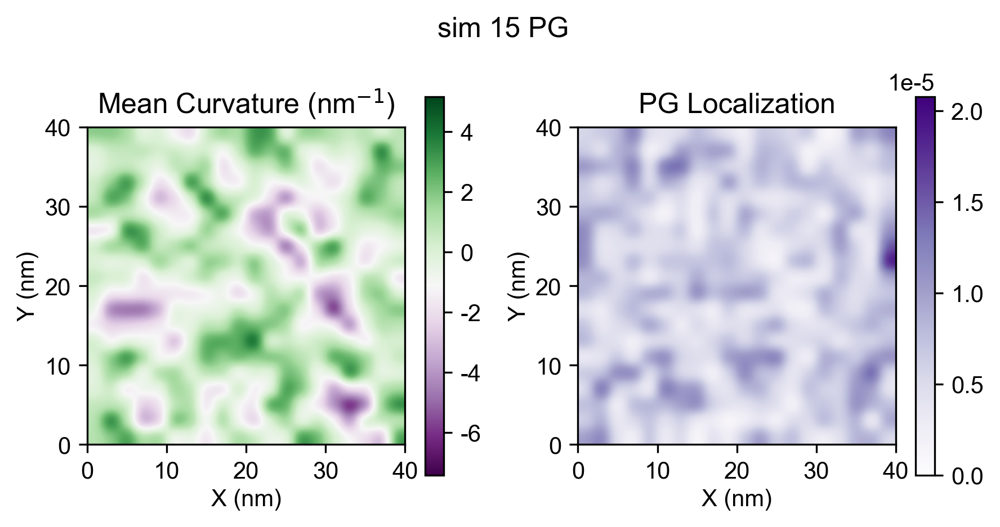

sim 11
analyzing lipid PC


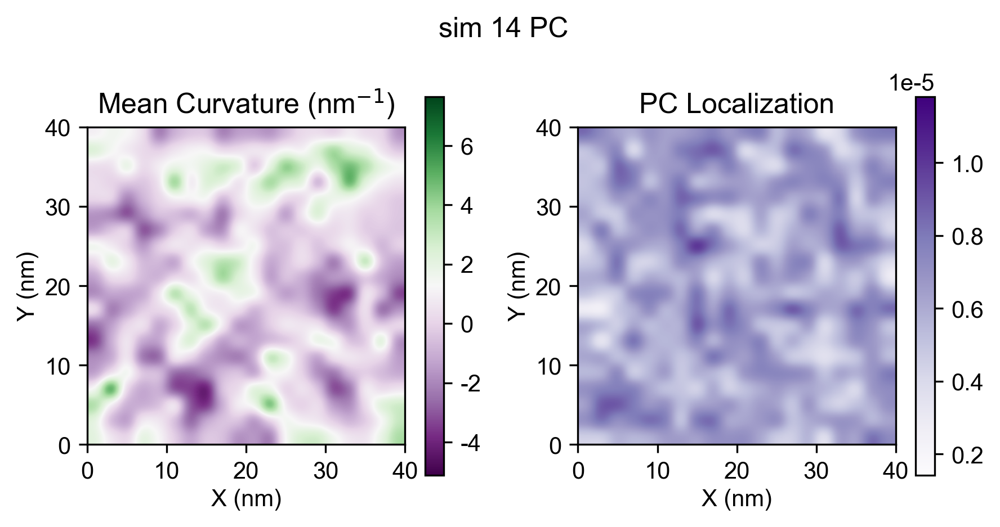

analyzing lipid PE


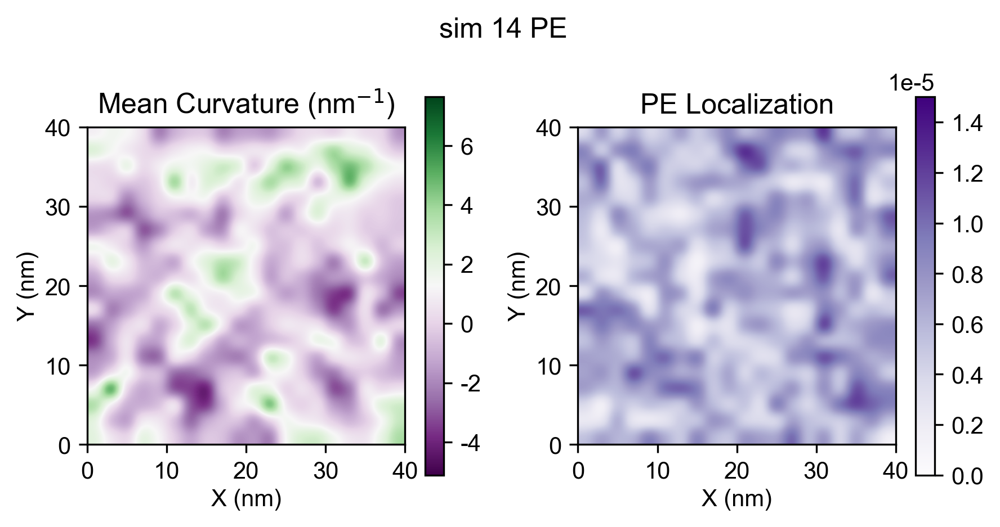

analyzing lipid CDL
analyzing lipid PG


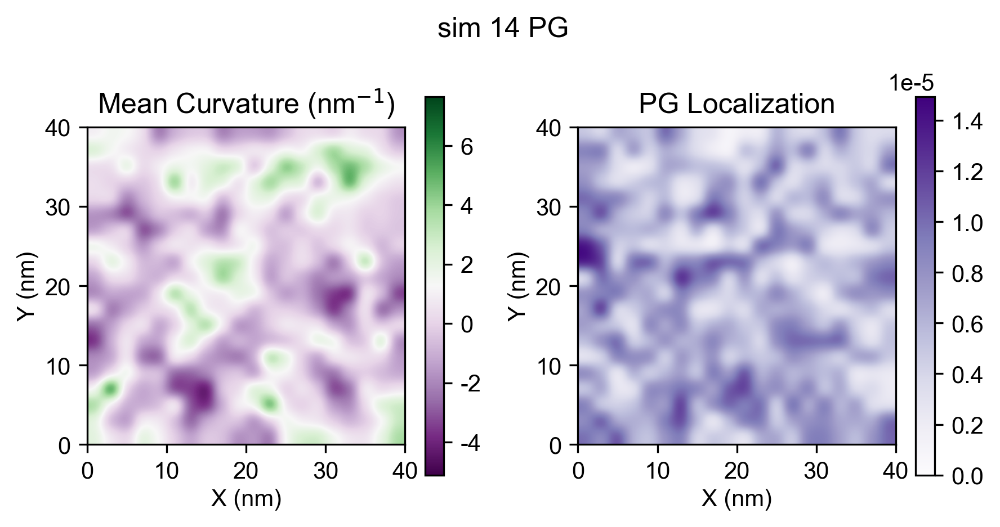

sim 12
analyzing lipid PC


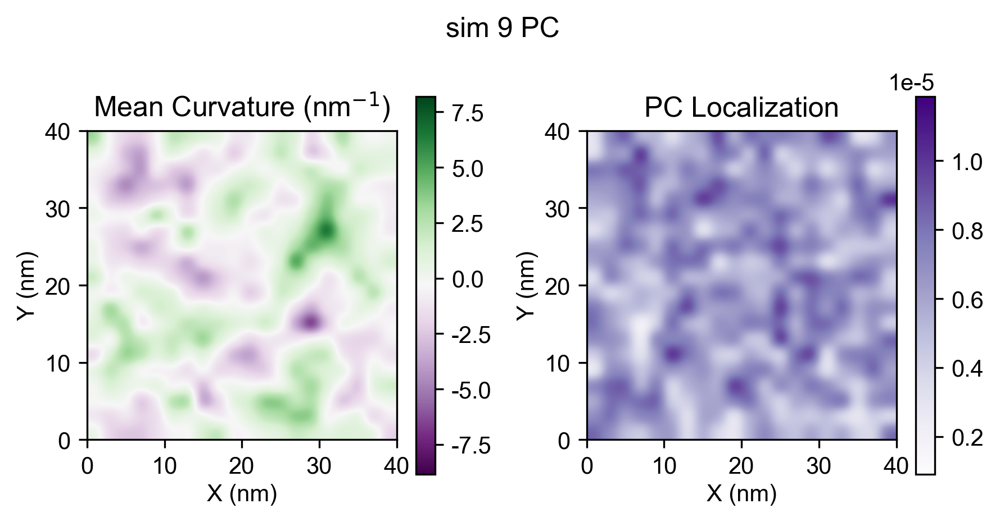

analyzing lipid PE


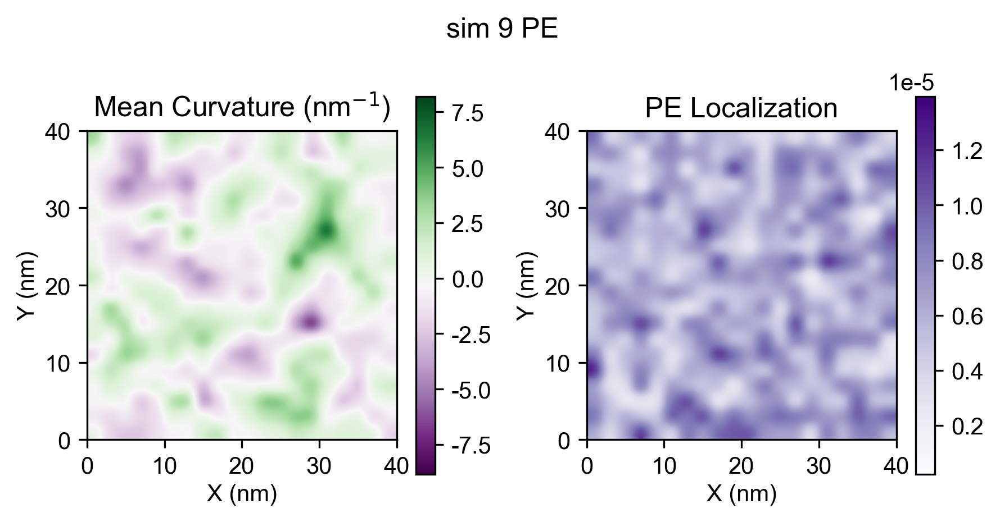

analyzing lipid CDL
analyzing lipid PG


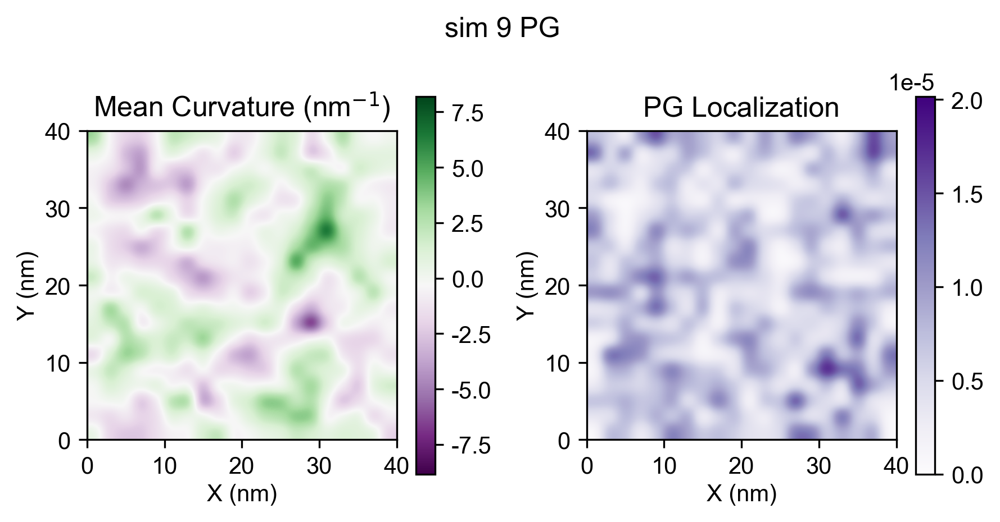

sim 13
analyzing lipid PC


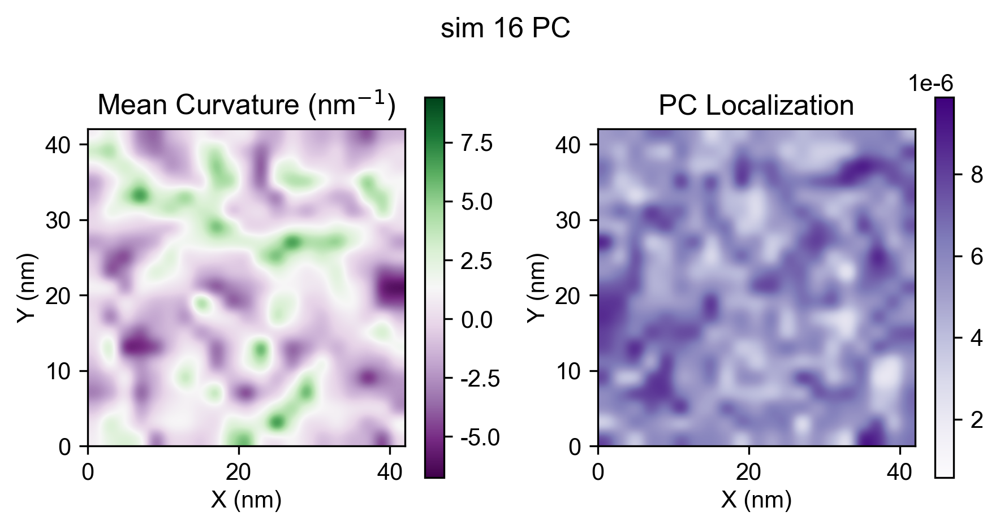

analyzing lipid PE


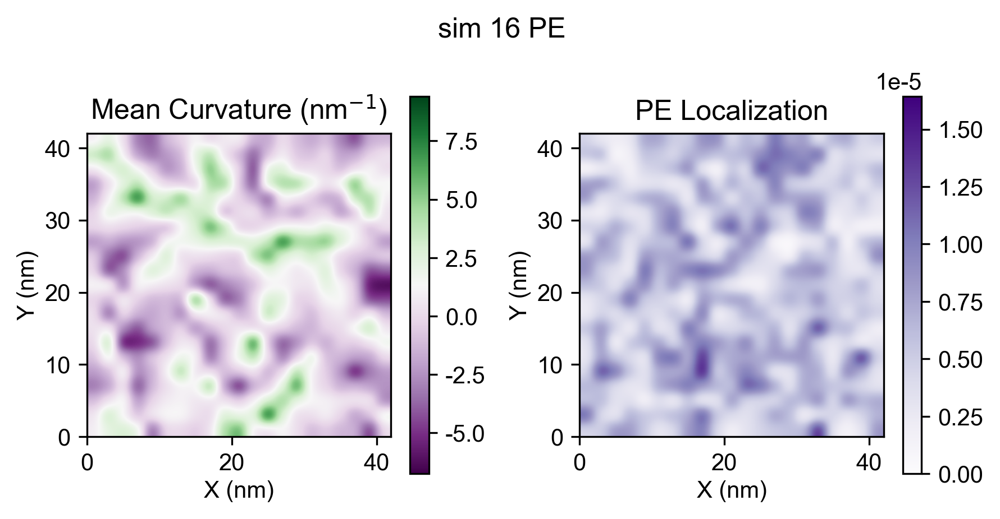

analyzing lipid CDL


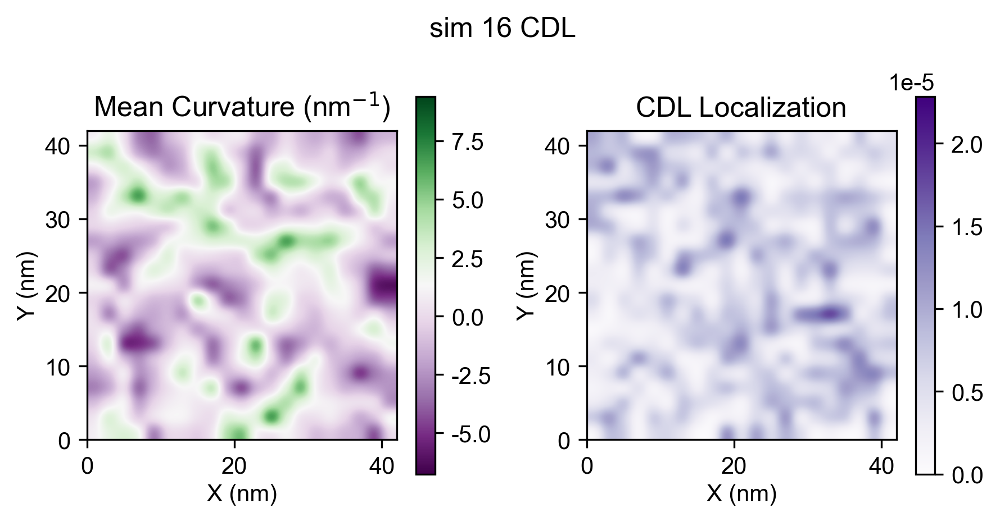

analyzing lipid PG
sim 14
analyzing lipid PC


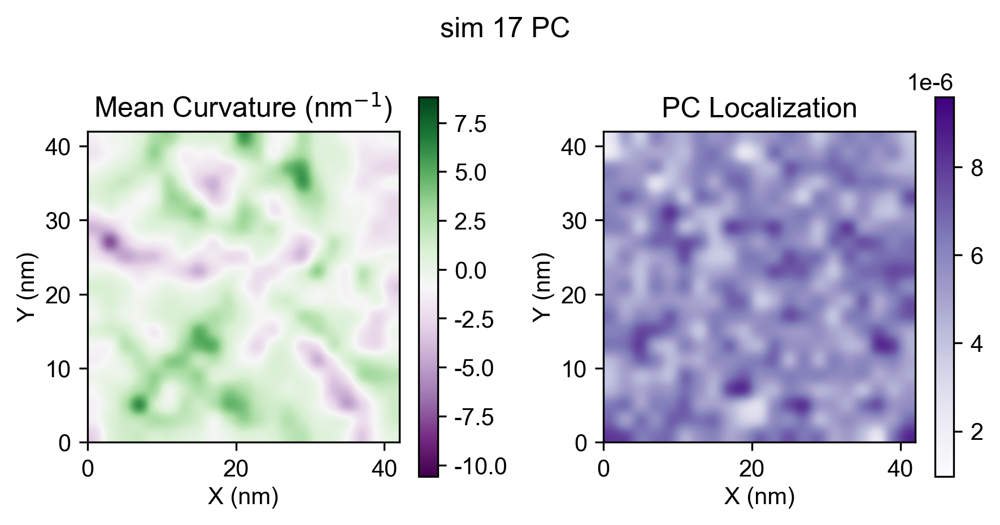

analyzing lipid PE


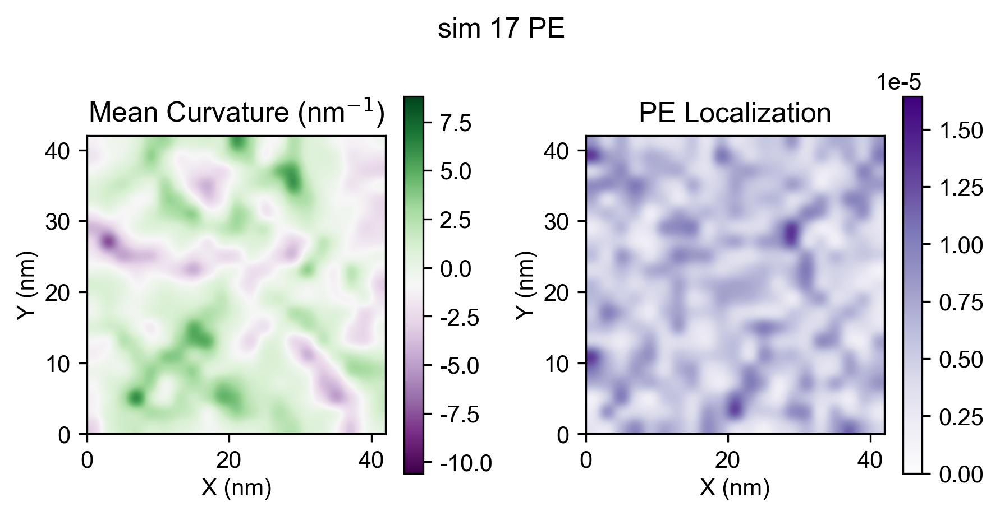

analyzing lipid CDL


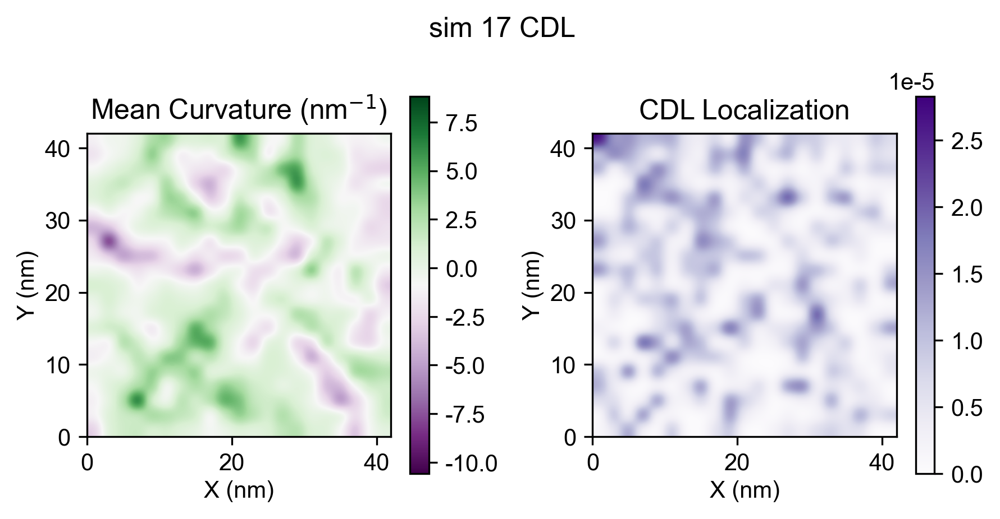

analyzing lipid PG
sim 15
analyzing lipid PC


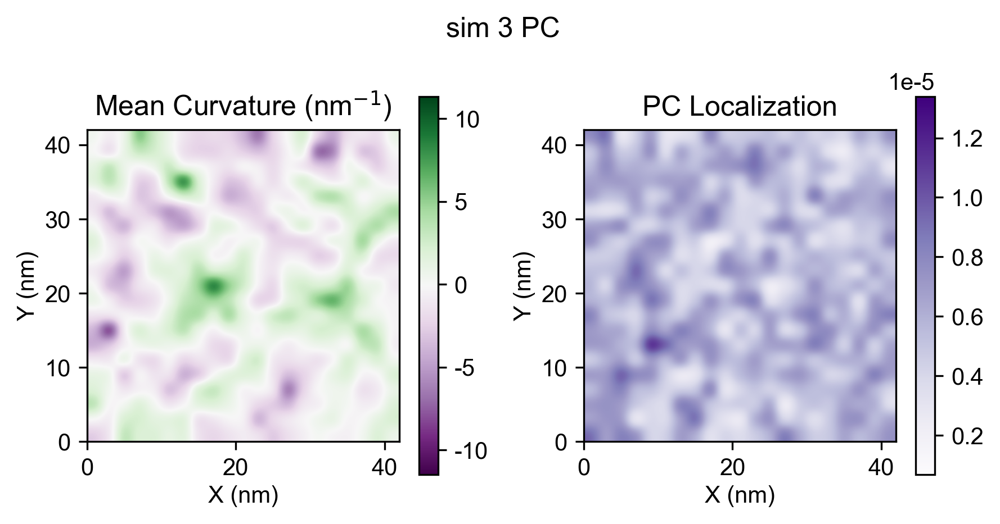

analyzing lipid PE


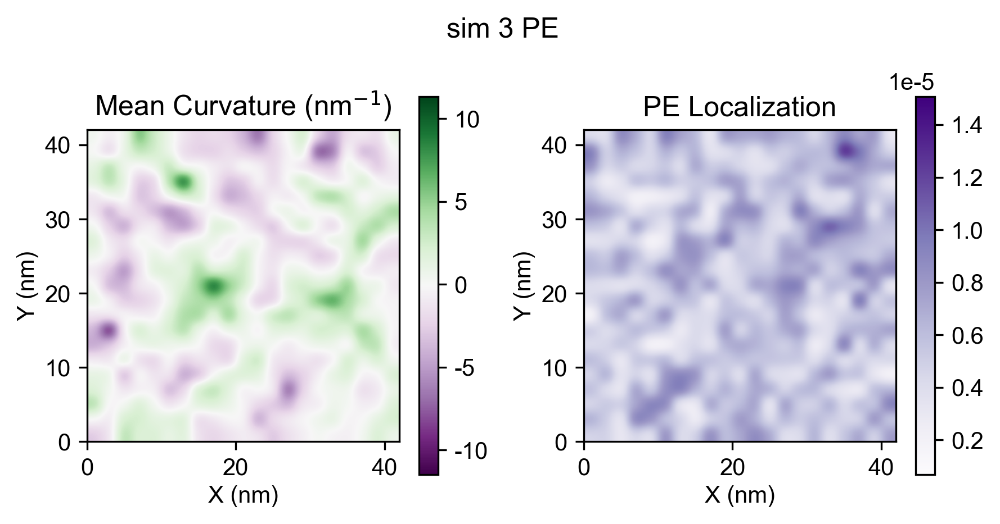

analyzing lipid CDL


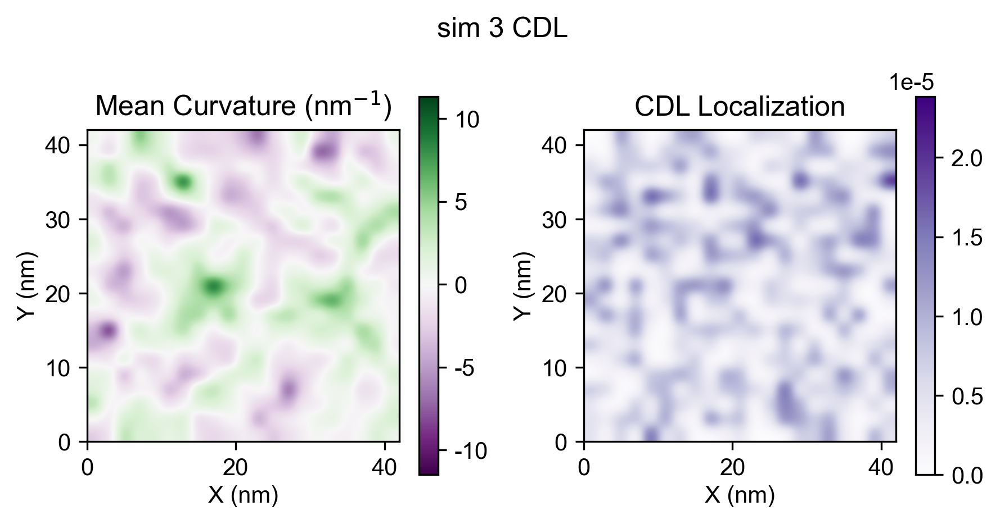

analyzing lipid PG
sim 16
analyzing lipid PC


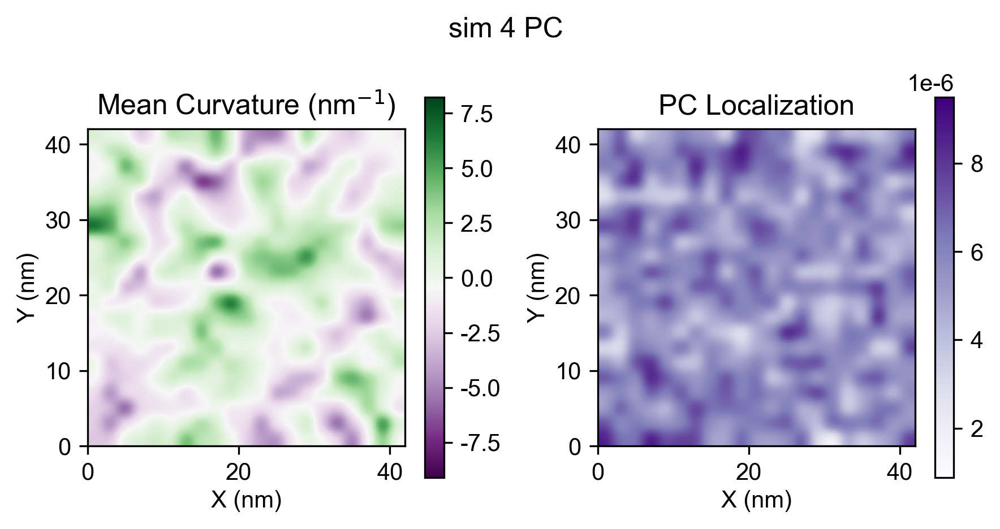

analyzing lipid PE


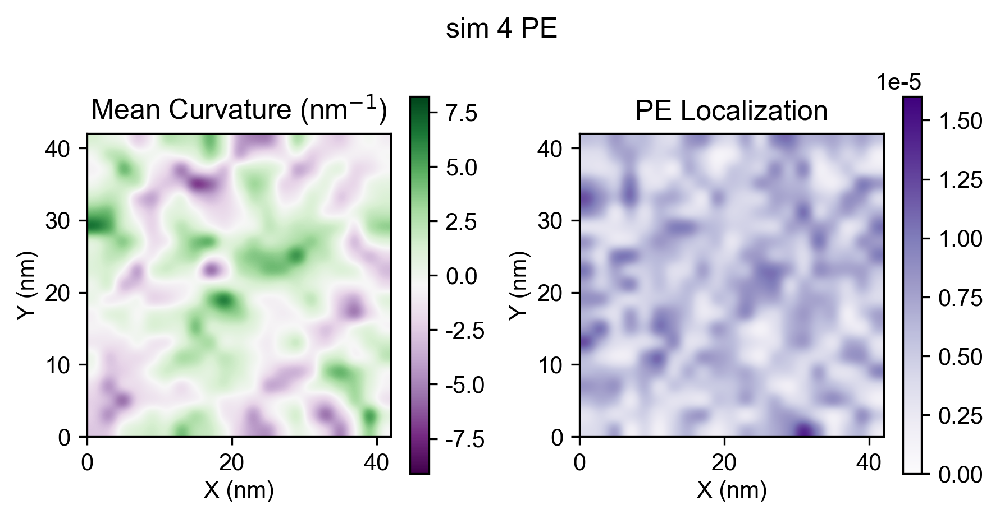

analyzing lipid CDL


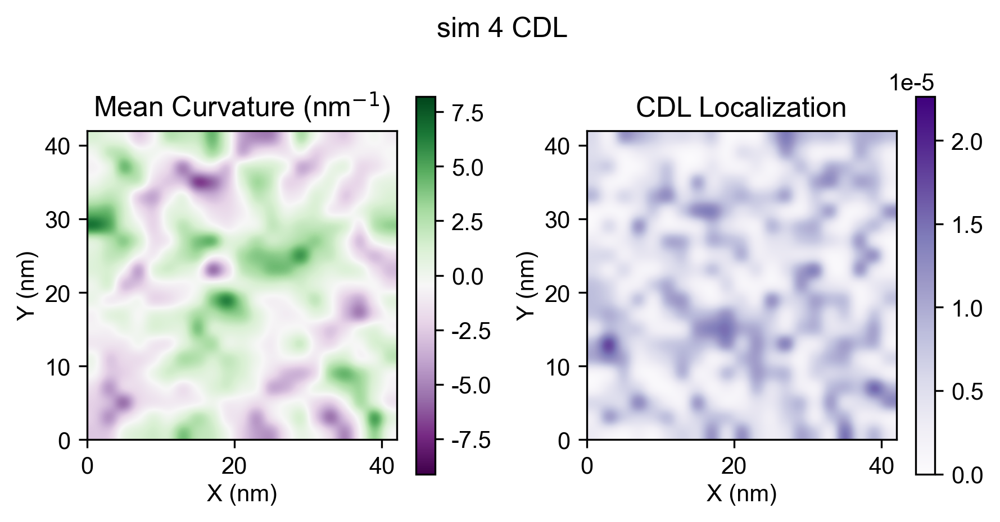

analyzing lipid PG
sim 17
analyzing lipid PC


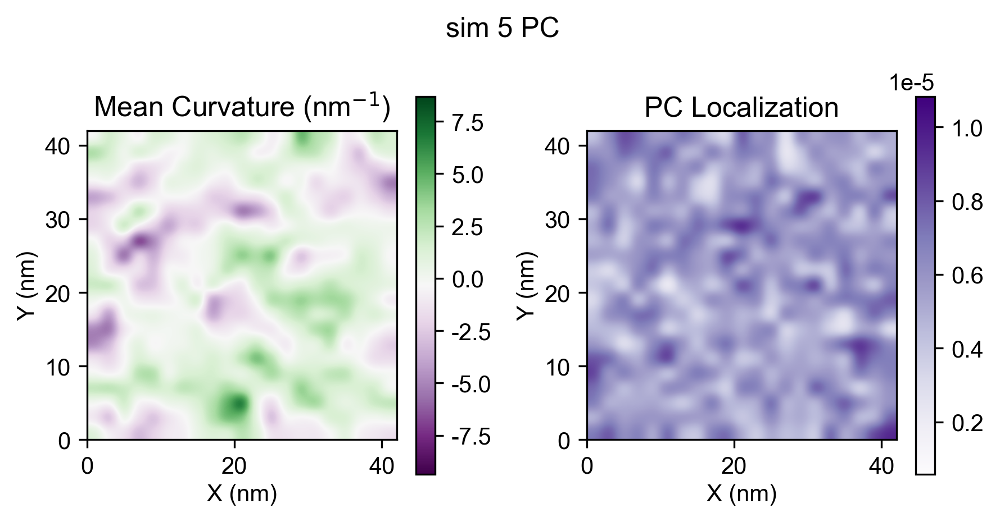

analyzing lipid PE


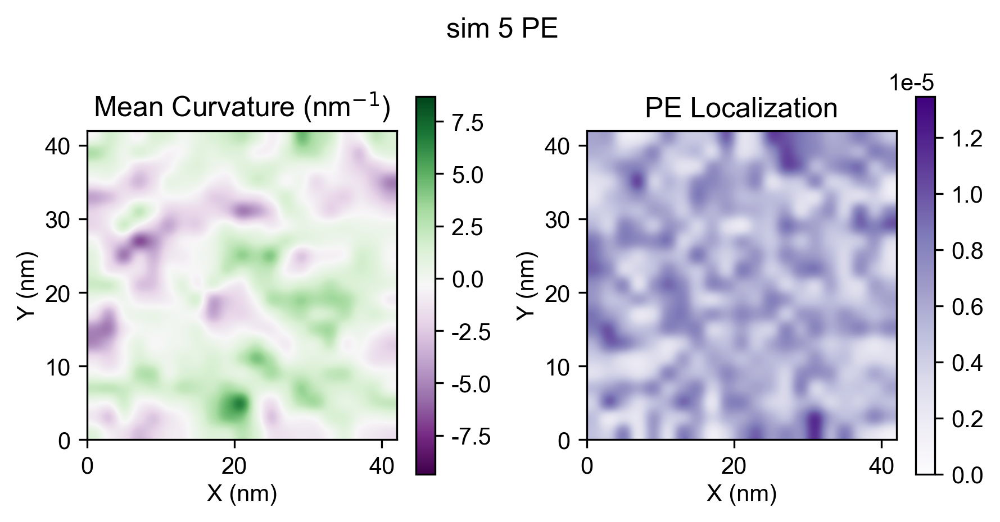

analyzing lipid CDL


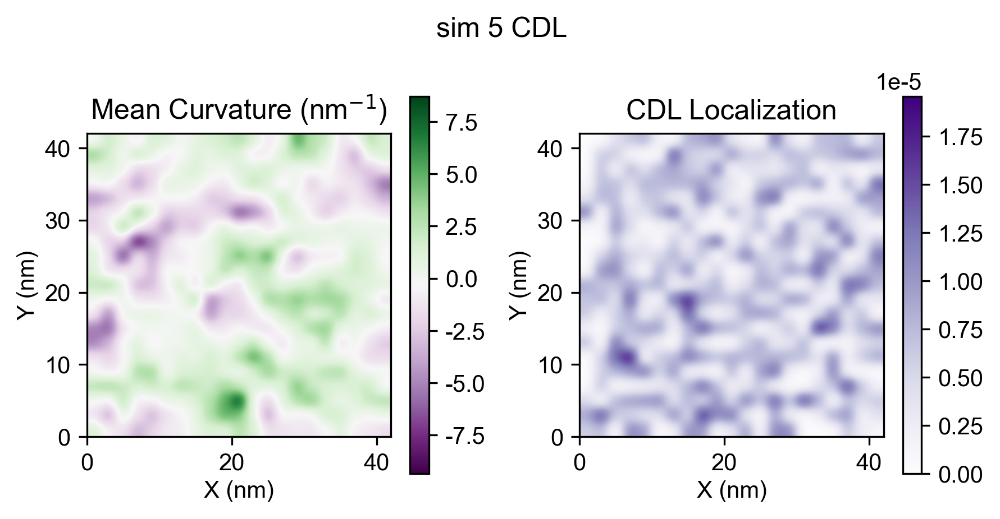

analyzing lipid PG
sim 18
analyzing lipid PC


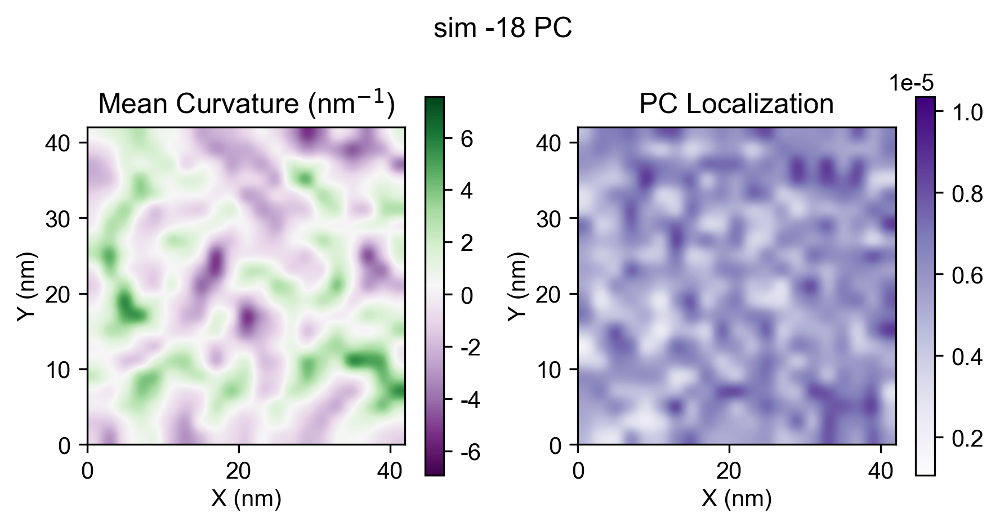

analyzing lipid PE


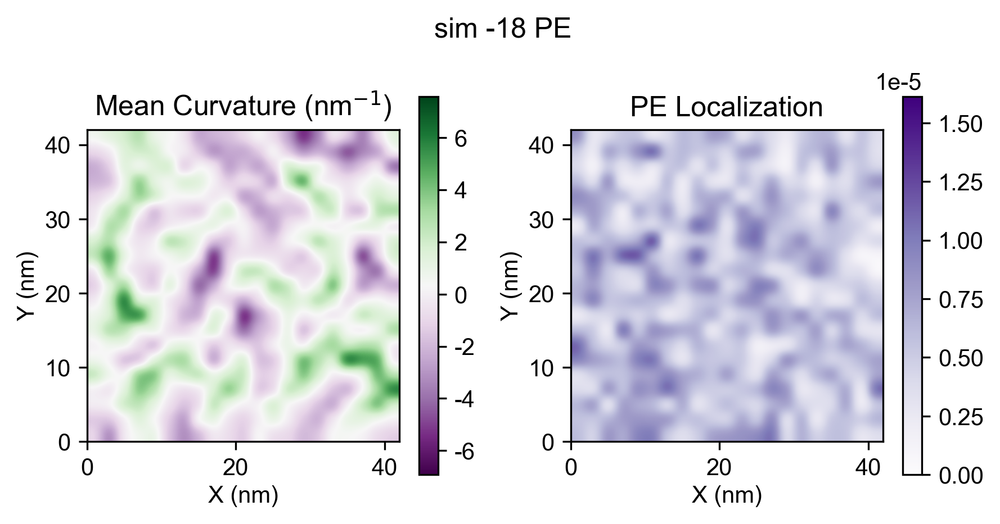

analyzing lipid CDL


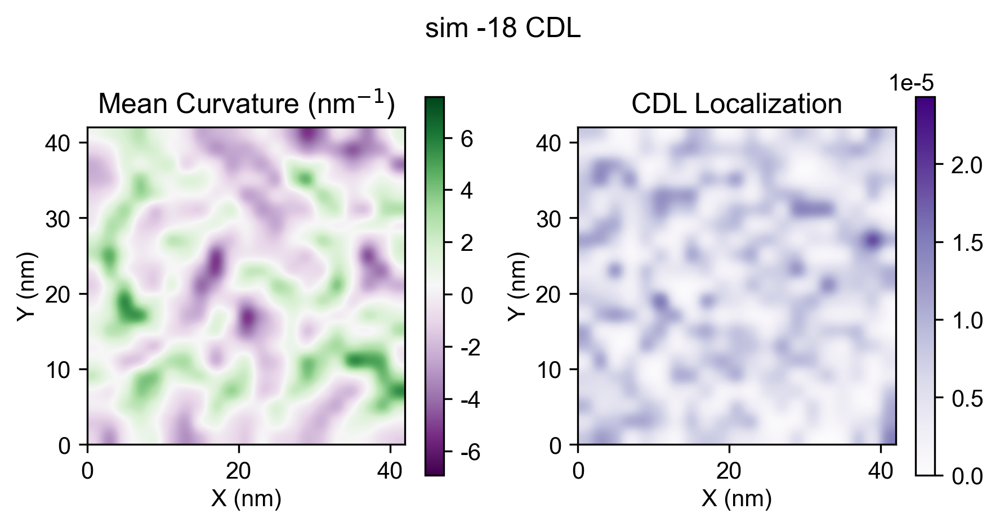

analyzing lipid PG
sim 19
analyzing lipid PC
analyzing lipid PE
analyzing lipid CDL


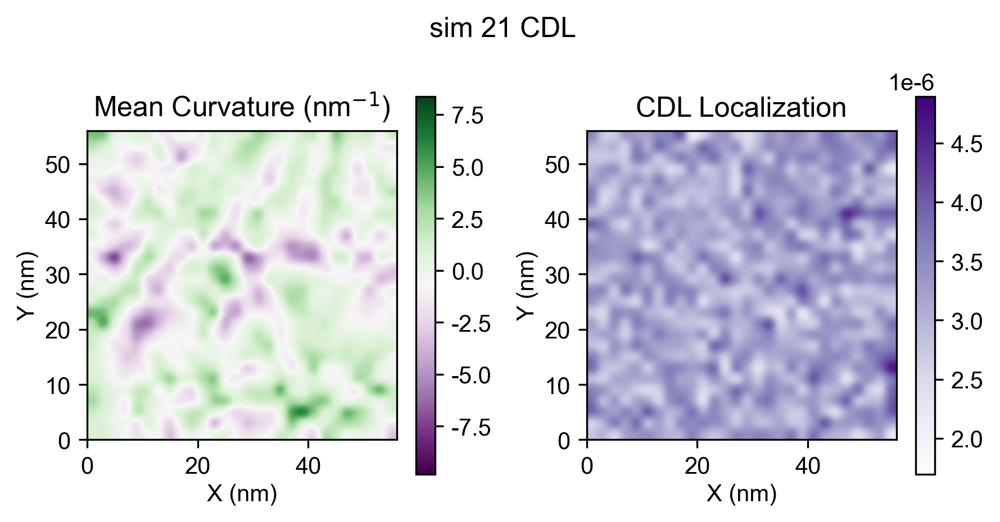

analyzing lipid PG
sim 20
analyzing lipid PC


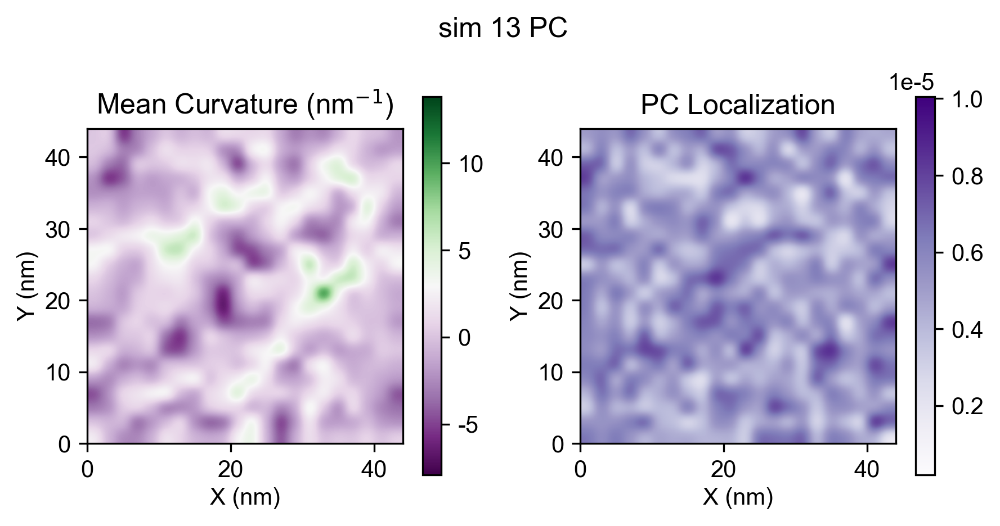

analyzing lipid PE


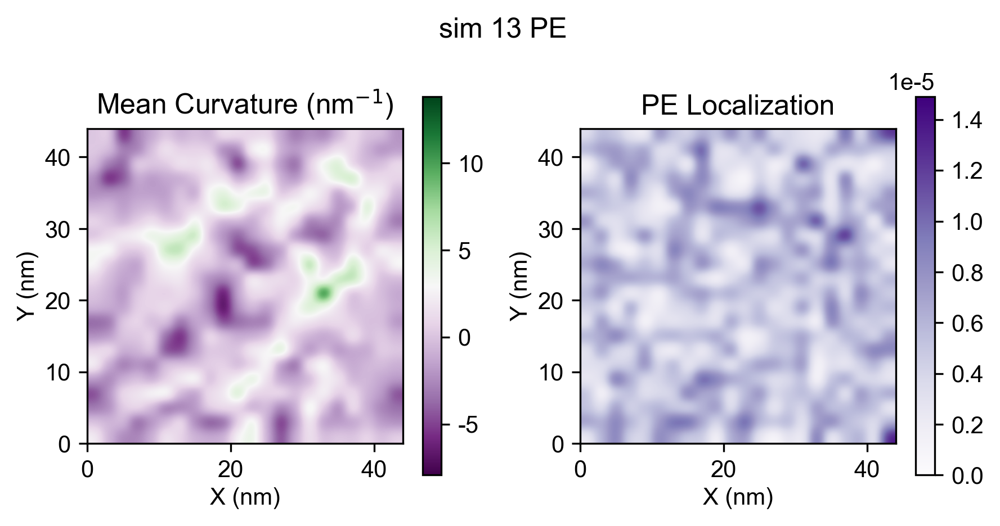

analyzing lipid CDL


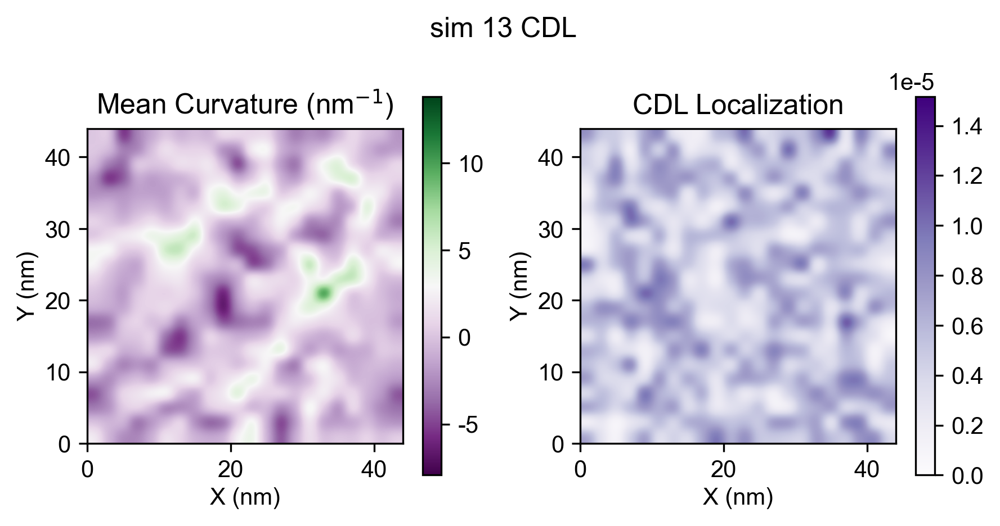

analyzing lipid PG
sim 21
analyzing lipid PC


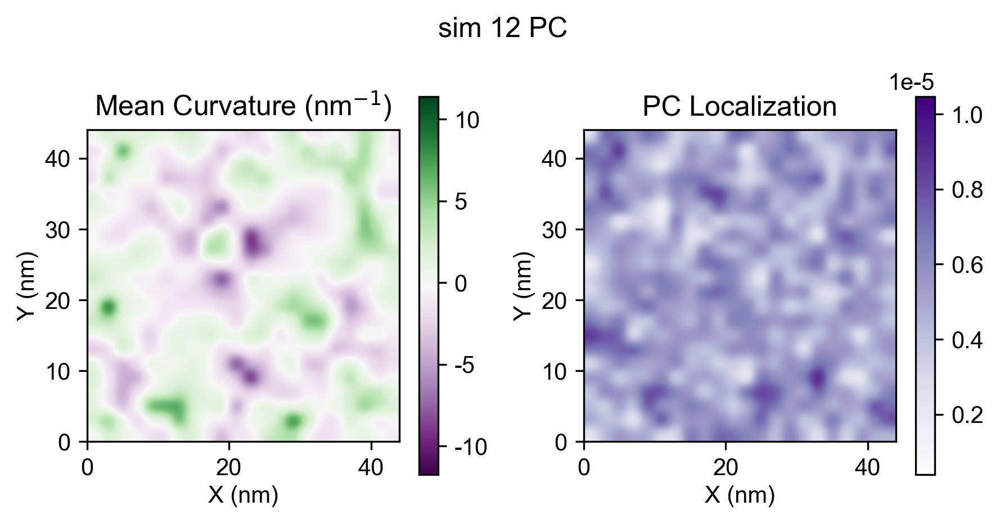

analyzing lipid PE


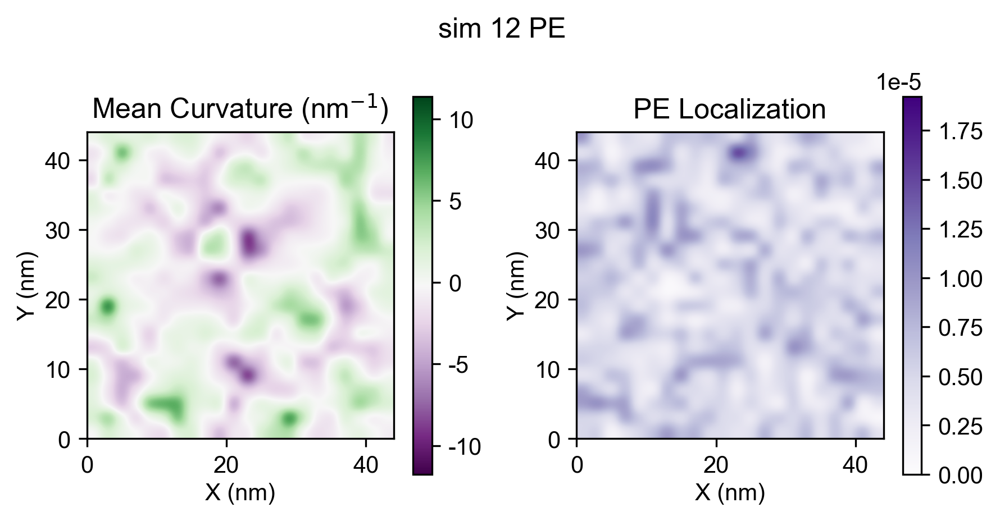

analyzing lipid CDL


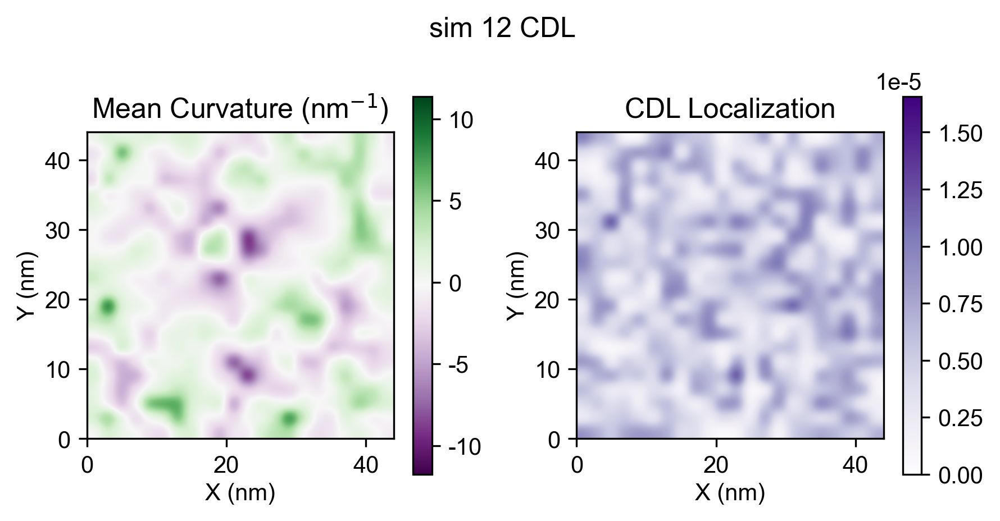

analyzing lipid PG
sim 22
analyzing lipid PC


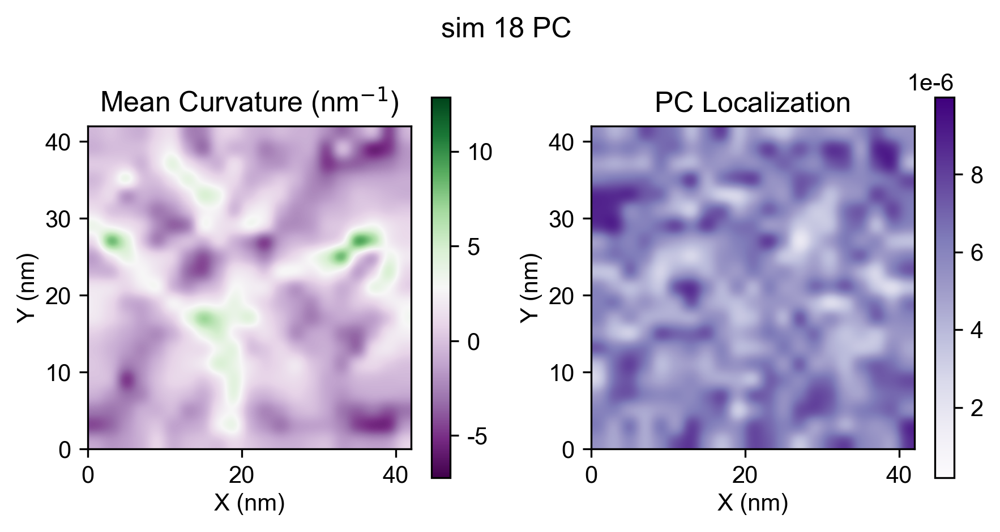

analyzing lipid PE


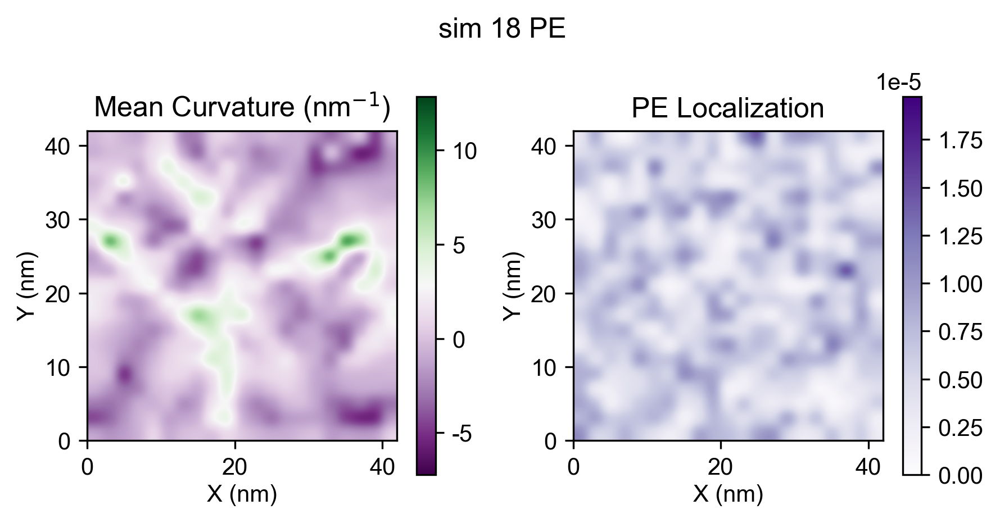

analyzing lipid CDL


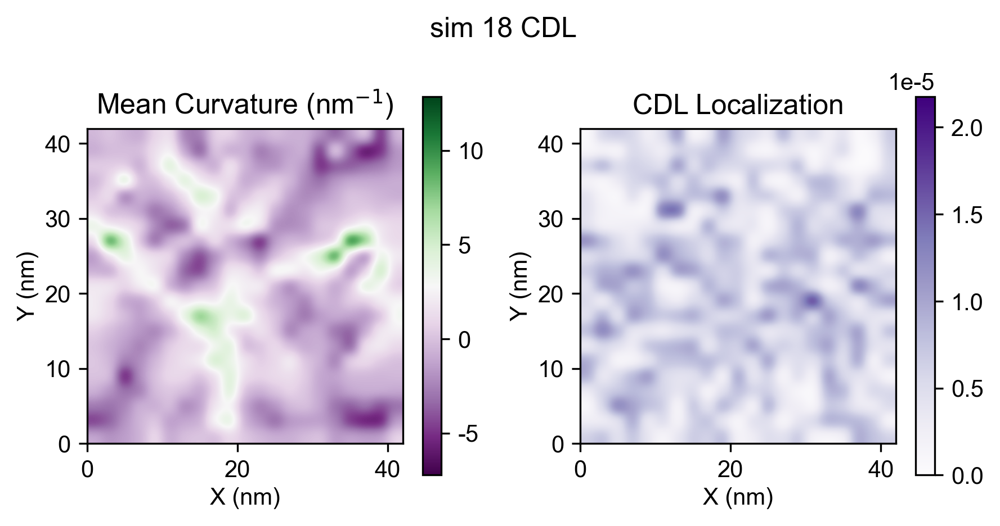

analyzing lipid PG
sim 23
analyzing lipid PC


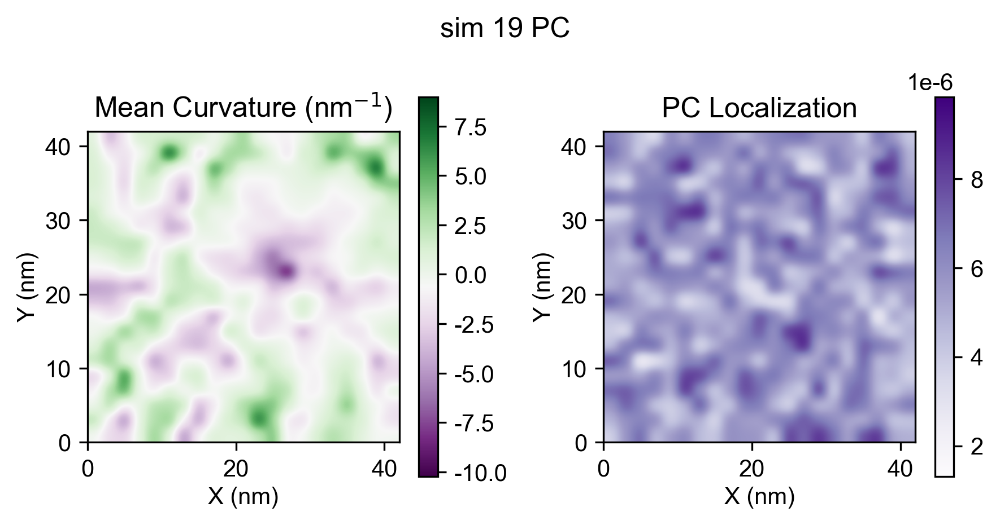

analyzing lipid PE


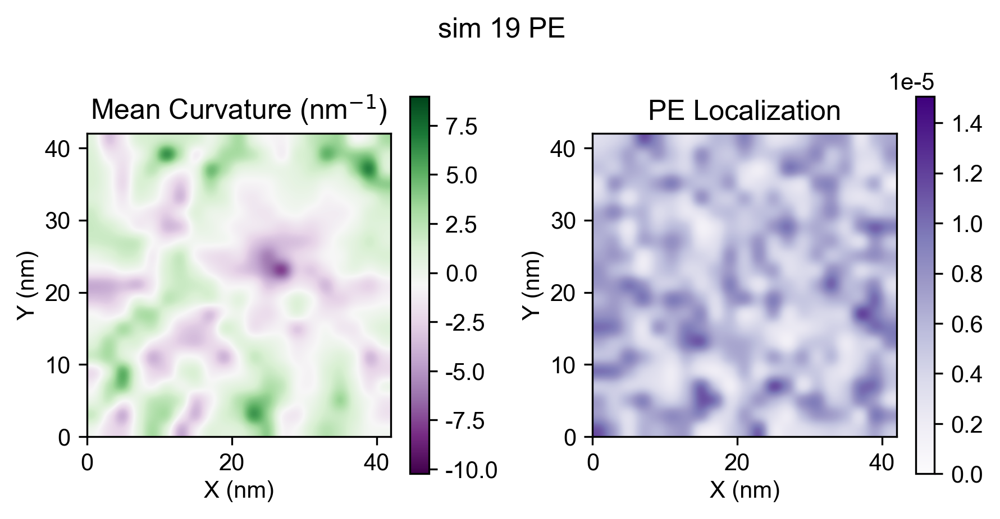

analyzing lipid CDL


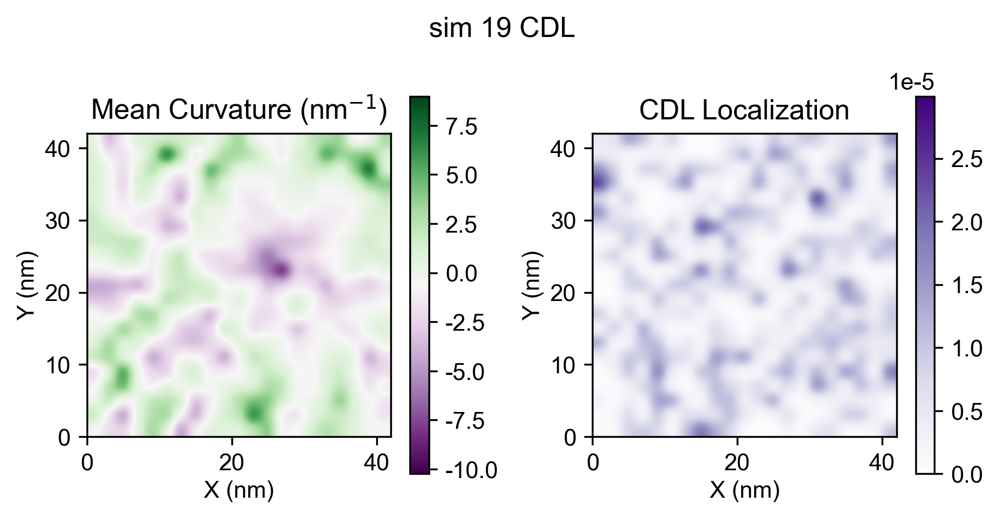

analyzing lipid PG
sim 24
analyzing lipid PC


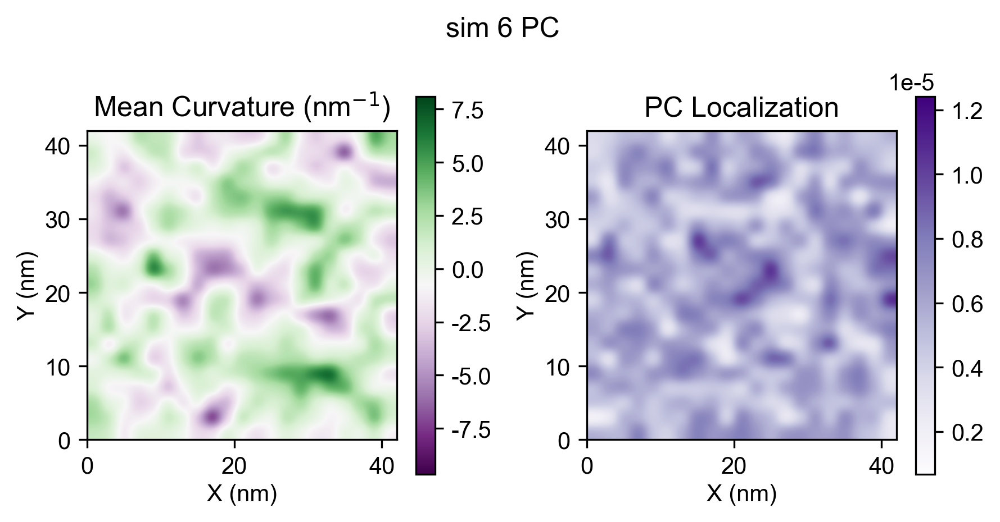

analyzing lipid PE


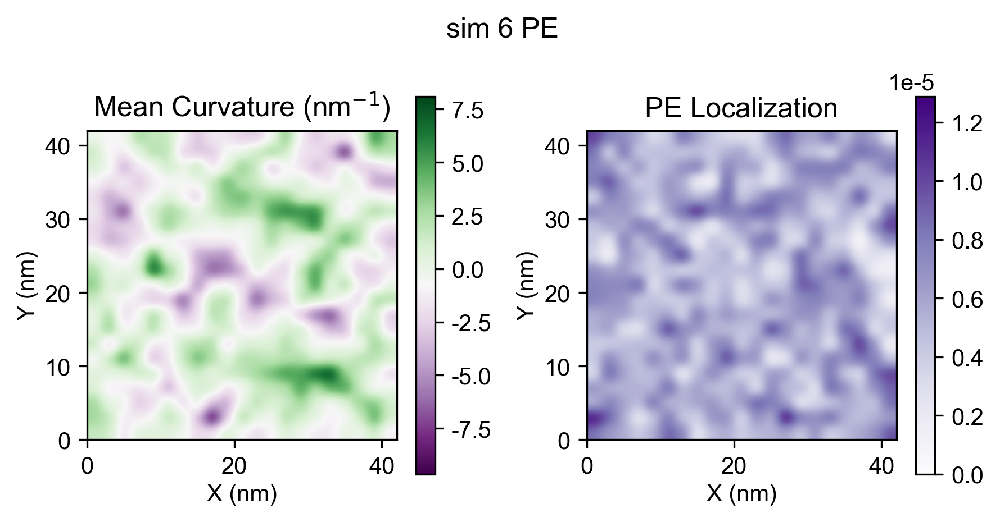

analyzing lipid CDL


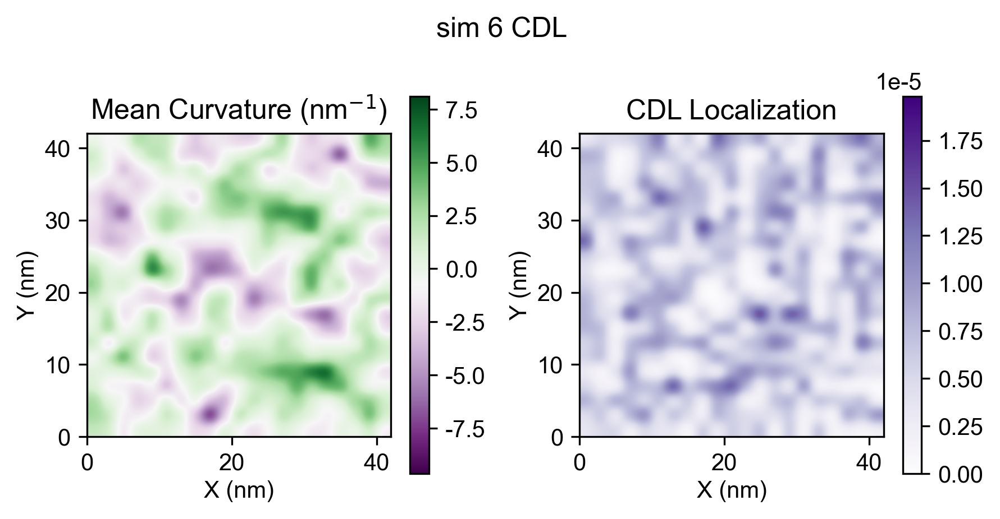

analyzing lipid PG
sim 1_vbt
analyzing lipid PC


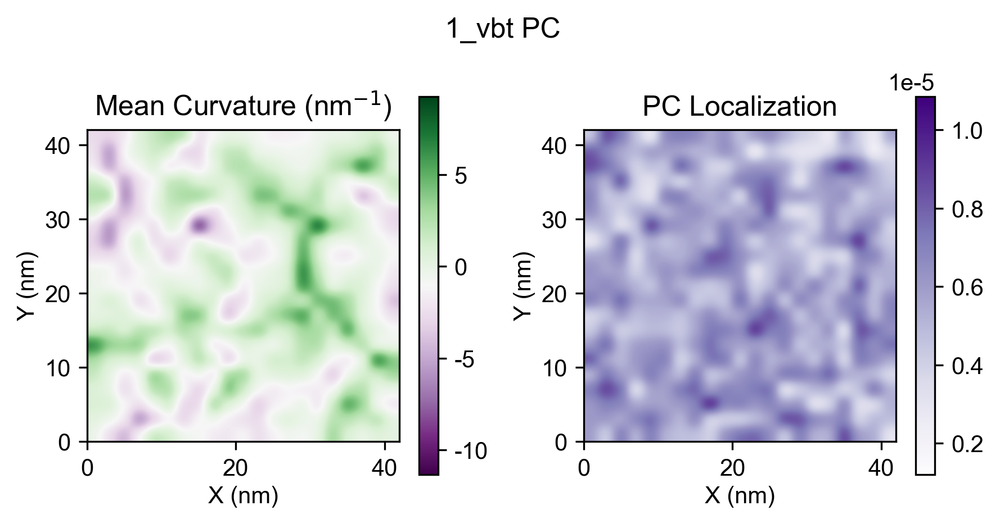

analyzing lipid PE


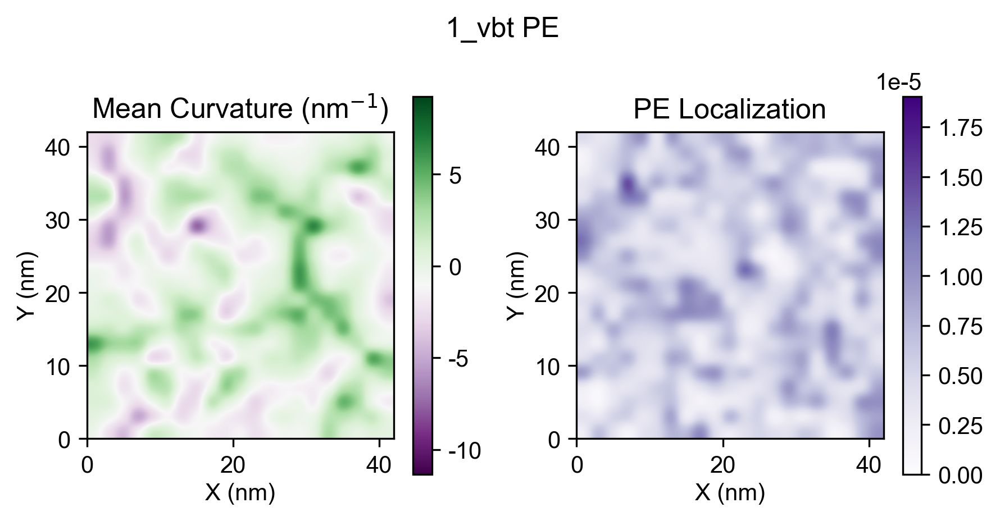

analyzing lipid CDL


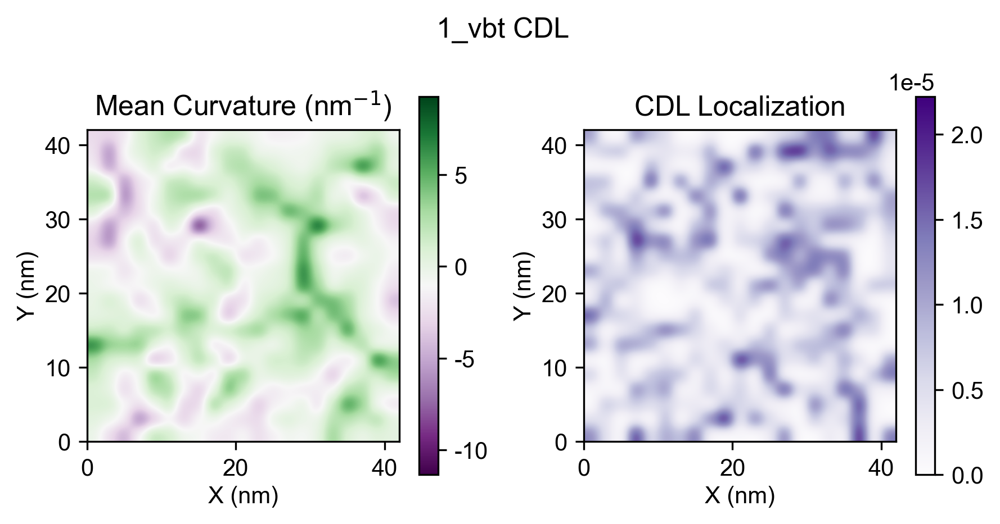

analyzing lipid PG


In [32]:
show_figs = True
curr_fig_path = Path("Figures/geometric_localization")
curr_fig_path.mkdir(parents=True, exist_ok=True)

frames_to_average = 10

for sim in np.concatenate((util.simulations, ["1_vbt"])):
    print(f"sim {sim}")
    with open(
        util.analysis_path / f"{sim}/membrane_curvature_2nm.pickle", "rb"
    ) as handle:
        mc = pickle.load(handle)

    h = mc.results["height"][1:]
    mean_curvatures = np.zeros_like(h)
    for i in range(h.shape[0]):
        mean_curvatures[i] = mean_curvature(h[i])

    mean_curvature_averaged = np.mean(
        mean_curvatures[-frames_to_average * 3 : -frames_to_average*2], axis=0
    )

    gro = util.analysis_path / f"{sim}/po4_only.gro"
    traj = util.analysis_path / f"{sim}/po4_all.xtc"

    u = MDAnalysis.Universe(gro, str(traj), refresh_offsets=True)
    ag = determine_leaflets(u, po4_neighbor_sel)

    for k, query in queries.items():
        print(f"analyzing lipid {k}")

        if len(u.select_atoms(query)) == 0:
            continue

        upper_positions = []
        lower_positions = []
        for ts in u.trajectory[-frames_to_average:]:
            upper_positions.append(ag["upper"].select_atoms(query).positions[:, 0:2])
            lower_positions.append(ag["upper"].select_atoms(query).positions[:, 0:2])

        # Convert to numpy array
        upper_positions = np.vstack(upper_positions)
        lower_positions = np.vstack(lower_positions)

        H_upper, xe, ye = np.histogram2d(
            upper_positions[:, 0],
            upper_positions[:, 1],
            bins=mc.n_x_bins,
            range=[[mc.x_range[0], mc.x_range[1]], [mc.y_range[0], mc.y_range[1]]],
            density=True,
        )

        # fig, ax = plt.subplots(1, 3, figsize=(9, 3))  # sharex=True,
        fig, ax = plt.subplots(1, 2, figsize=(6, 3))  # sharex=True,

        im0 = ax[0].imshow(
            mean_curvature_averaged * 10,
            extent=[xe[0] / 10, xe[-1] / 10, ye[0] / 10, ye[-1] / 10],
            interpolation="gaussian",
            origin="lower",
            cmap="PRGn",
        )
        ax[0].set_ylabel("Y (nm)")
        ax[0].set_xlabel("X (nm)")

        plt.colorbar(im0, ax=ax[0])

        ax[0].set_title(r"Mean Curvature (nm$^{-1}$)")

        im1 = ax[1].imshow(
            H_upper,
            extent=[xe[0] / 10, xe[-1] / 10, ye[0] / 10, ye[-1] / 10],
            interpolation="gaussian",
            cmap="Purples",
        )
        plt.colorbar(im1, ax=ax[1])
        ax[1].set_title(f"{k} Localization")
        ax[1].set_ylabel("Y (nm)")
        ax[1].set_xlabel("X (nm)")
        # ax[2].scatter(upper_positions[:,0], upper_positions[:,1], color='k', s=0.1)
        # ax[2].set_aspect("equal")

        if sim == "1_vbt":
            fig.suptitle(f"1_vbt {k}")
        else:
            fig.suptitle(f"sim {util.sim_to_final_index[int(sim)]} {k}")

        fig.tight_layout()

        if sim == "1_vbt":
            fig.savefig(
                curr_fig_path / f"1_vbt_curvature_localization_{k}.png", format="png"
            )
            fig.savefig(
                curr_fig_path / f"1_vbt_curvature_localization_{k}.pdf", format="pdf"
            )
        else:
            fig.savefig(
                curr_fig_path
                / f"{util.sim_to_final_index[int(sim)]}_curvature_localization_{k}.png",
                format="png",
            )
            fig.savefig(
                curr_fig_path
                / f"{util.sim_to_final_index[int(sim)]}_curvature_localization_{k}.pdf",
                format="pdf",
            )

        if show_figs:
            plt.show()

        fig.clear()
        plt.close(fig)


sim 1
analyzing lipid PC


  0%|          | 0/100 [00:00<?, ?it/s]

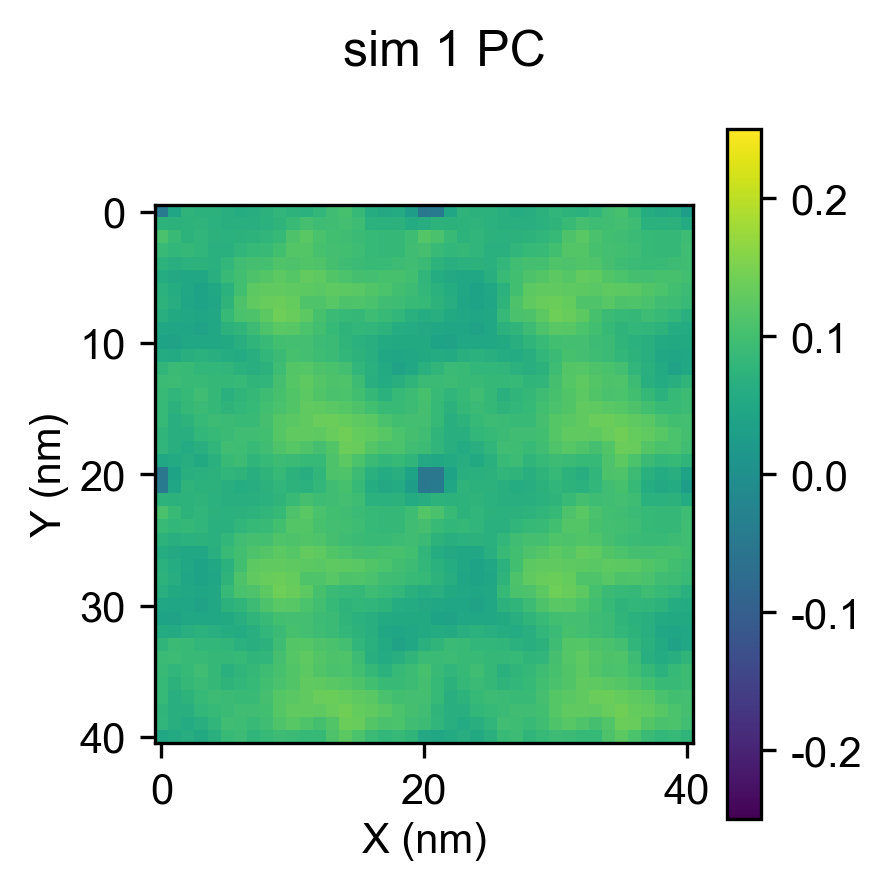

analyzing lipid PE


  0%|          | 0/100 [00:00<?, ?it/s]

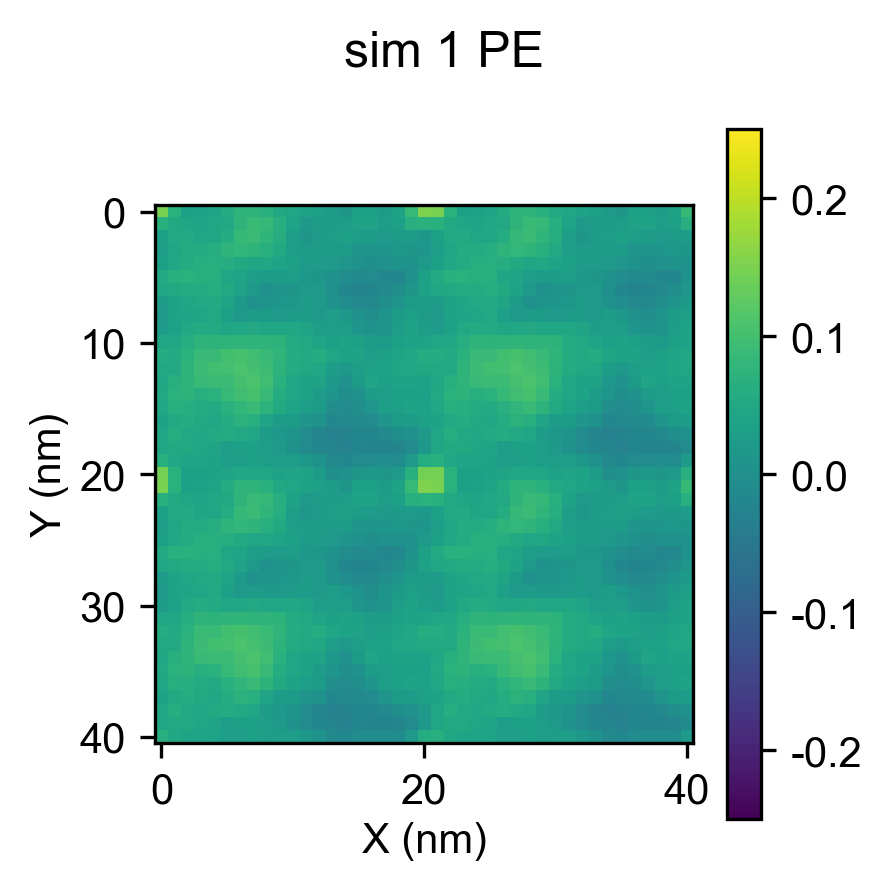

analyzing lipid CDL


  0%|          | 0/100 [00:00<?, ?it/s]

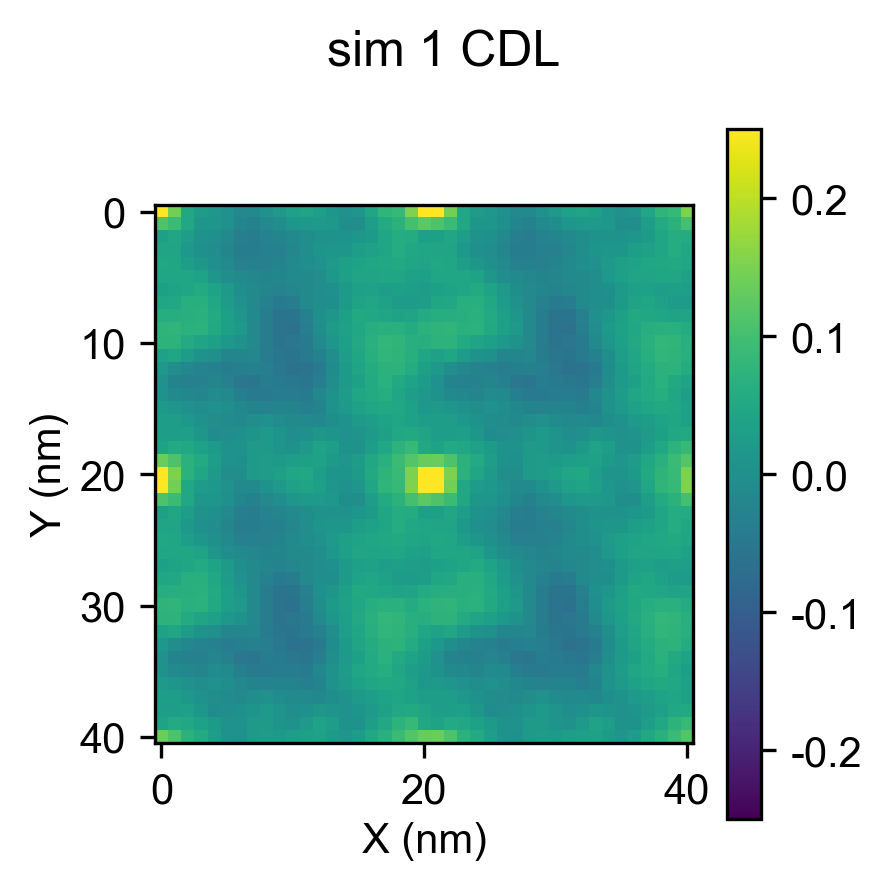

analyzing lipid PG
sim 2
analyzing lipid PC


  0%|          | 0/100 [00:00<?, ?it/s]

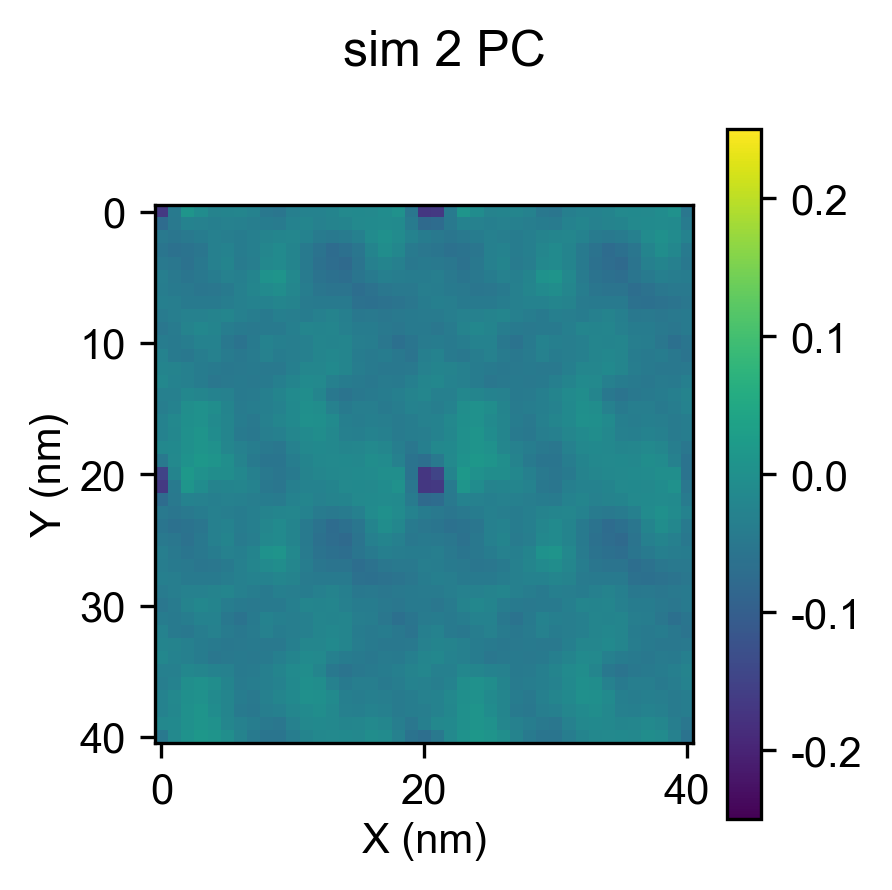

analyzing lipid PE


  0%|          | 0/100 [00:00<?, ?it/s]

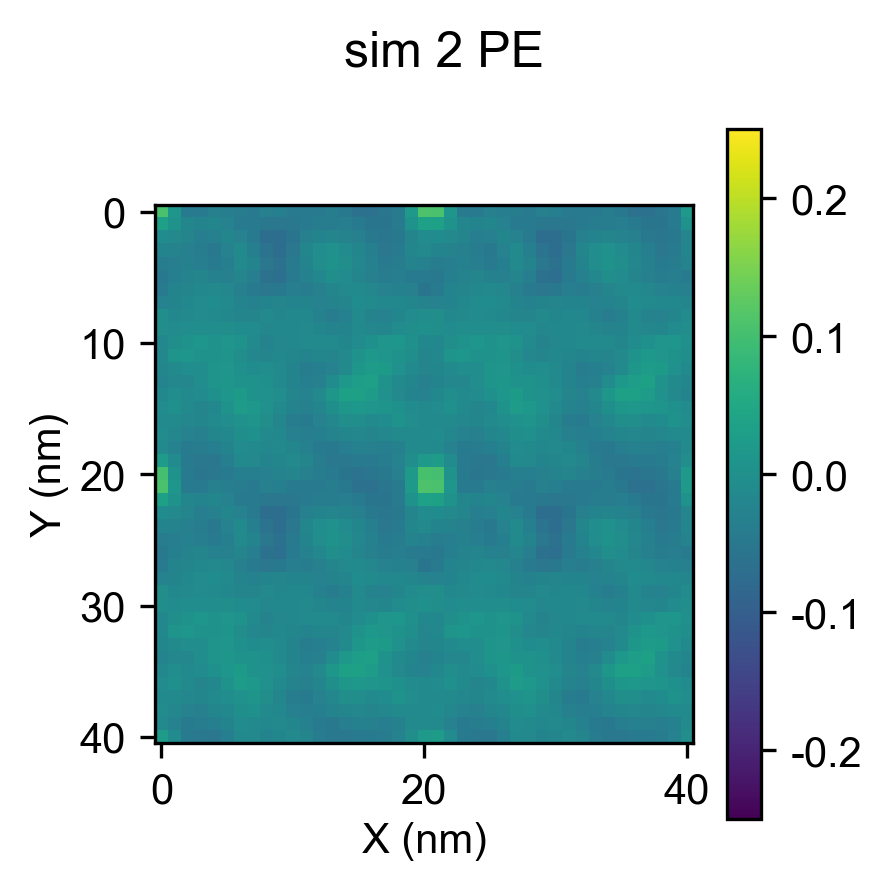

analyzing lipid CDL


  0%|          | 0/100 [00:00<?, ?it/s]

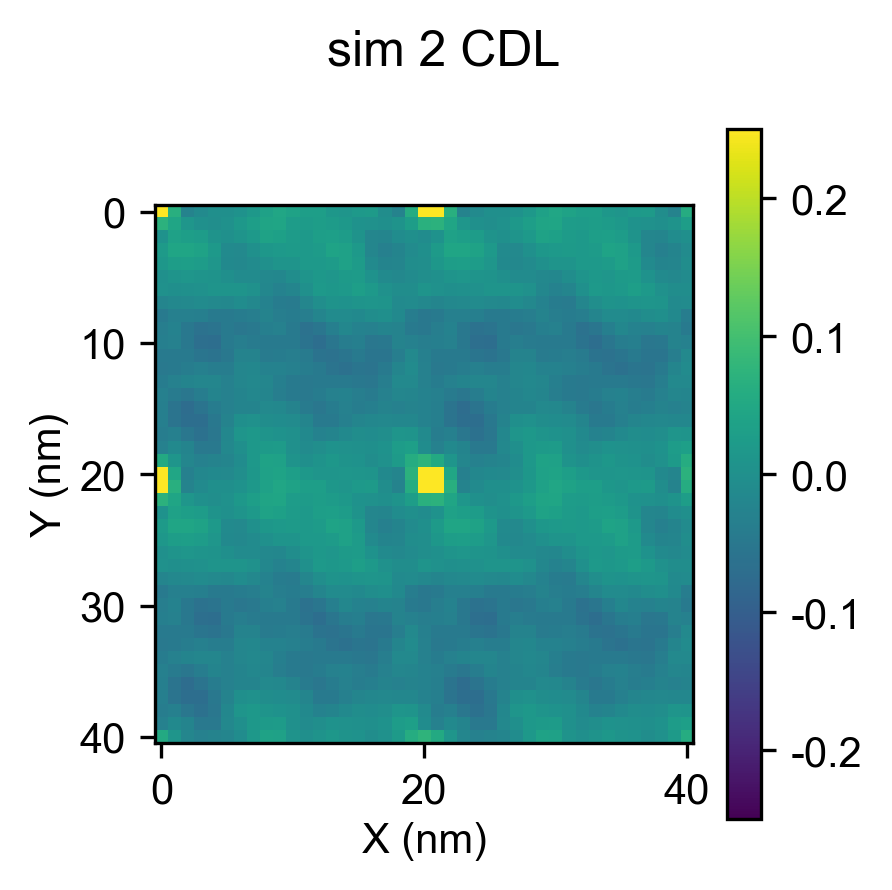

analyzing lipid PG
sim 3
analyzing lipid PC


  0%|          | 0/100 [00:00<?, ?it/s]

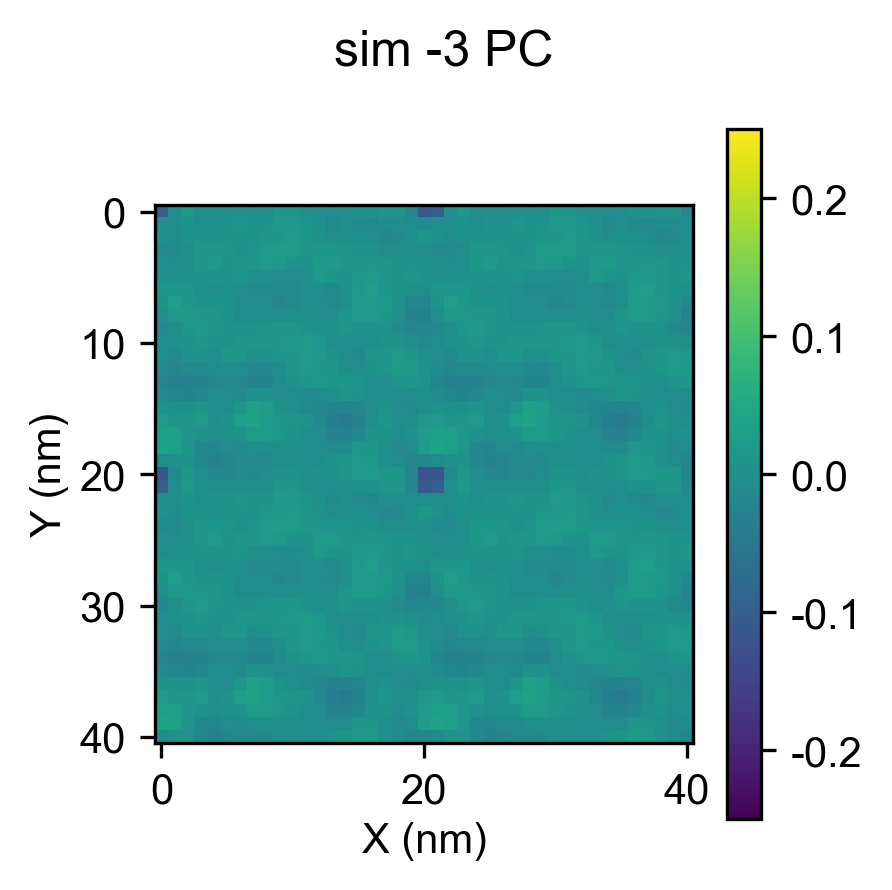

analyzing lipid PE


  0%|          | 0/100 [00:00<?, ?it/s]

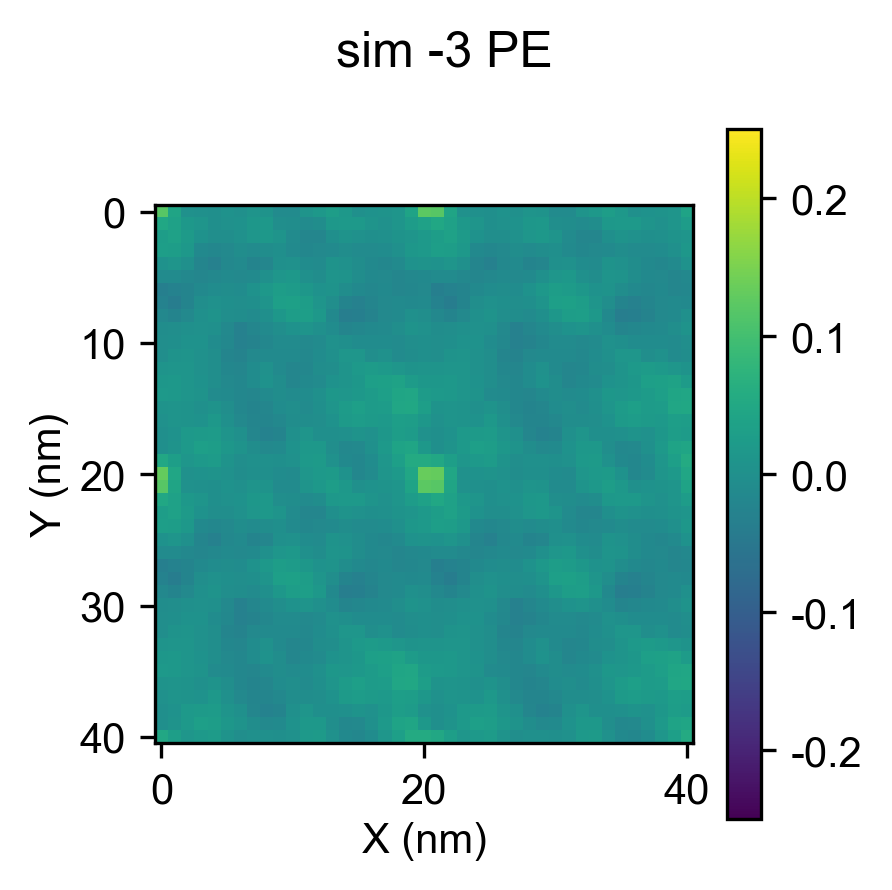

analyzing lipid CDL


  0%|          | 0/100 [00:00<?, ?it/s]

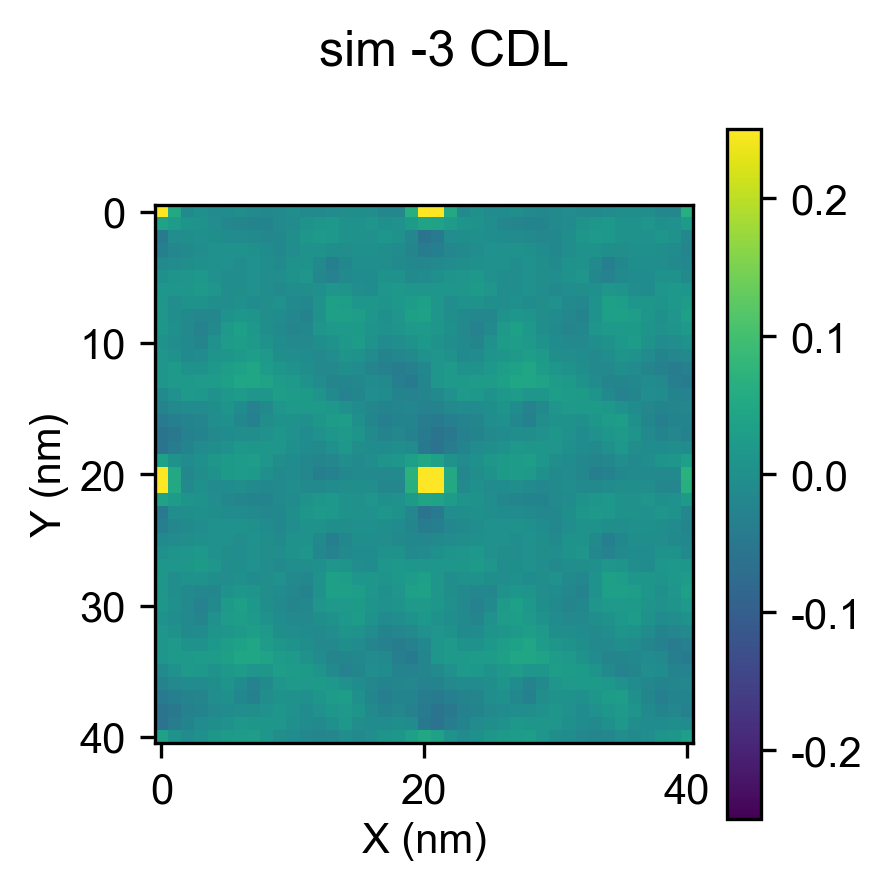

analyzing lipid PG
sim 4
analyzing lipid PC


  0%|          | 0/100 [00:00<?, ?it/s]

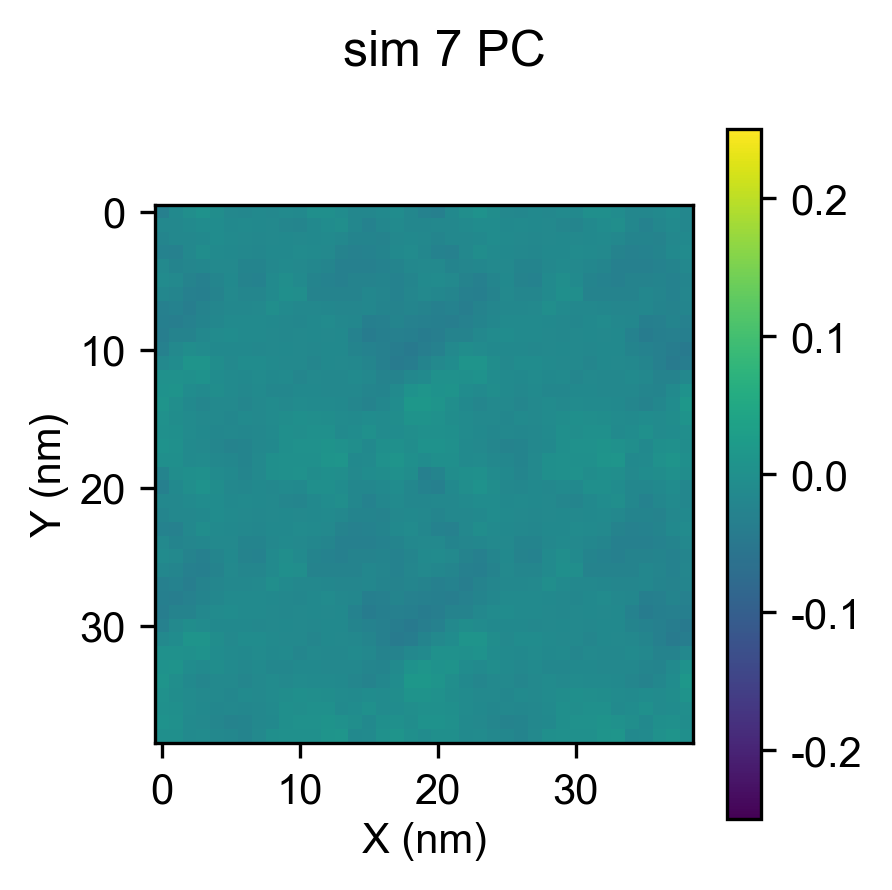

analyzing lipid PE


  0%|          | 0/100 [00:00<?, ?it/s]

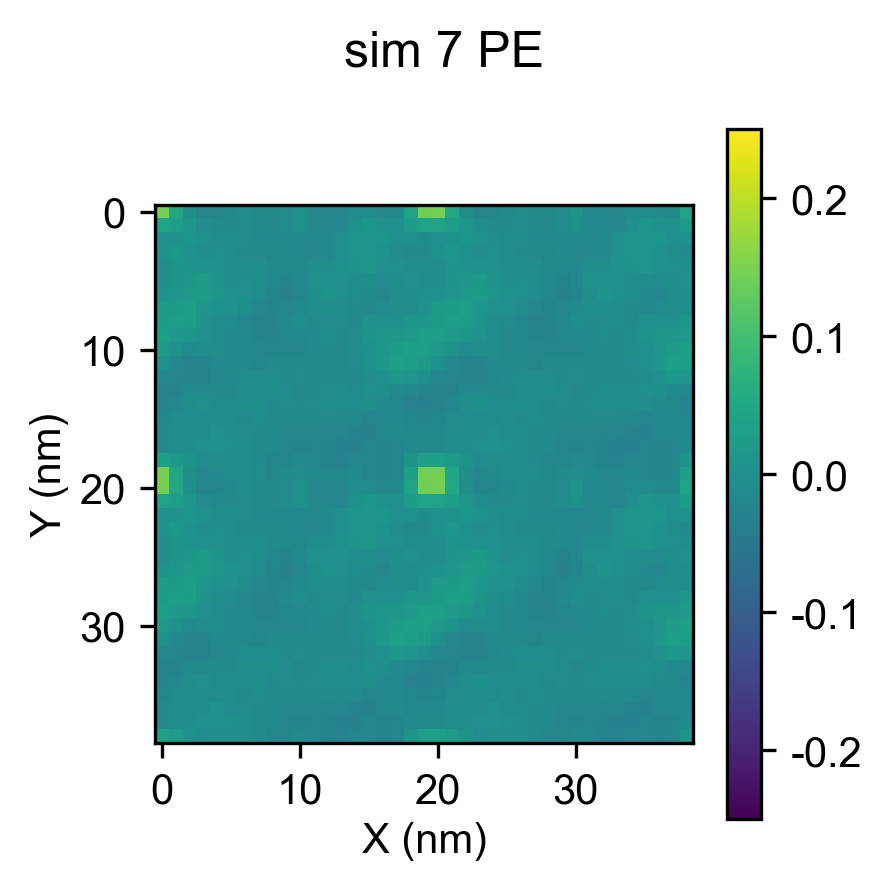

analyzing lipid CDL
analyzing lipid PG


  0%|          | 0/100 [00:00<?, ?it/s]

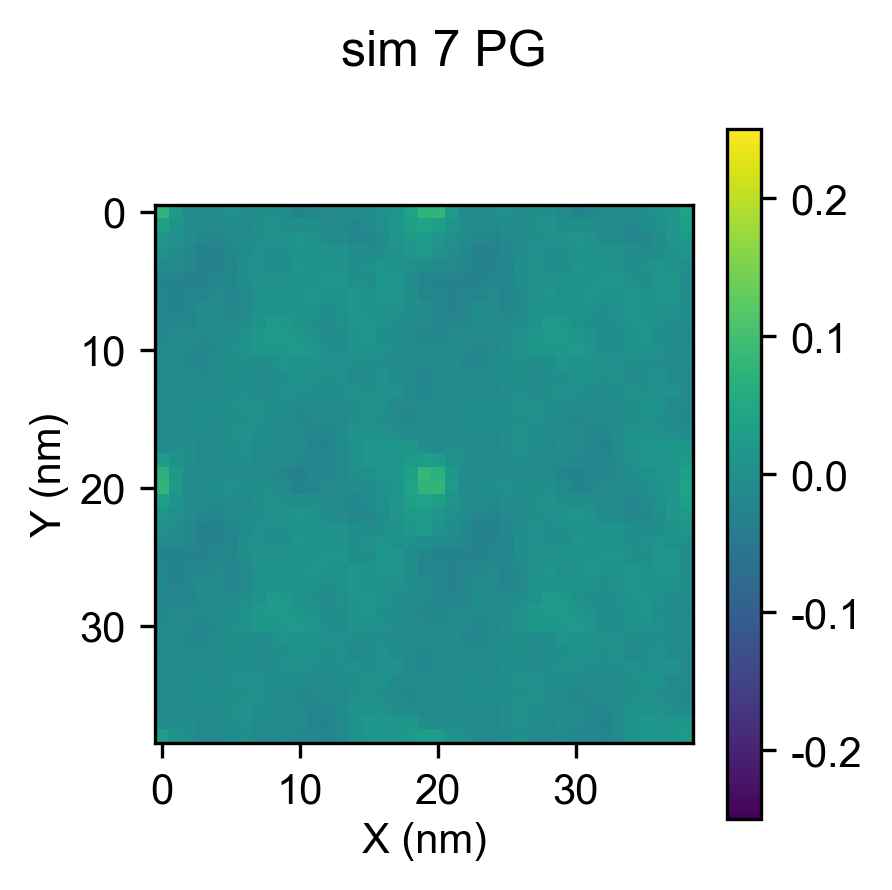

sim 5
analyzing lipid PC


  0%|          | 0/100 [00:00<?, ?it/s]

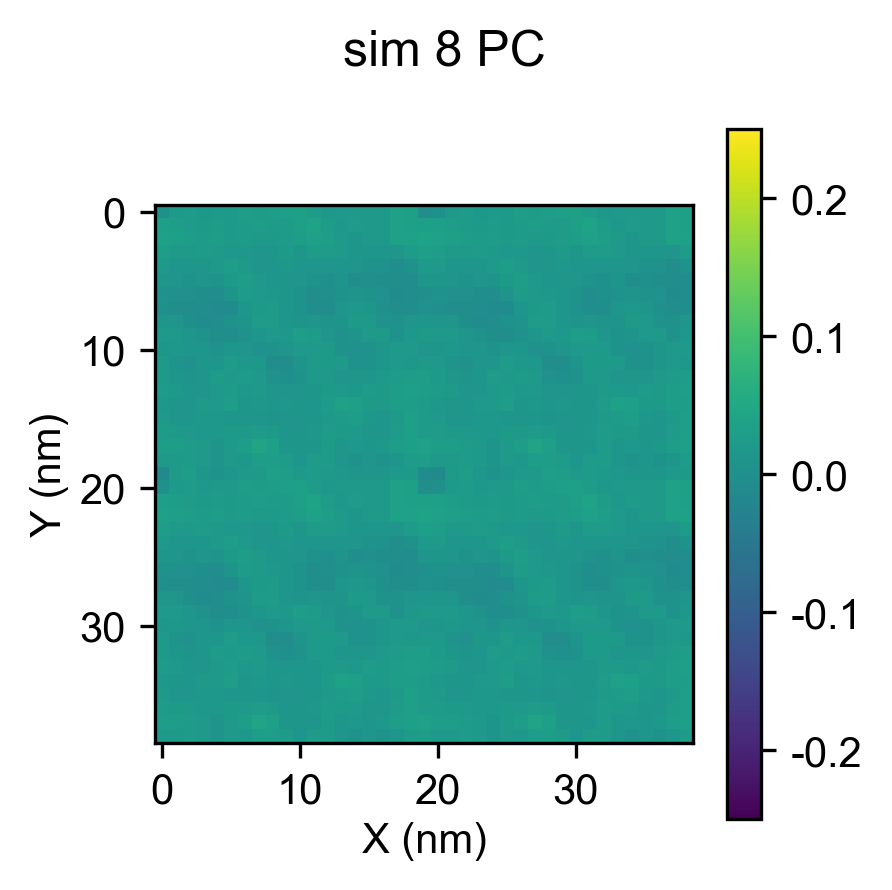

analyzing lipid PE


  0%|          | 0/100 [00:00<?, ?it/s]

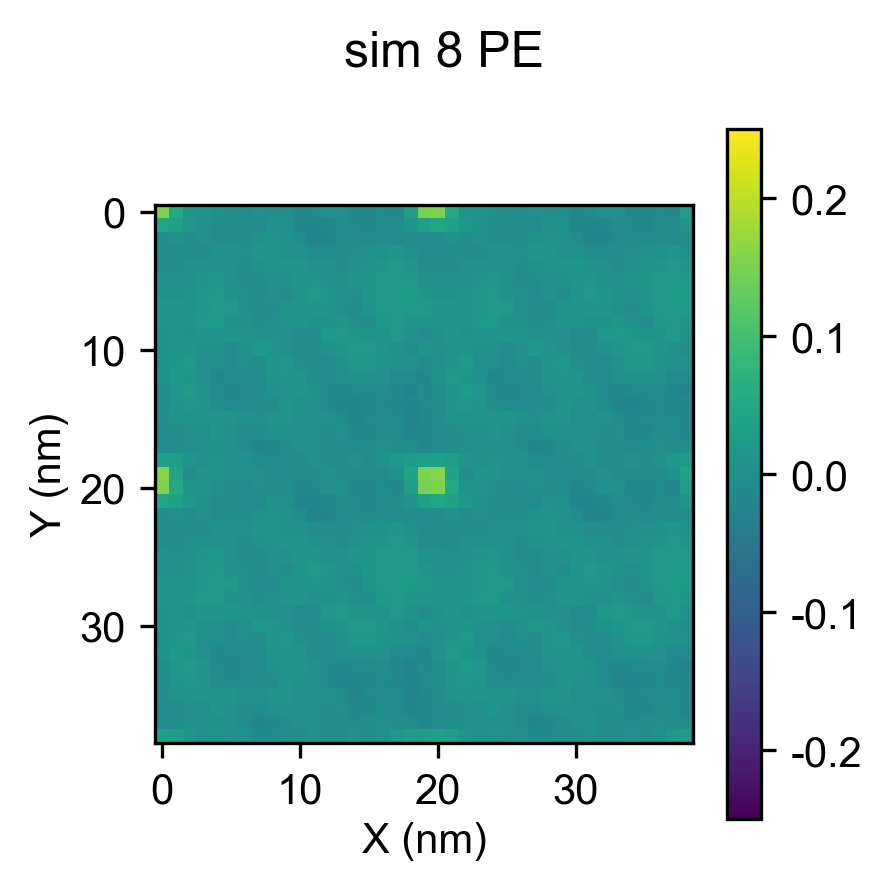

analyzing lipid CDL
analyzing lipid PG


  0%|          | 0/100 [00:00<?, ?it/s]

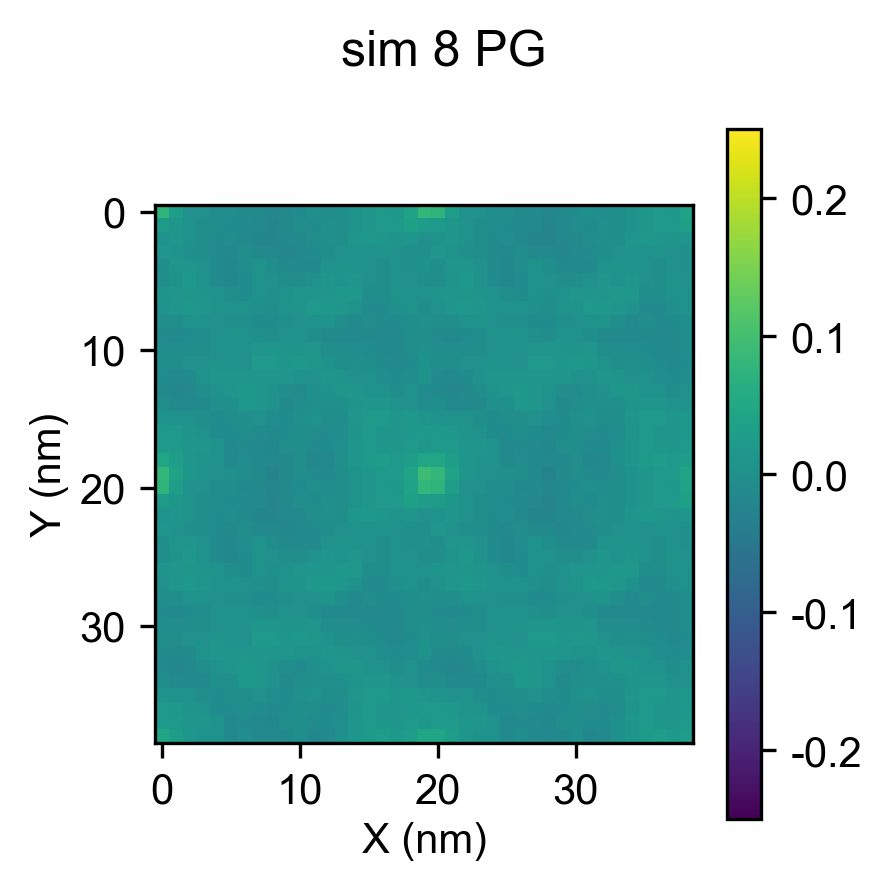

sim 6
analyzing lipid PC


  0%|          | 0/100 [00:00<?, ?it/s]

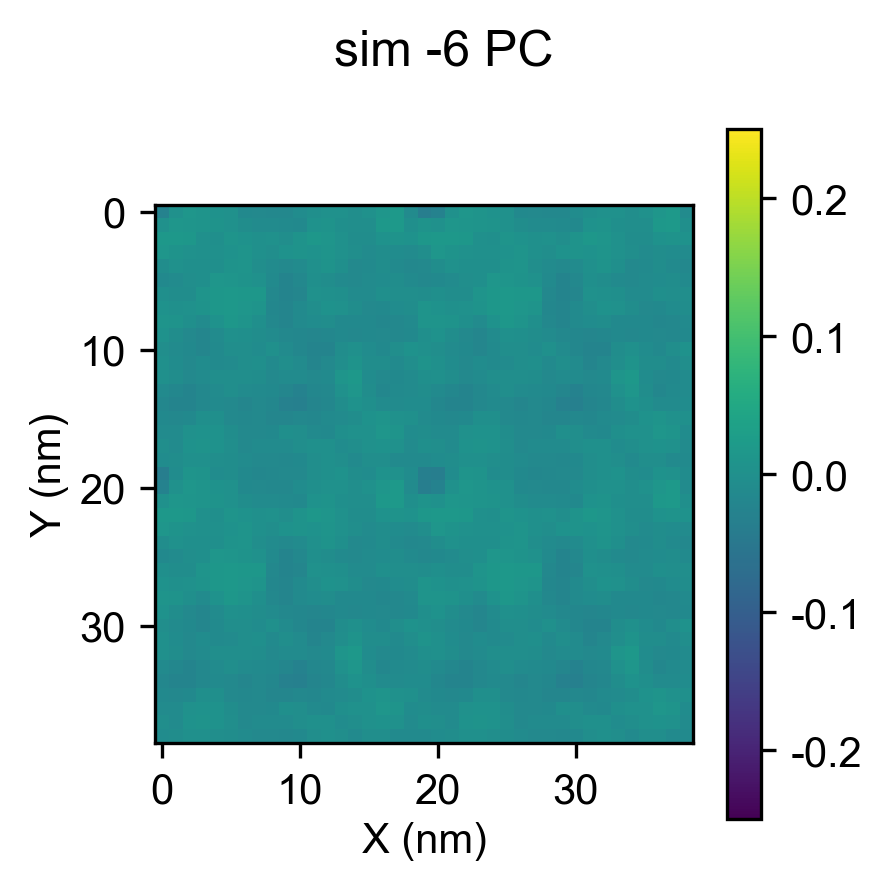

analyzing lipid PE


  0%|          | 0/100 [00:00<?, ?it/s]

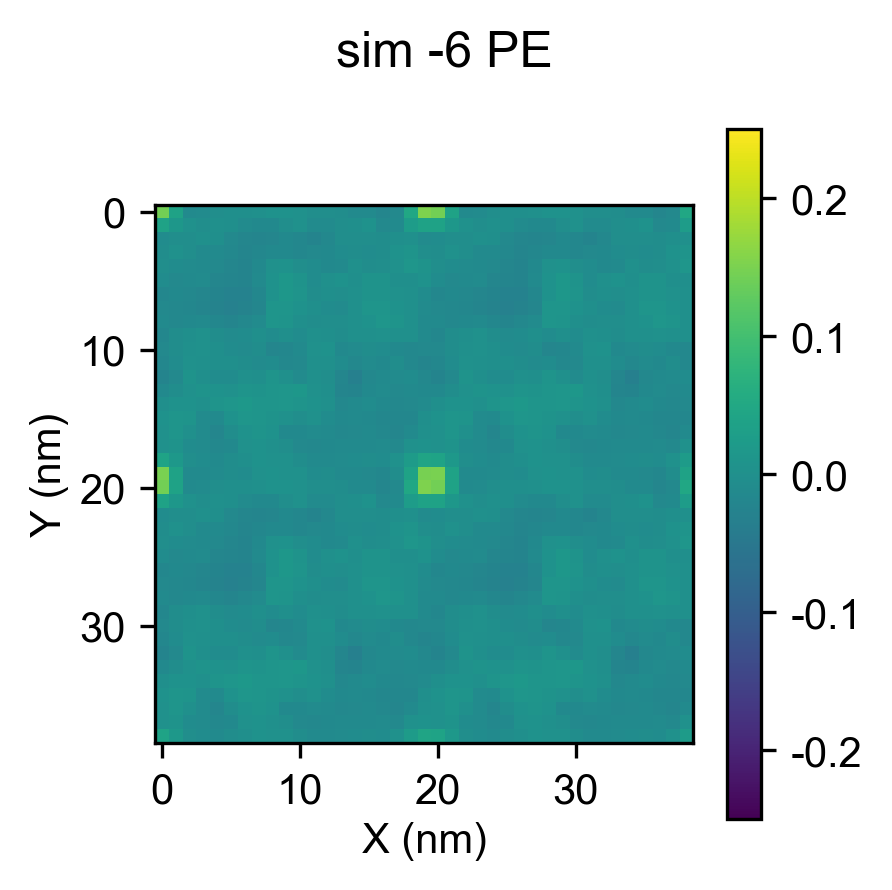

analyzing lipid CDL
analyzing lipid PG


  0%|          | 0/100 [00:00<?, ?it/s]

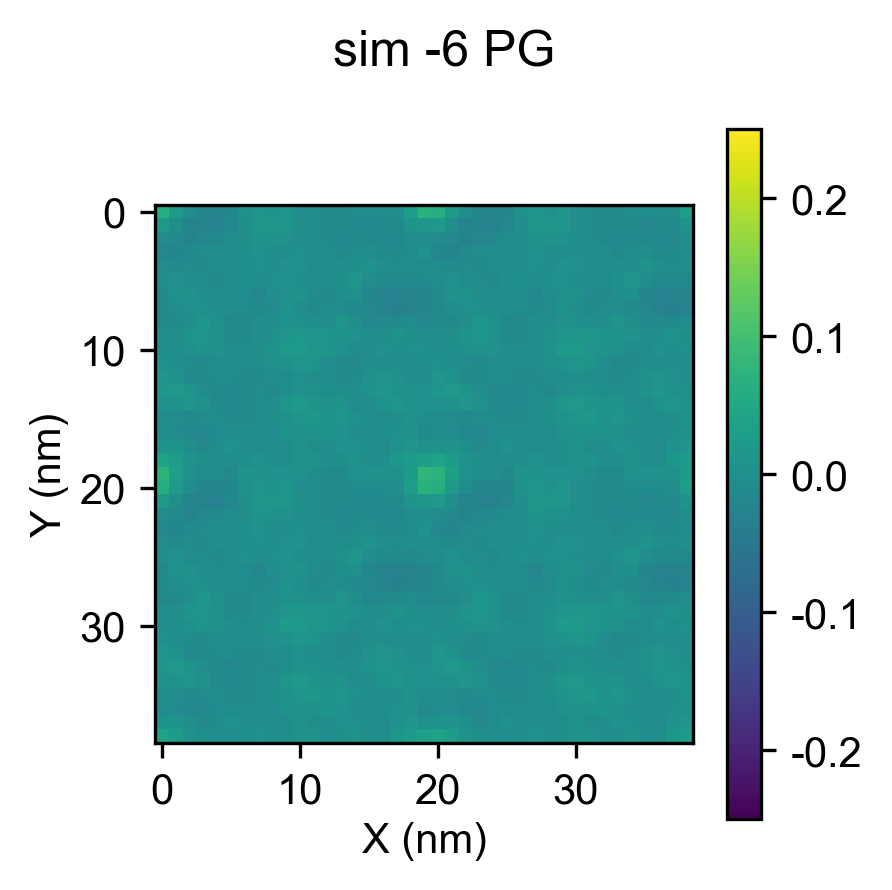

sim 7
analyzing lipid PC
analyzing lipid PE
analyzing lipid CDL


  0%|          | 0/100 [00:00<?, ?it/s]

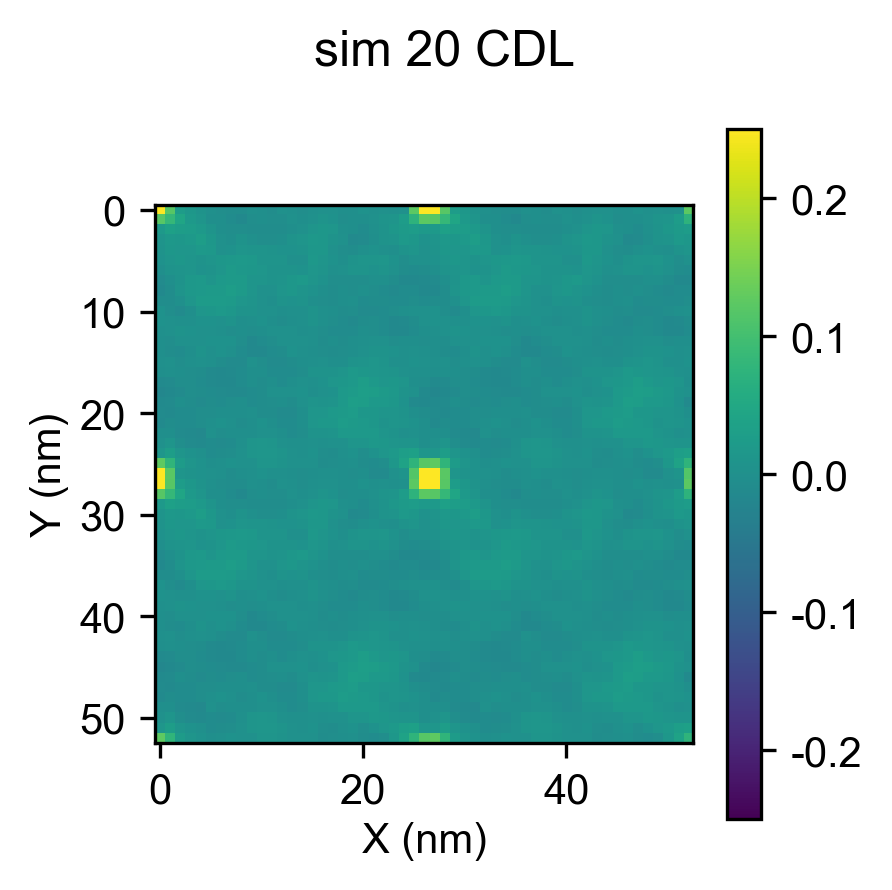

analyzing lipid PG
sim 8
analyzing lipid PC


  0%|          | 0/100 [00:00<?, ?it/s]

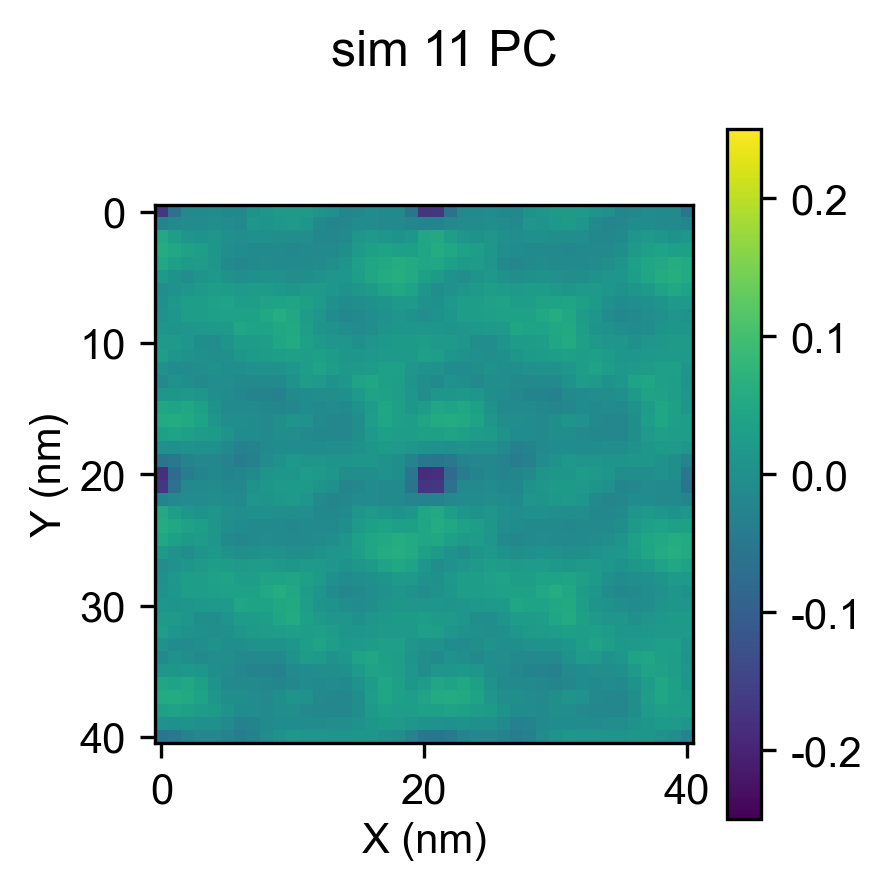

analyzing lipid PE


  0%|          | 0/100 [00:00<?, ?it/s]

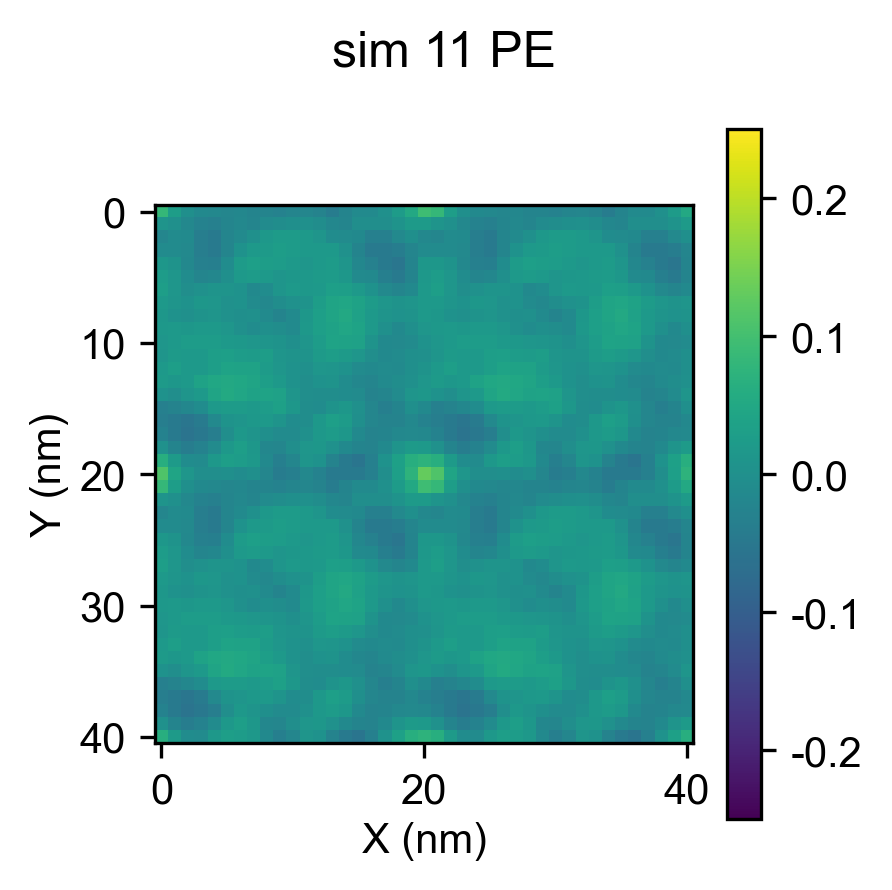

analyzing lipid CDL


  0%|          | 0/100 [00:00<?, ?it/s]

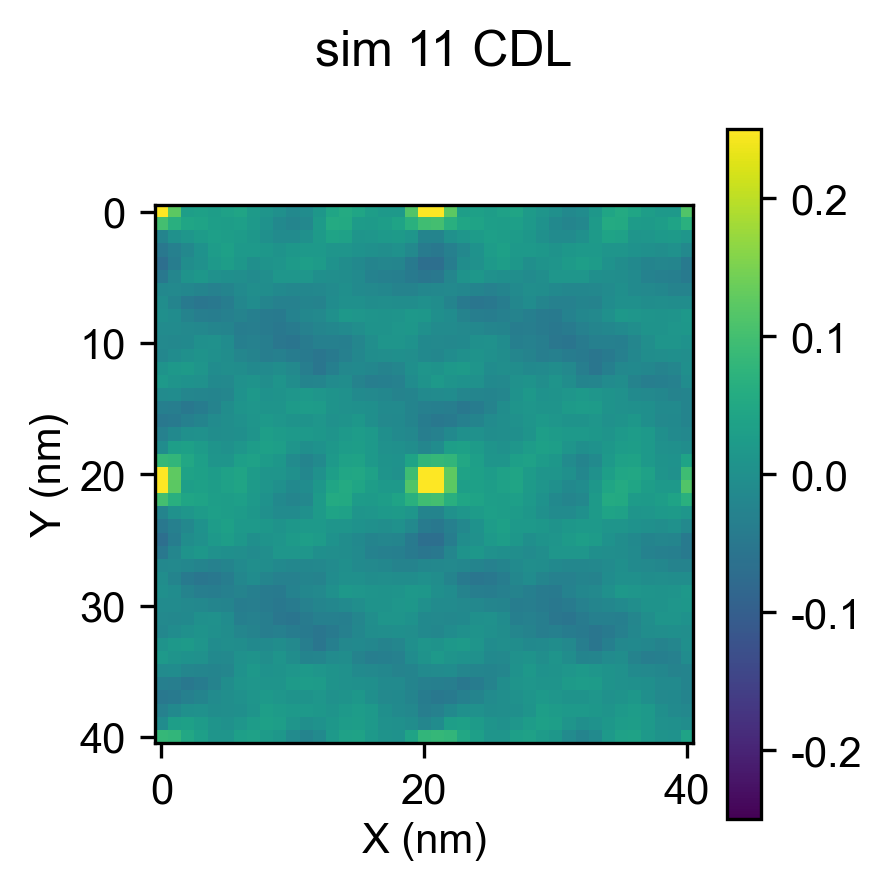

analyzing lipid PG
sim 9
analyzing lipid PC


  0%|          | 0/100 [00:00<?, ?it/s]

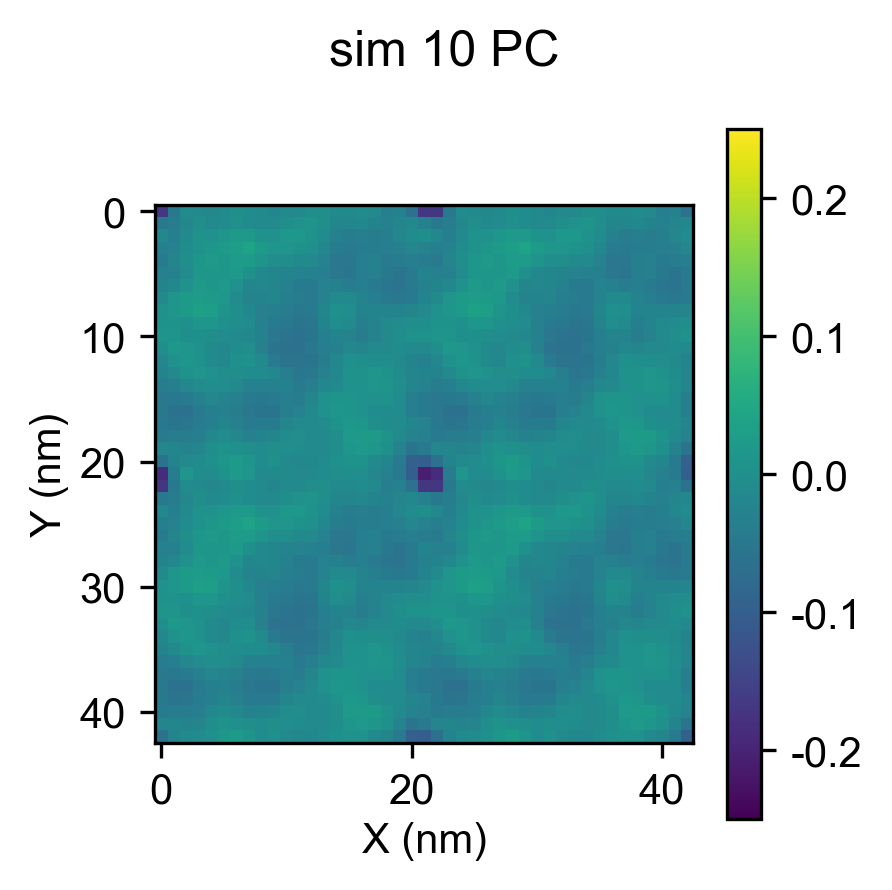

analyzing lipid PE


  0%|          | 0/100 [00:00<?, ?it/s]

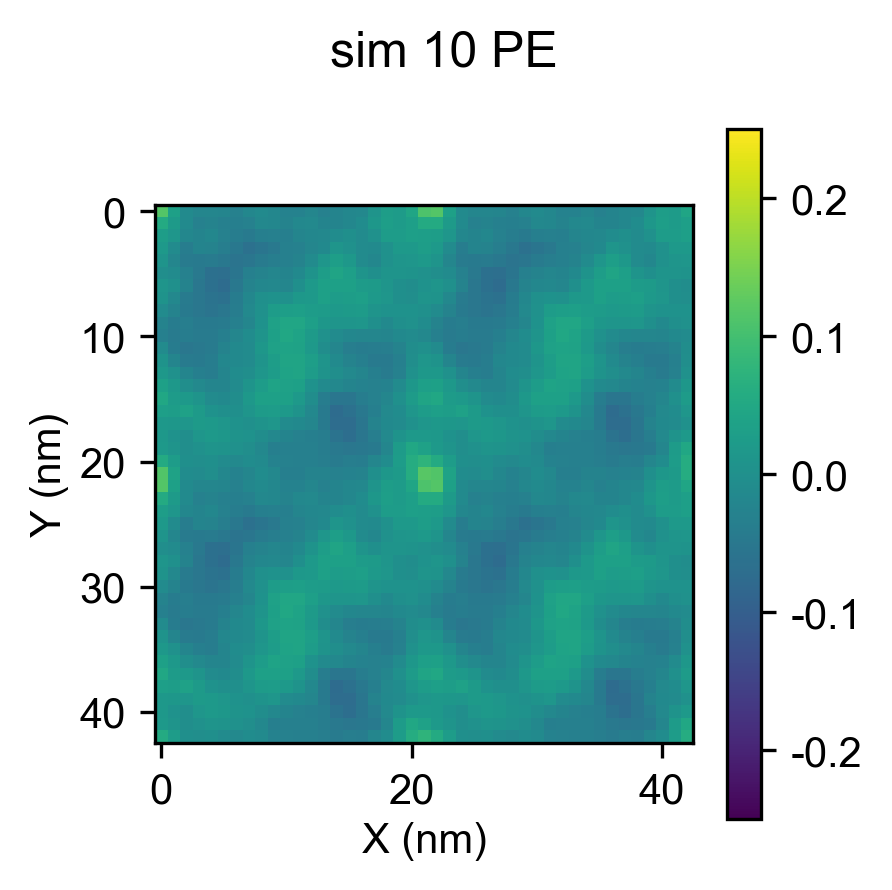

analyzing lipid CDL


  0%|          | 0/100 [00:00<?, ?it/s]

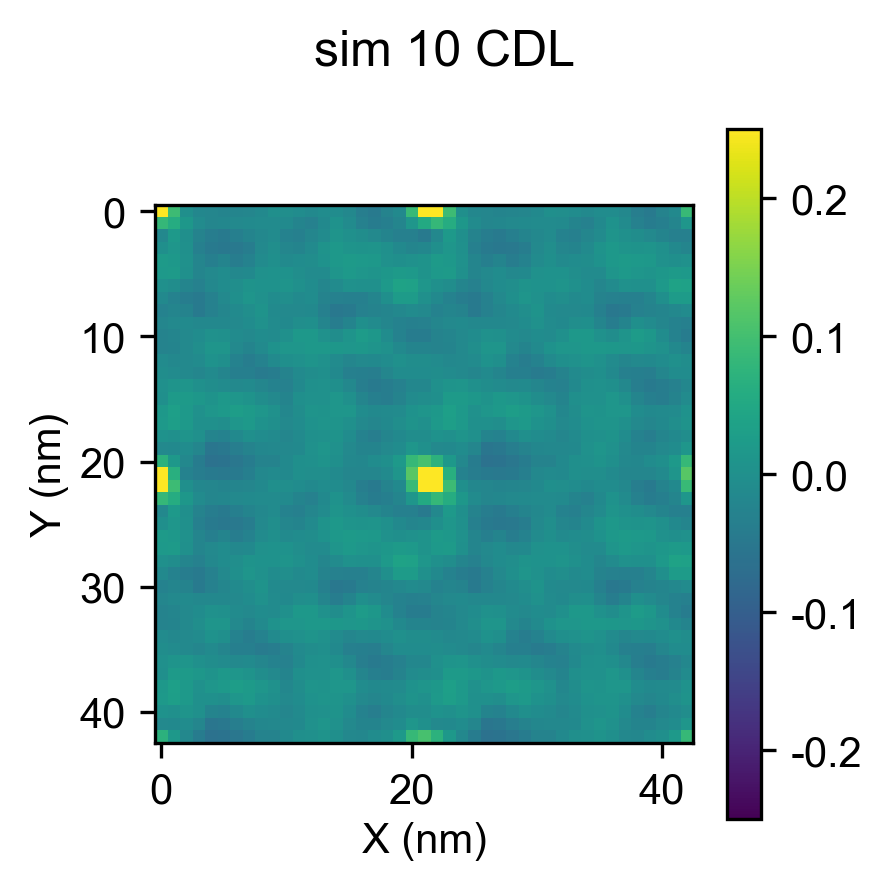

analyzing lipid PG
sim 10
analyzing lipid PC


  0%|          | 0/100 [00:00<?, ?it/s]

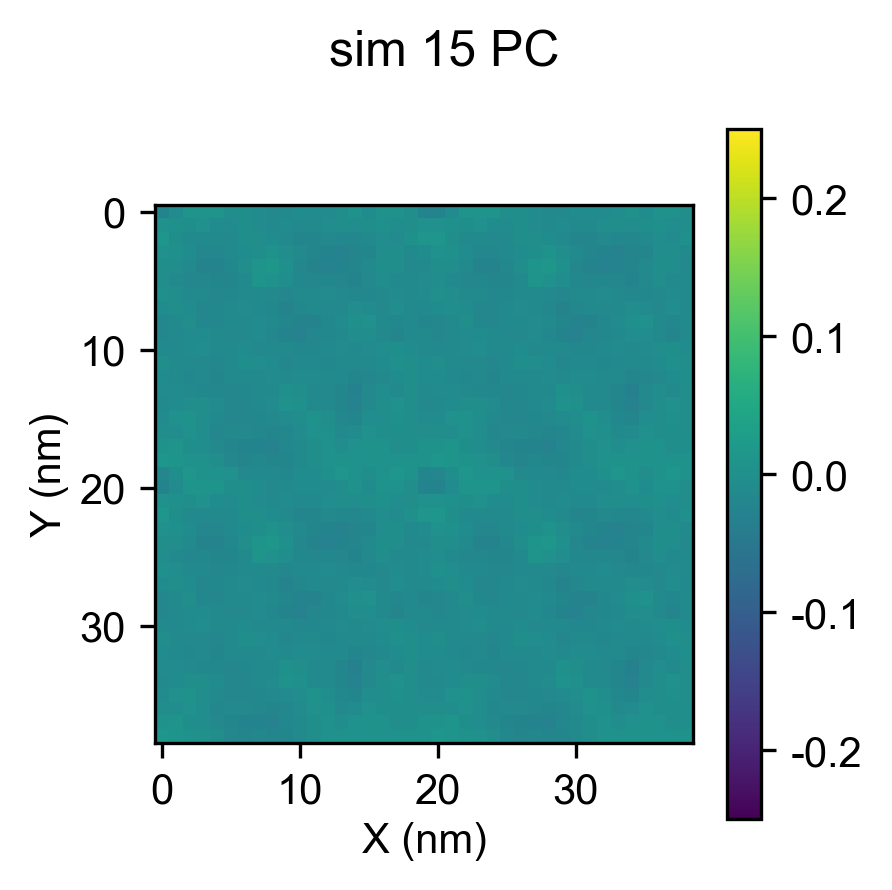

analyzing lipid PE


  0%|          | 0/100 [00:00<?, ?it/s]

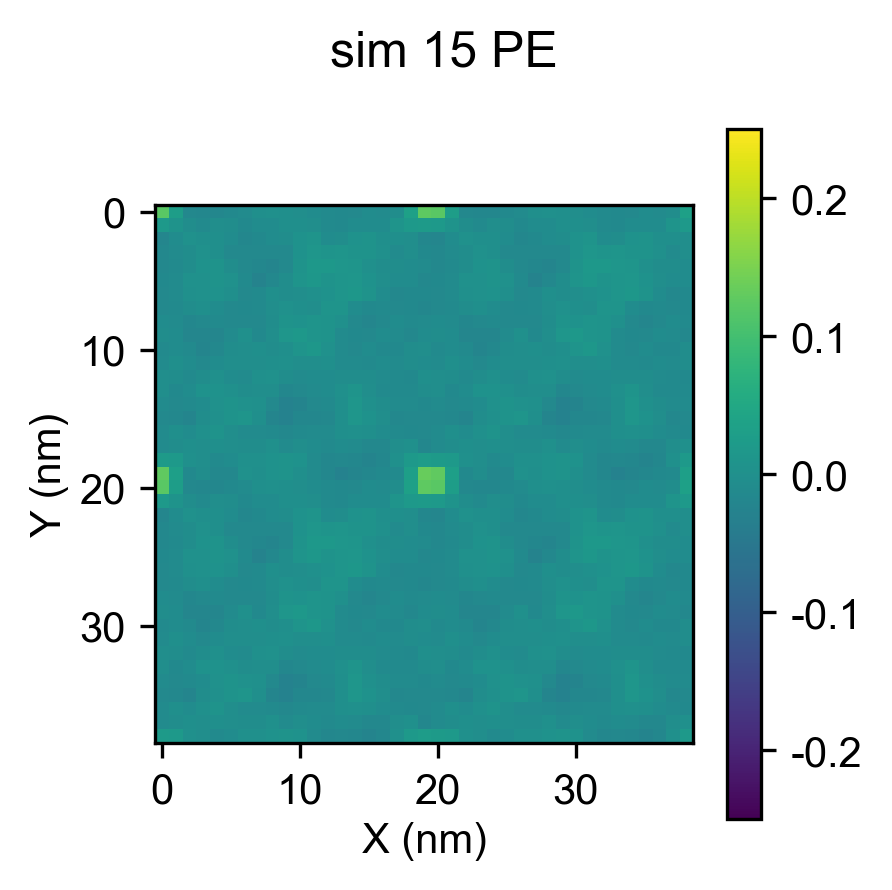

analyzing lipid CDL
analyzing lipid PG


  0%|          | 0/100 [00:00<?, ?it/s]

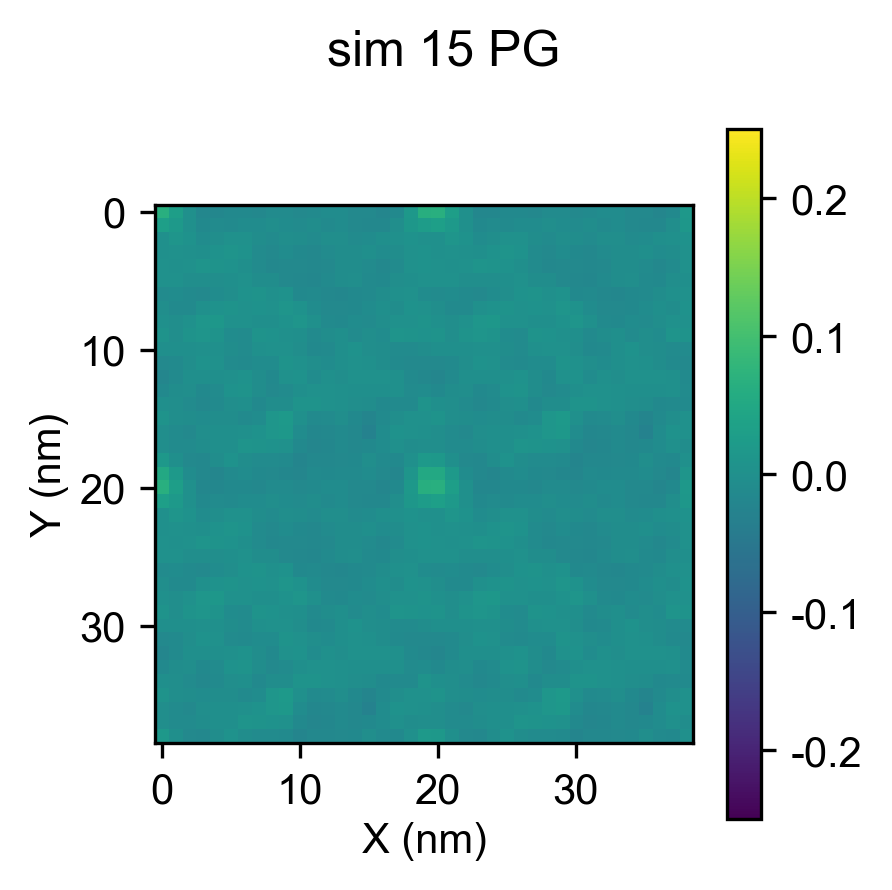

sim 11
analyzing lipid PC


  0%|          | 0/100 [00:00<?, ?it/s]

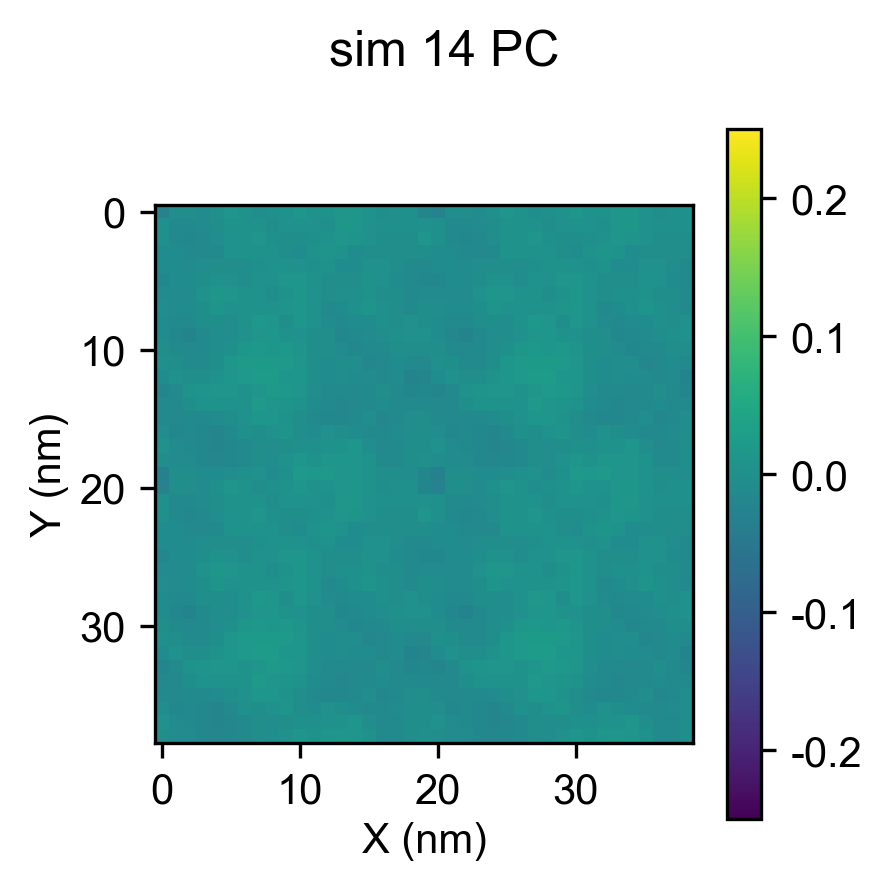

analyzing lipid PE


  0%|          | 0/100 [00:00<?, ?it/s]

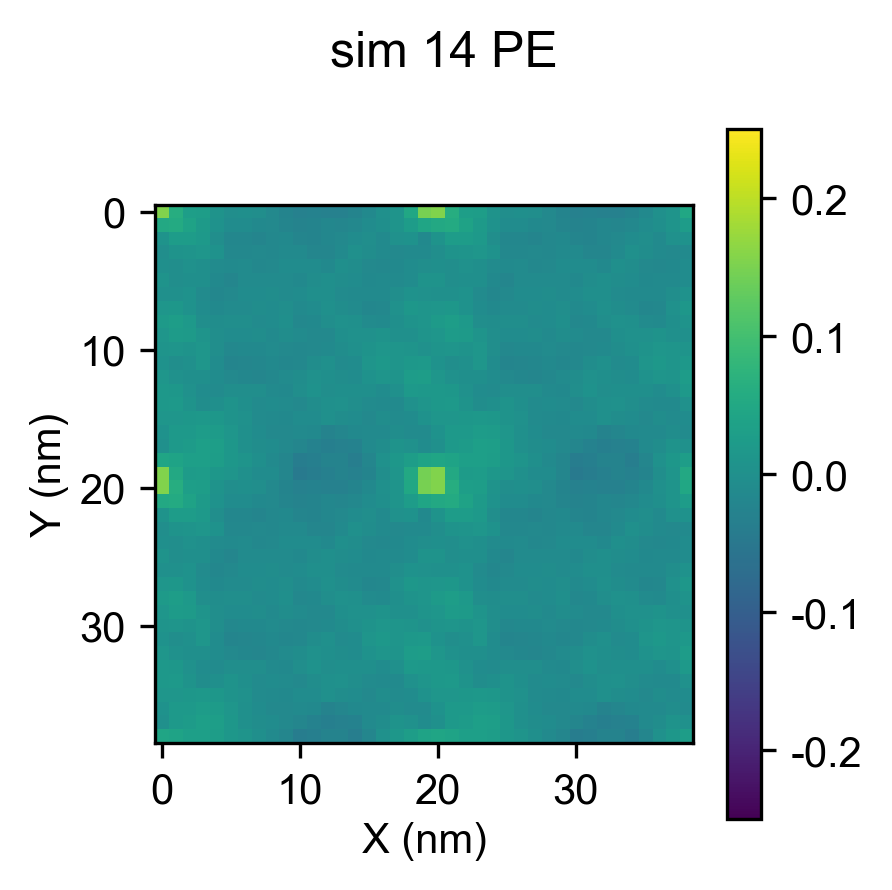

analyzing lipid CDL
analyzing lipid PG


  0%|          | 0/100 [00:00<?, ?it/s]

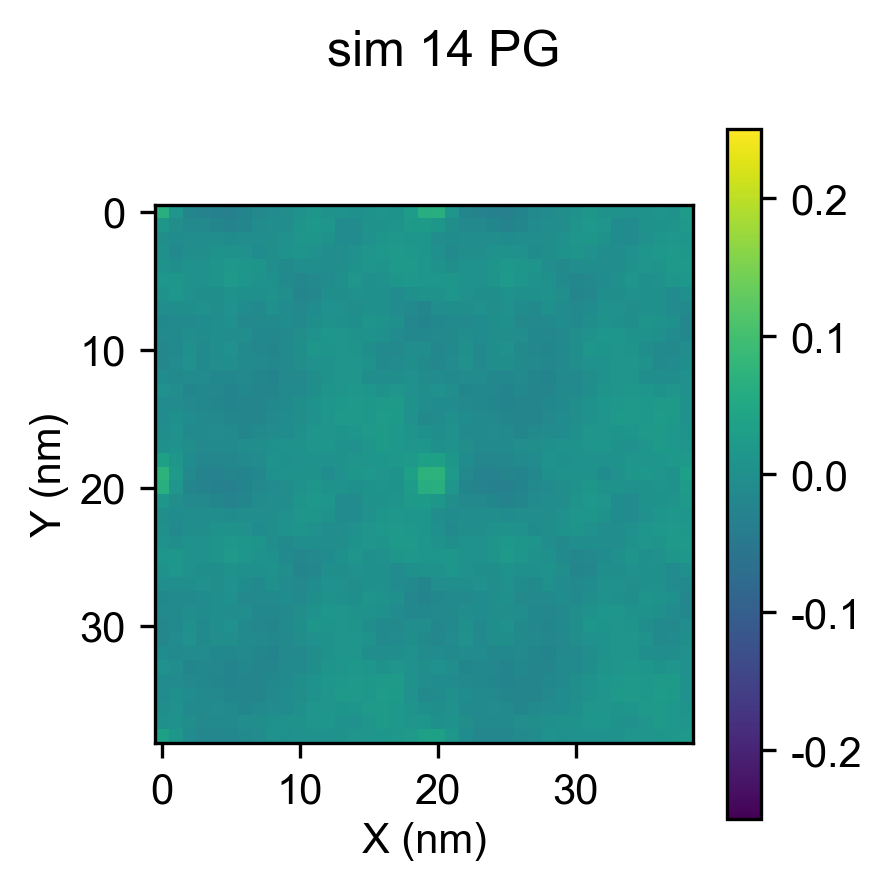

sim 12
analyzing lipid PC


  0%|          | 0/100 [00:00<?, ?it/s]

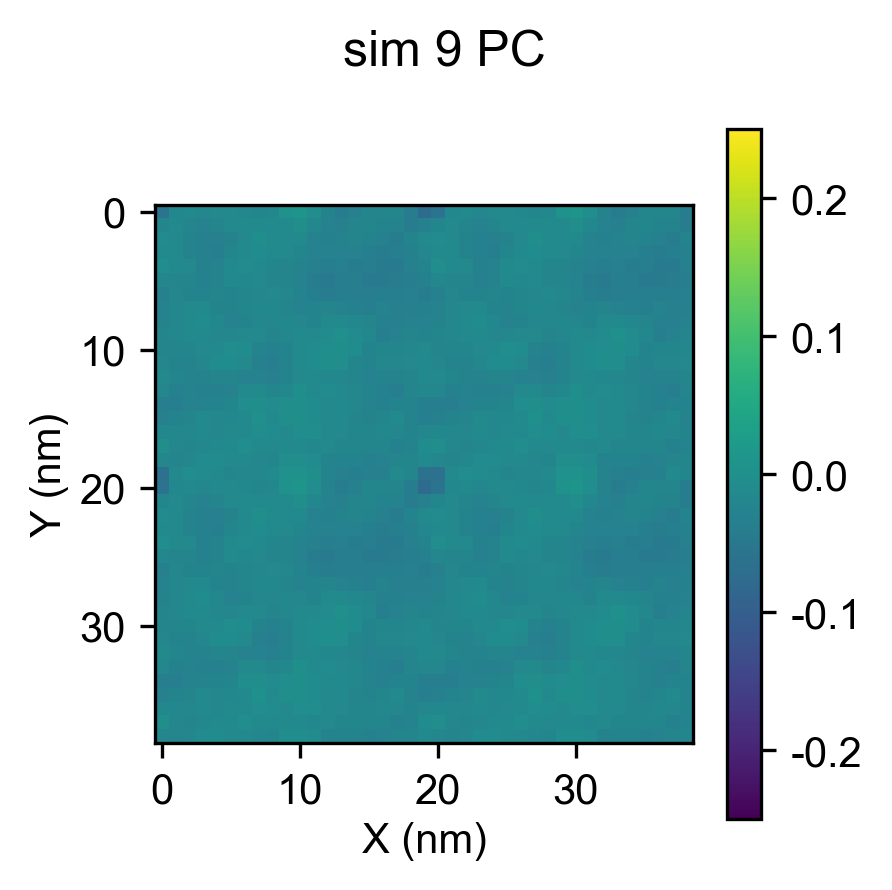

analyzing lipid PE


  0%|          | 0/100 [00:00<?, ?it/s]

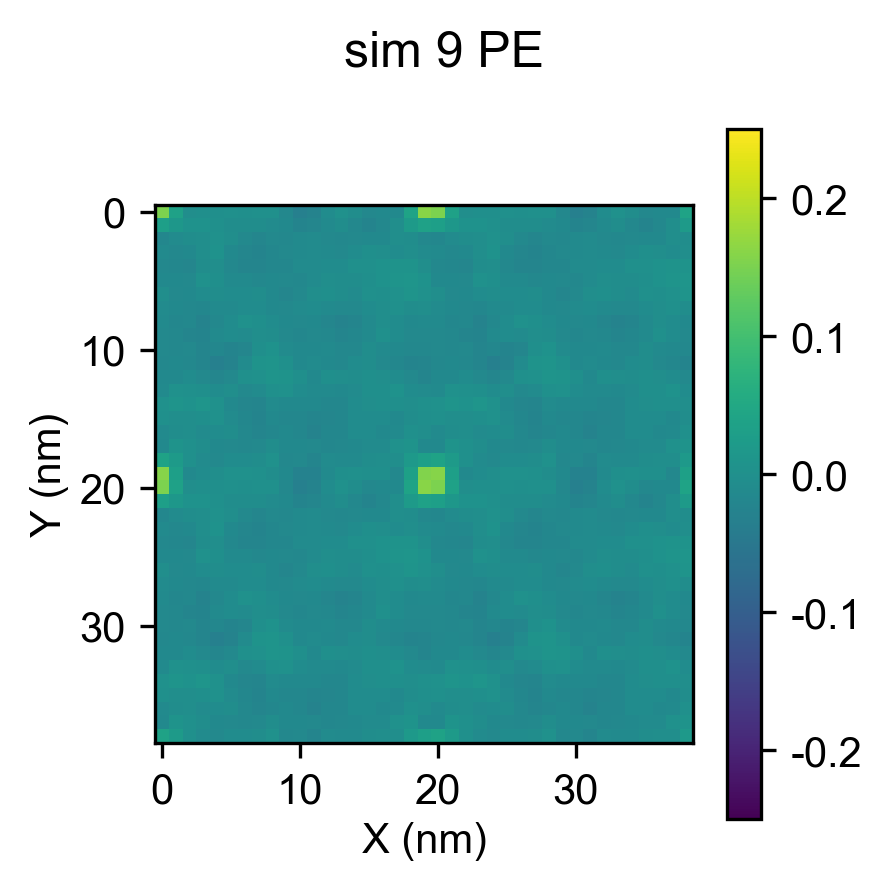

analyzing lipid CDL
analyzing lipid PG


  0%|          | 0/100 [00:00<?, ?it/s]

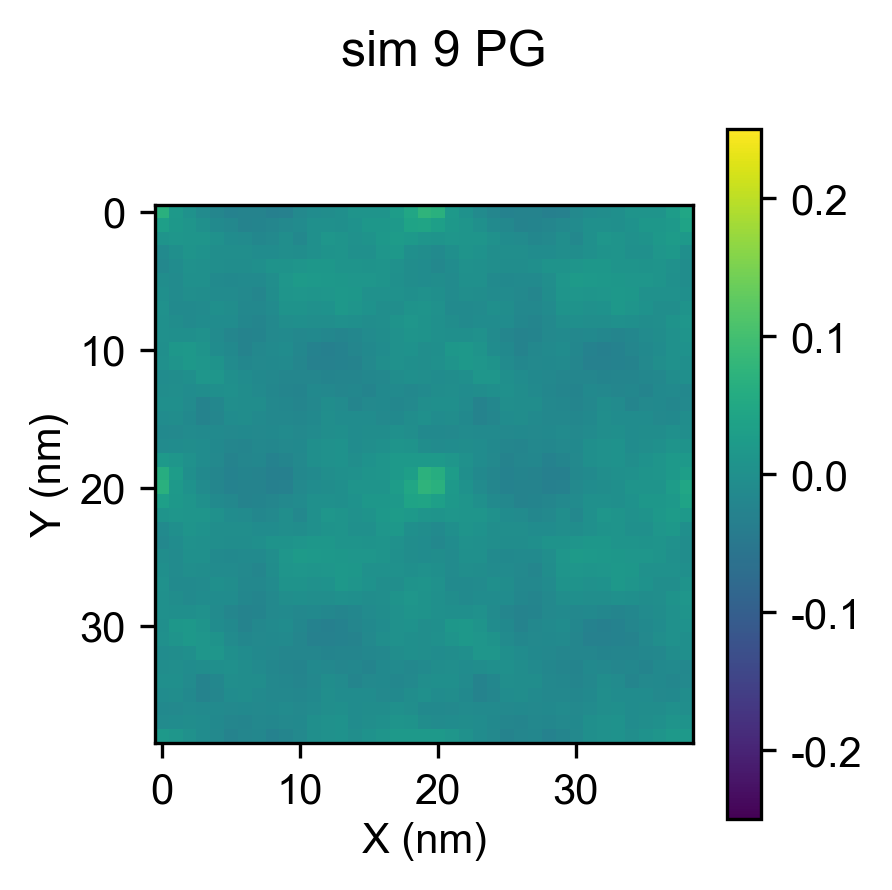

sim 13
analyzing lipid PC


  0%|          | 0/100 [00:00<?, ?it/s]

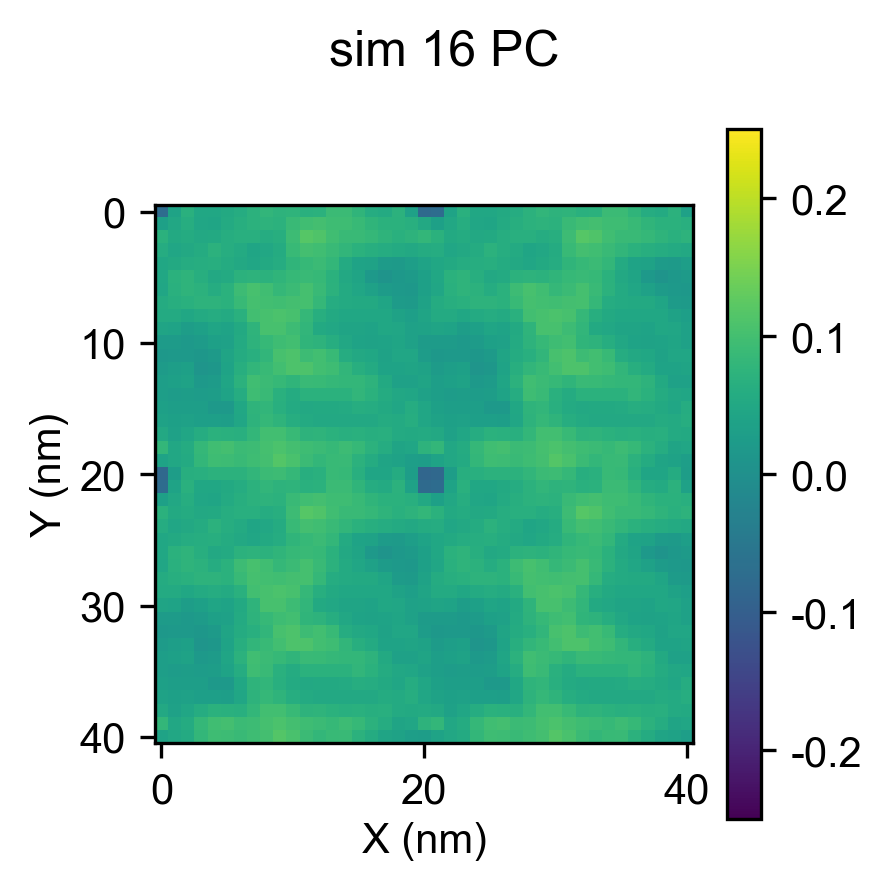

analyzing lipid PE


  0%|          | 0/100 [00:00<?, ?it/s]

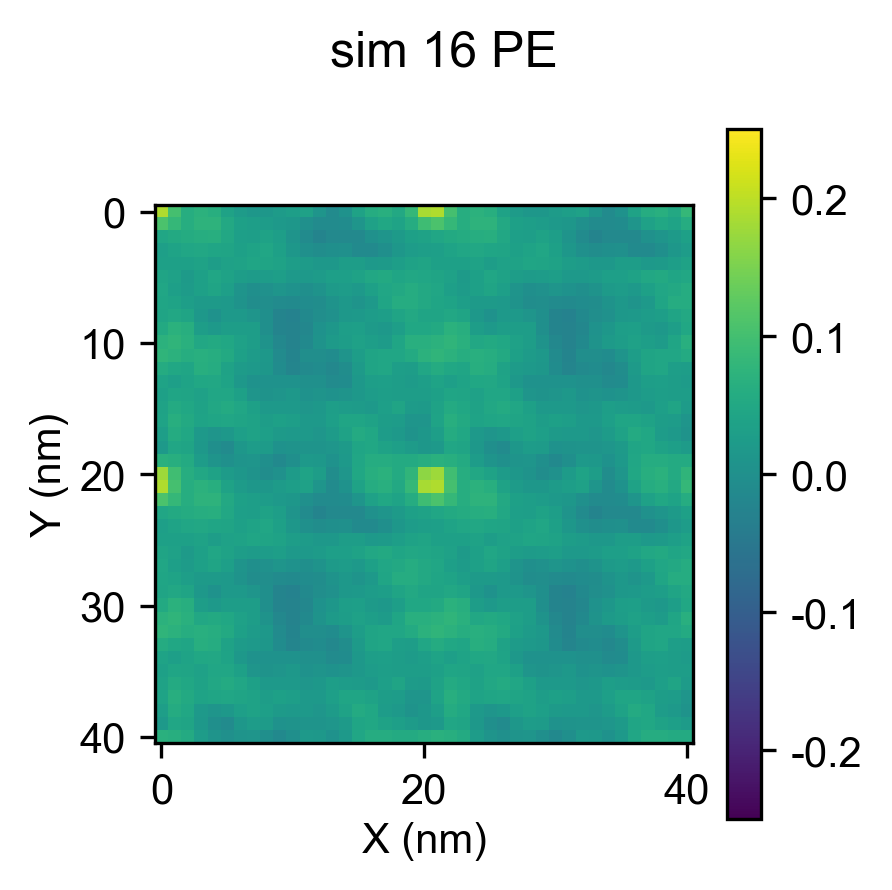

analyzing lipid CDL


  0%|          | 0/100 [00:00<?, ?it/s]

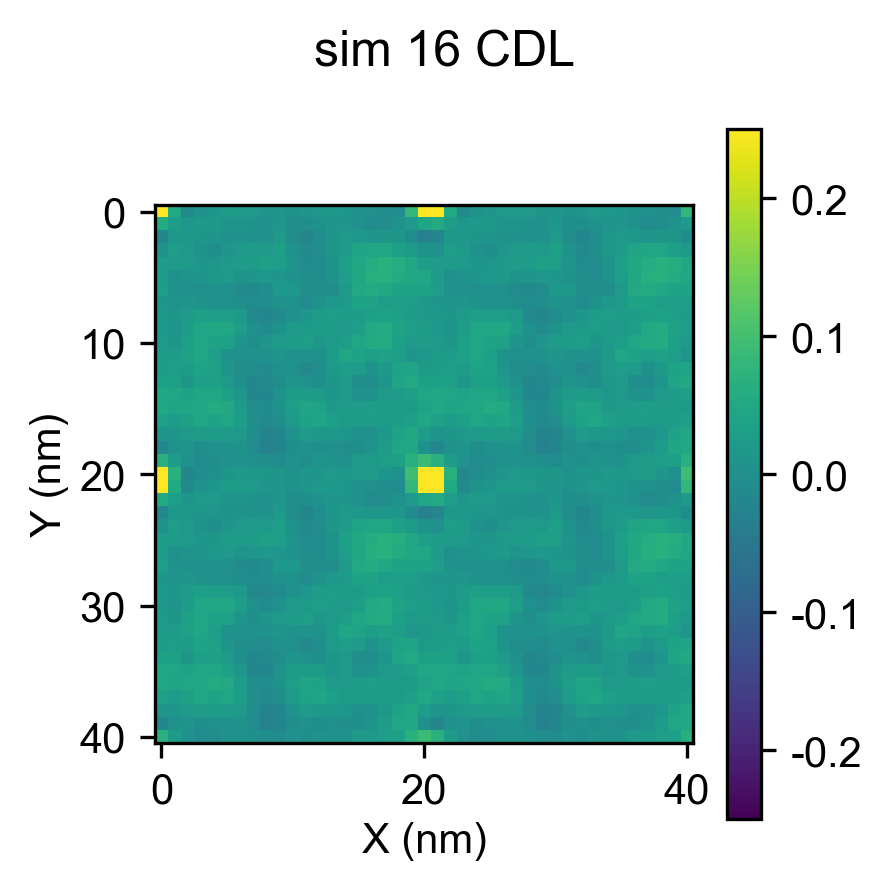

analyzing lipid PG
sim 14
analyzing lipid PC


  0%|          | 0/100 [00:00<?, ?it/s]

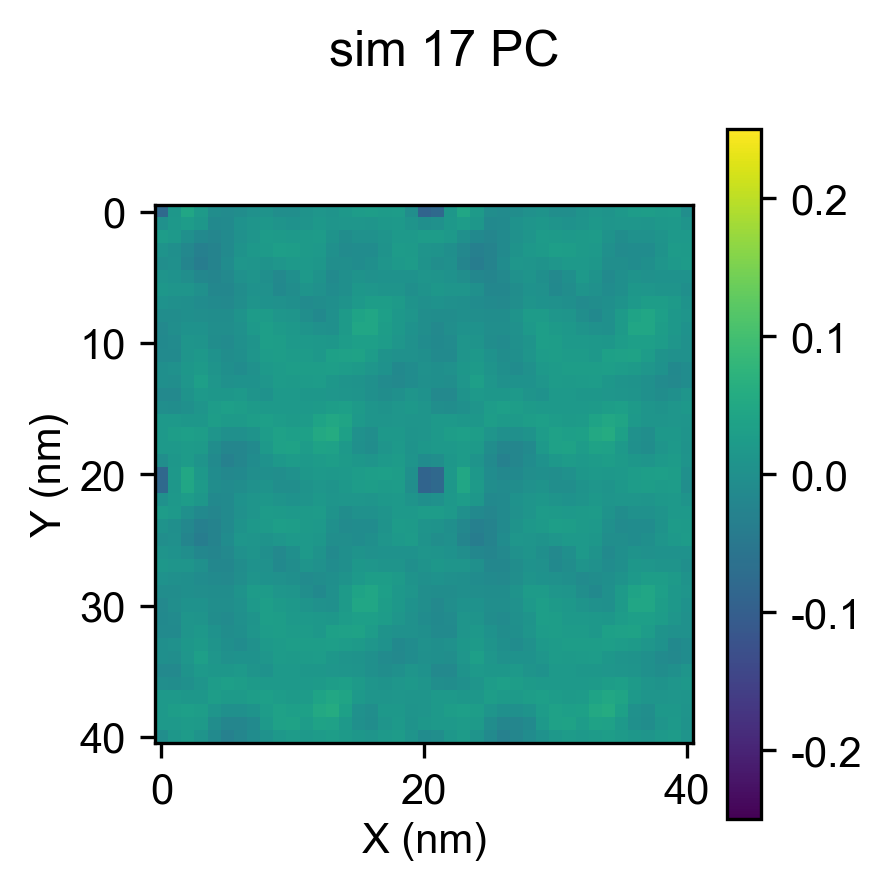

analyzing lipid PE


  0%|          | 0/100 [00:00<?, ?it/s]

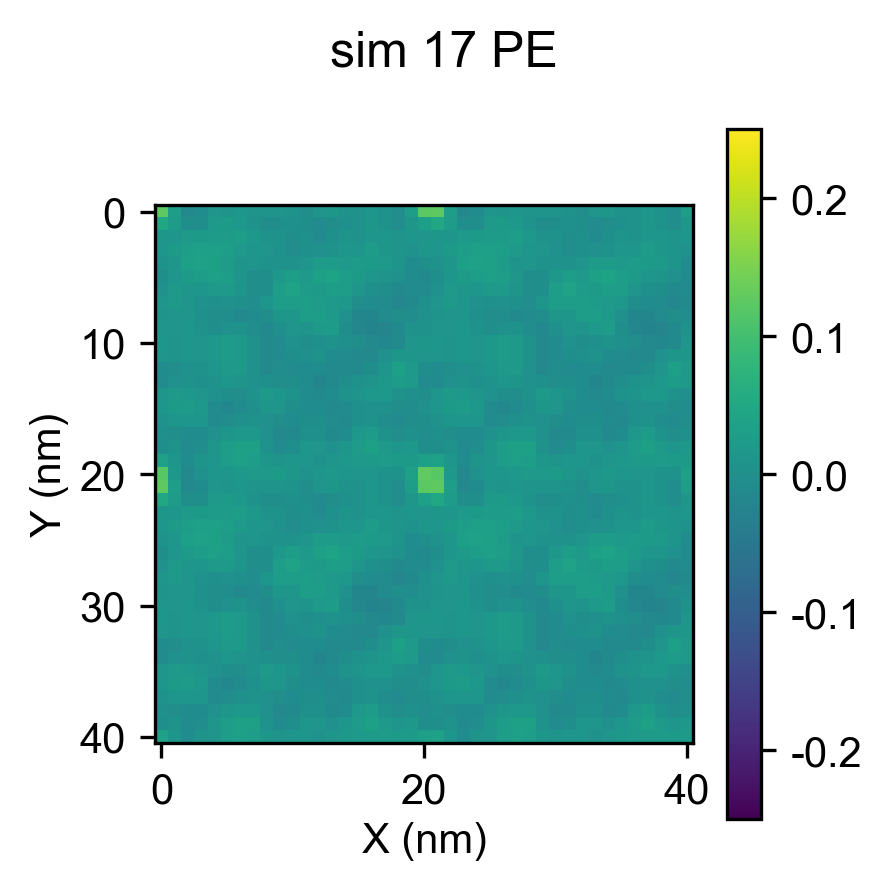

analyzing lipid CDL


  0%|          | 0/100 [00:00<?, ?it/s]

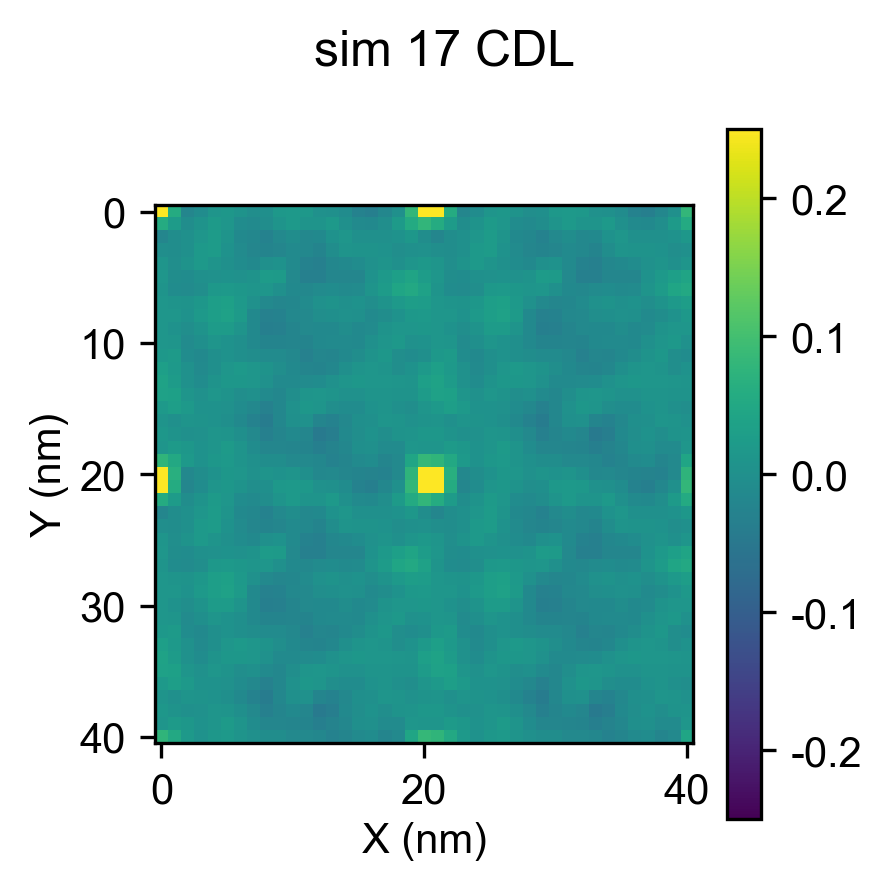

analyzing lipid PG
sim 15
analyzing lipid PC


  0%|          | 0/100 [00:00<?, ?it/s]

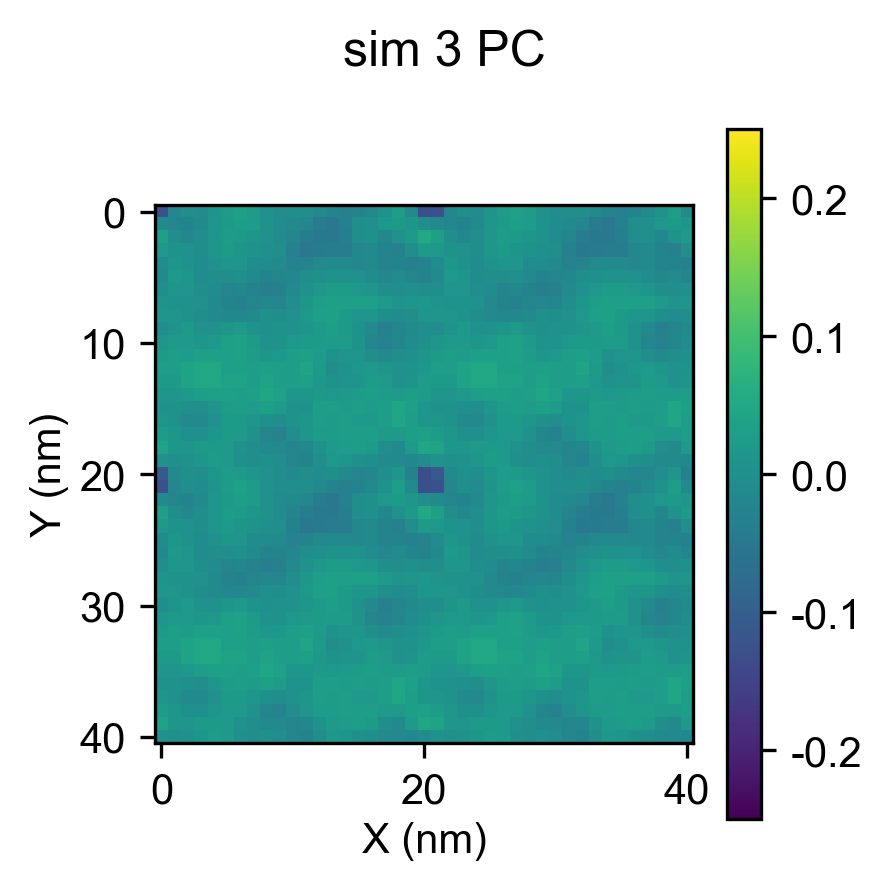

analyzing lipid PE


  0%|          | 0/100 [00:00<?, ?it/s]

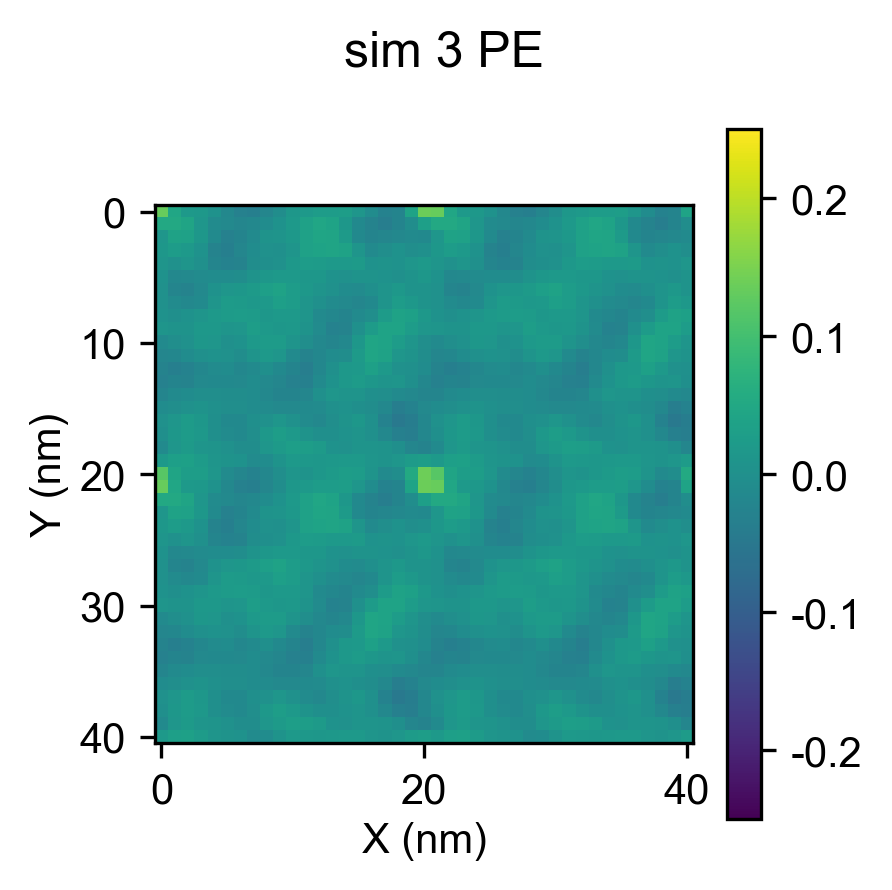

analyzing lipid CDL


  0%|          | 0/100 [00:00<?, ?it/s]

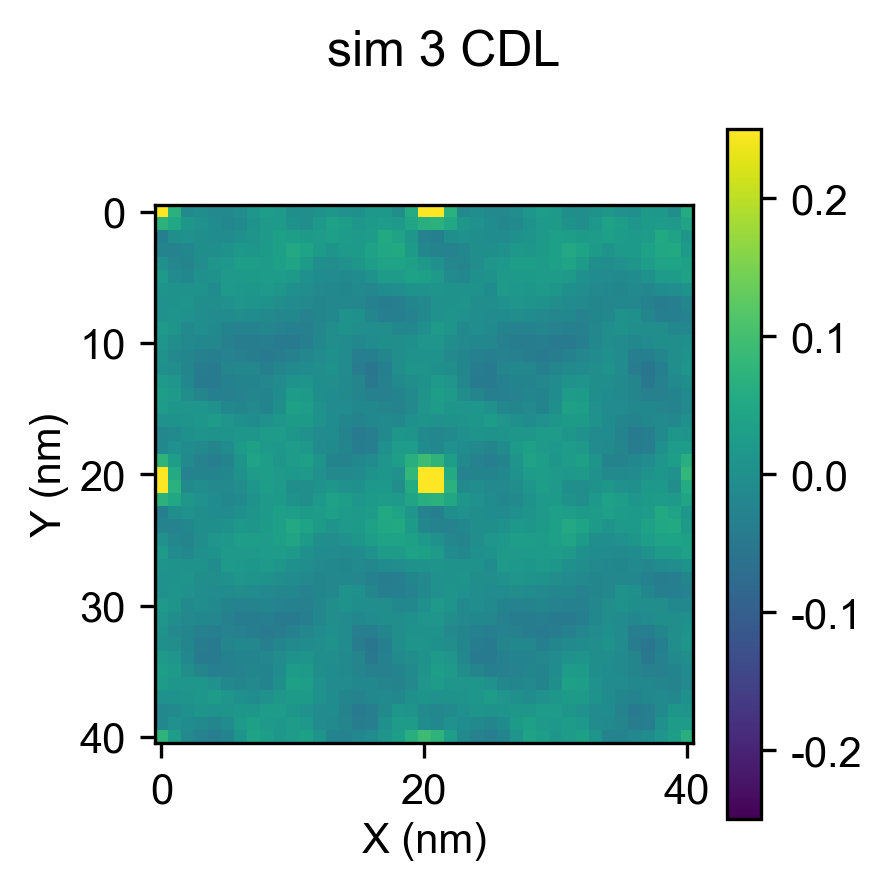

analyzing lipid PG
sim 16
analyzing lipid PC


  0%|          | 0/100 [00:00<?, ?it/s]

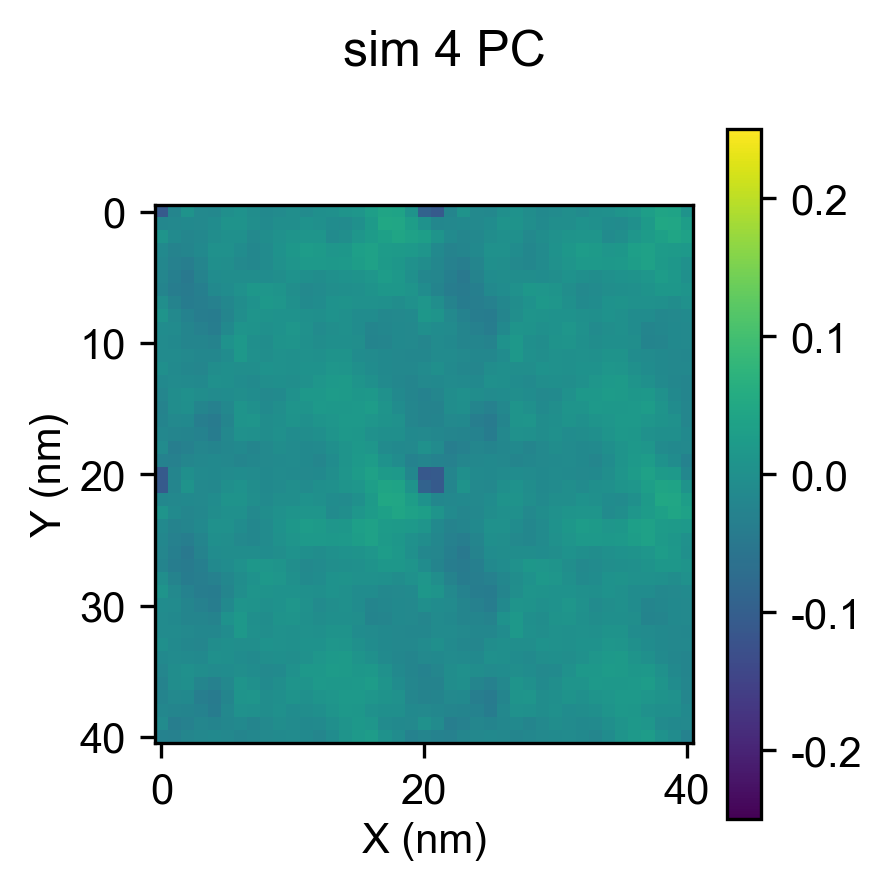

analyzing lipid PE


  0%|          | 0/100 [00:00<?, ?it/s]

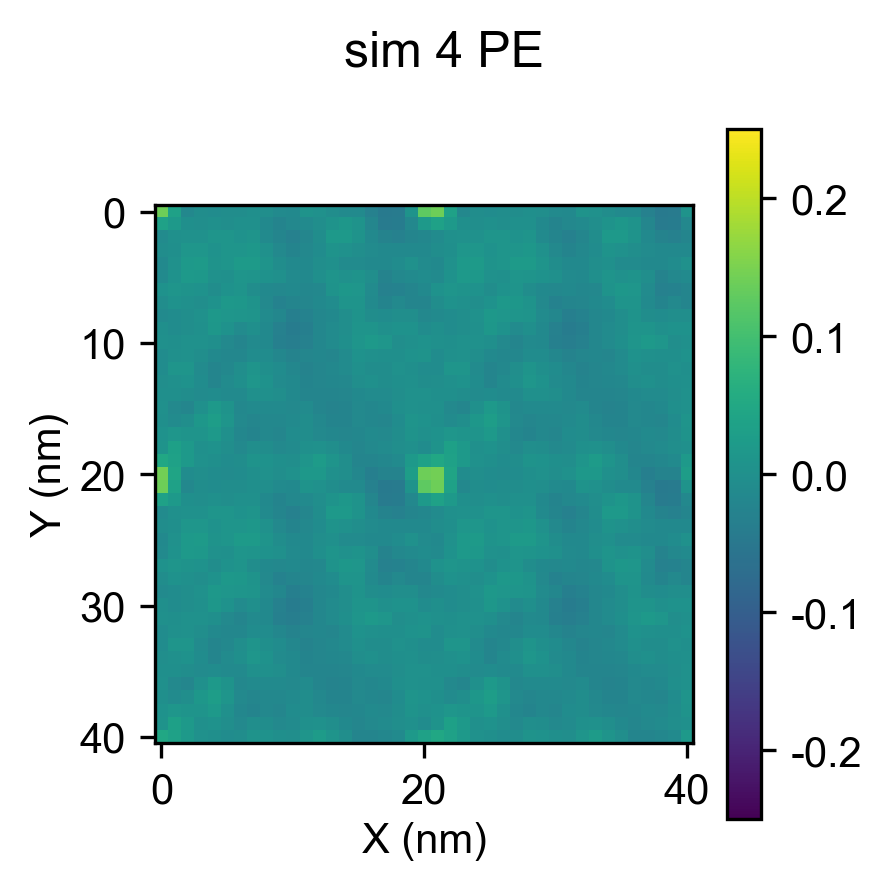

analyzing lipid CDL


  0%|          | 0/100 [00:00<?, ?it/s]

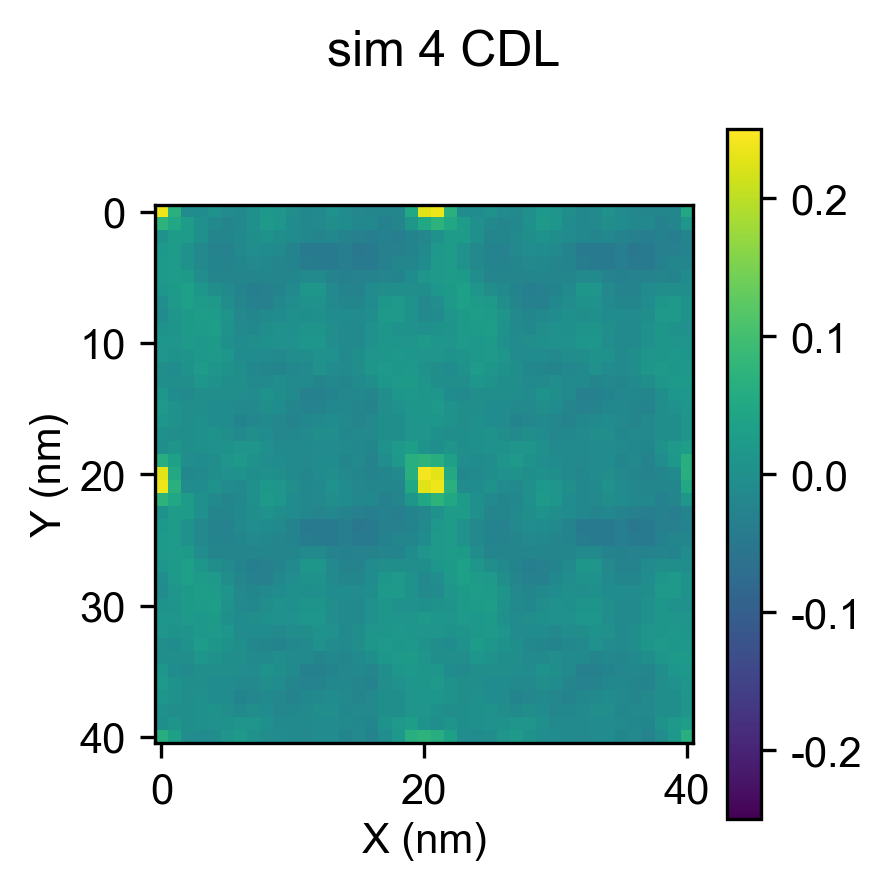

analyzing lipid PG
sim 17
analyzing lipid PC


  0%|          | 0/100 [00:00<?, ?it/s]

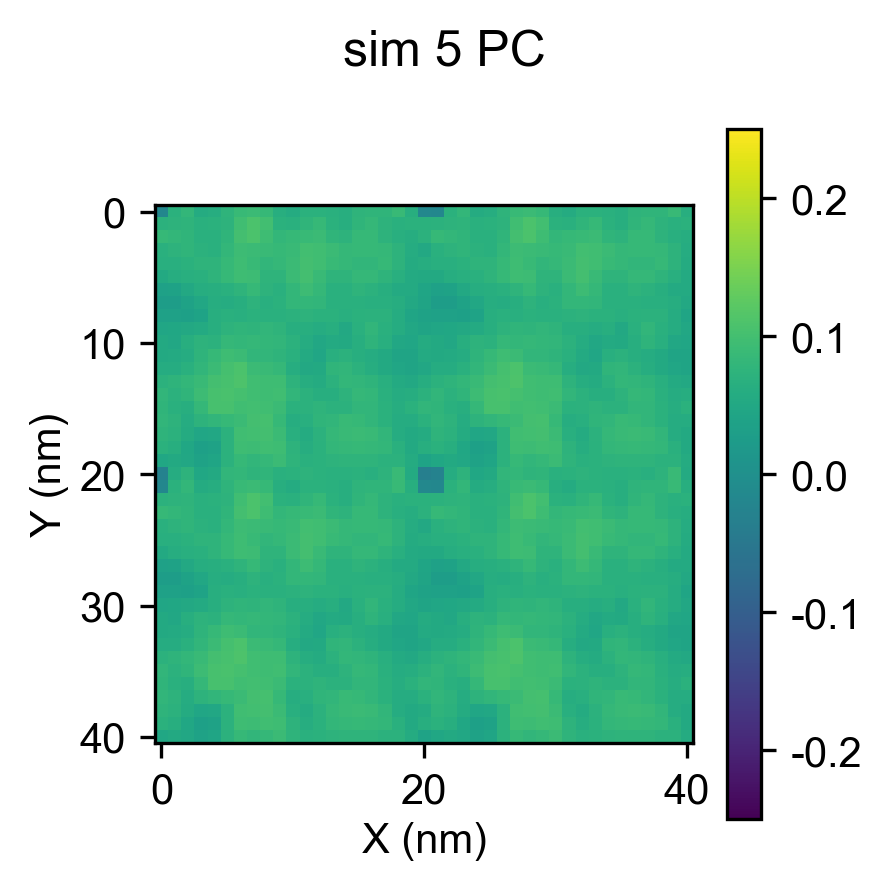

analyzing lipid PE


  0%|          | 0/100 [00:00<?, ?it/s]

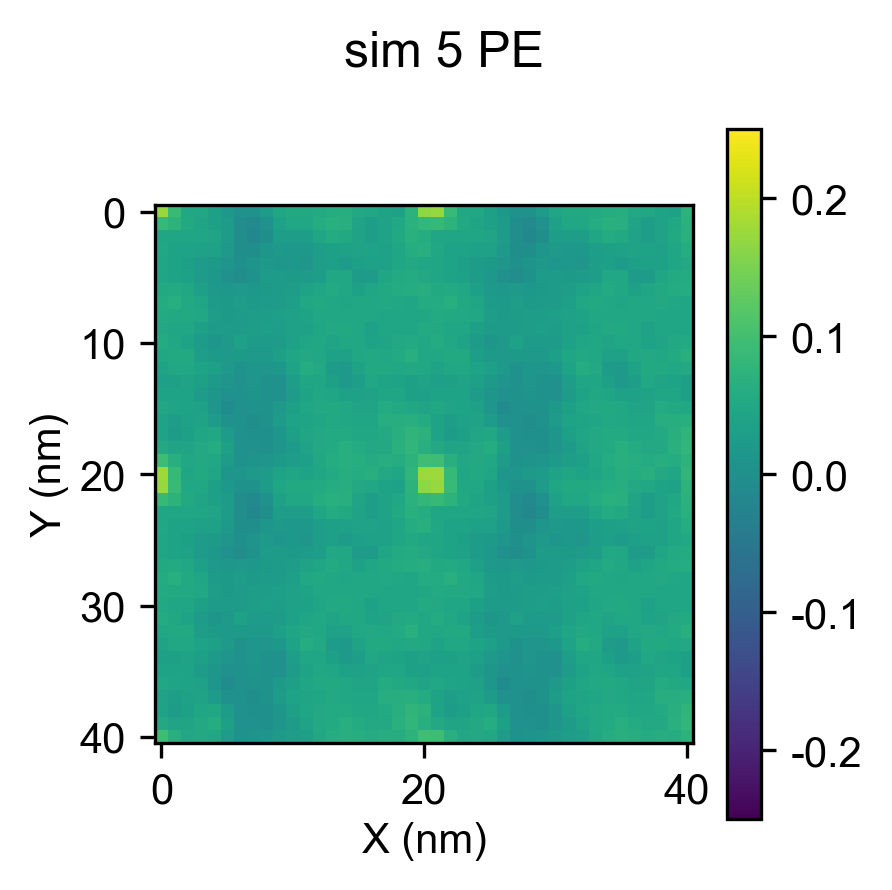

analyzing lipid CDL


  0%|          | 0/100 [00:00<?, ?it/s]

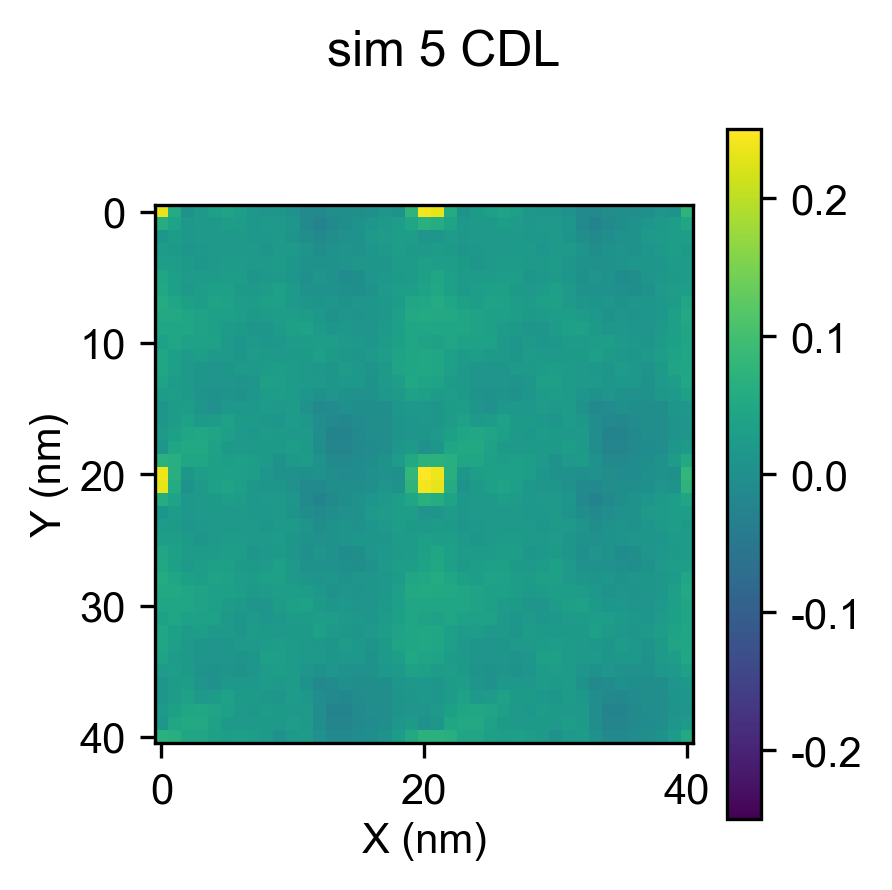

analyzing lipid PG
sim 18
analyzing lipid PC


  0%|          | 0/100 [00:00<?, ?it/s]

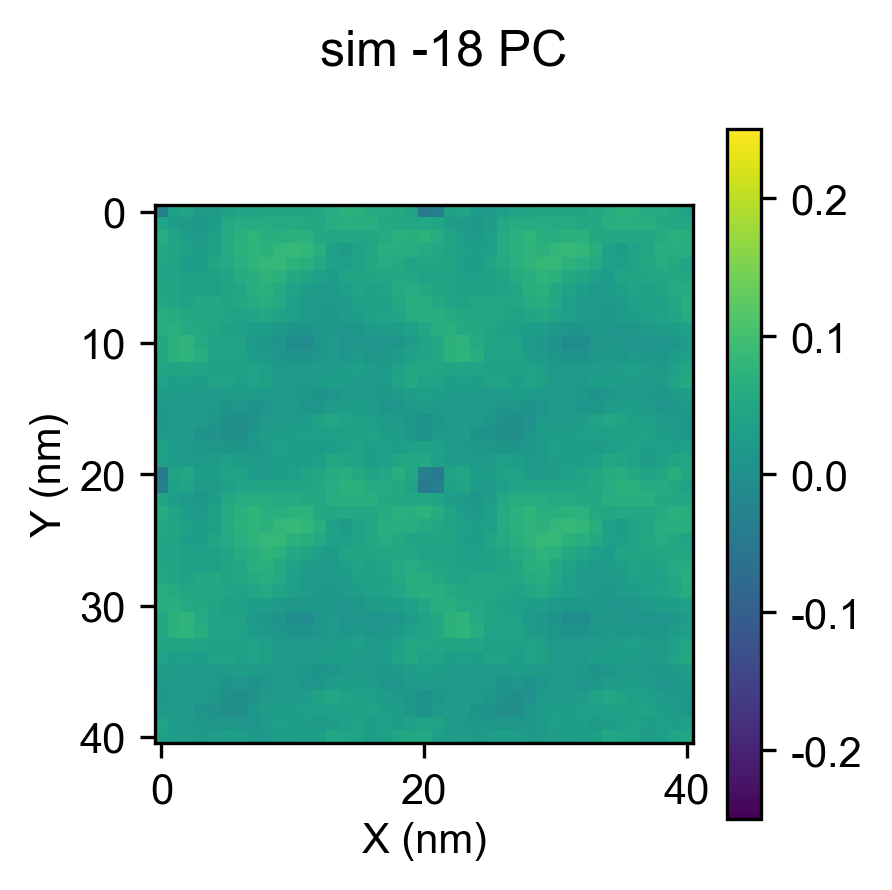

analyzing lipid PE


  0%|          | 0/100 [00:00<?, ?it/s]

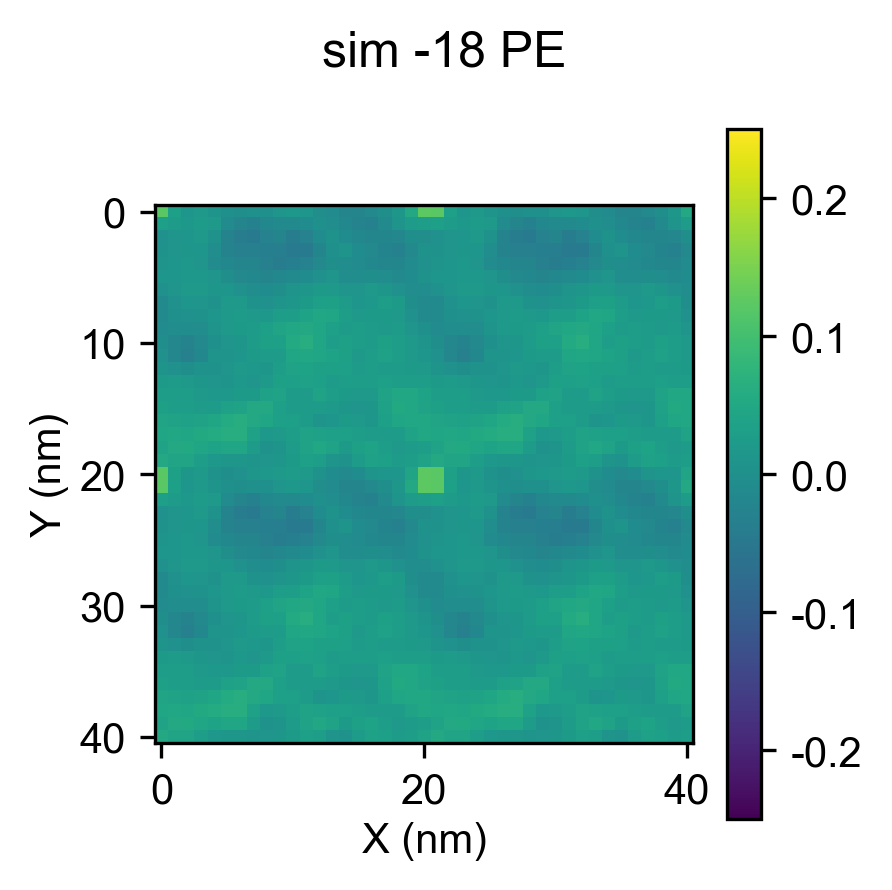

analyzing lipid CDL


  0%|          | 0/100 [00:00<?, ?it/s]

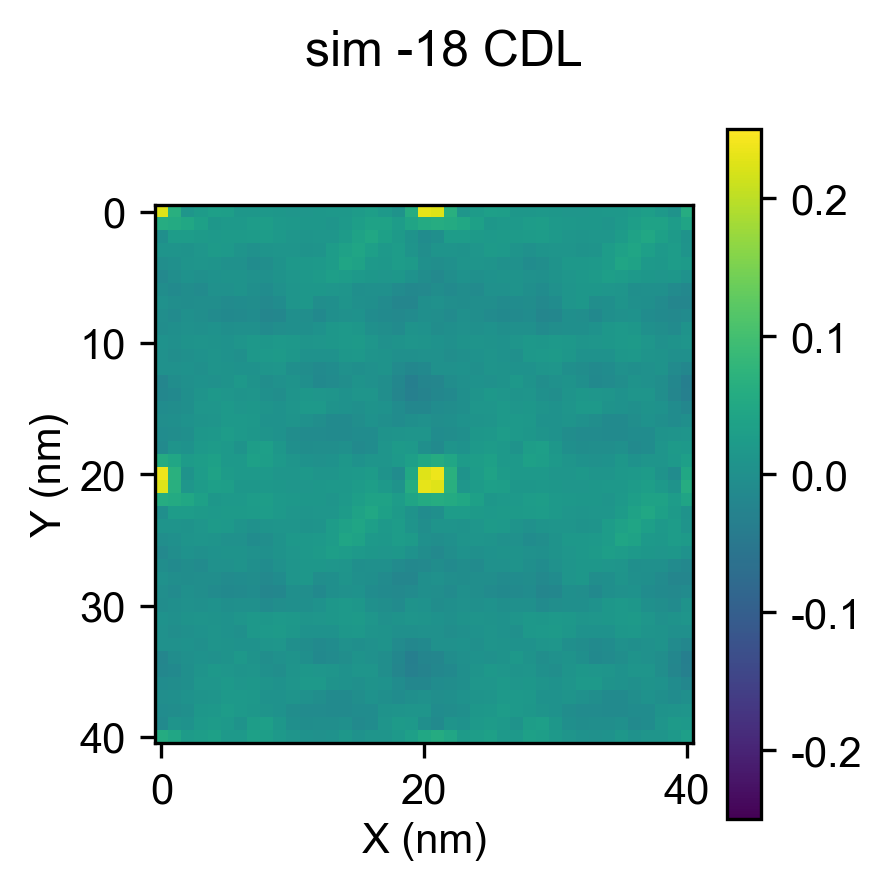

analyzing lipid PG
sim 19
analyzing lipid PC
analyzing lipid PE
analyzing lipid CDL


  0%|          | 0/100 [00:00<?, ?it/s]

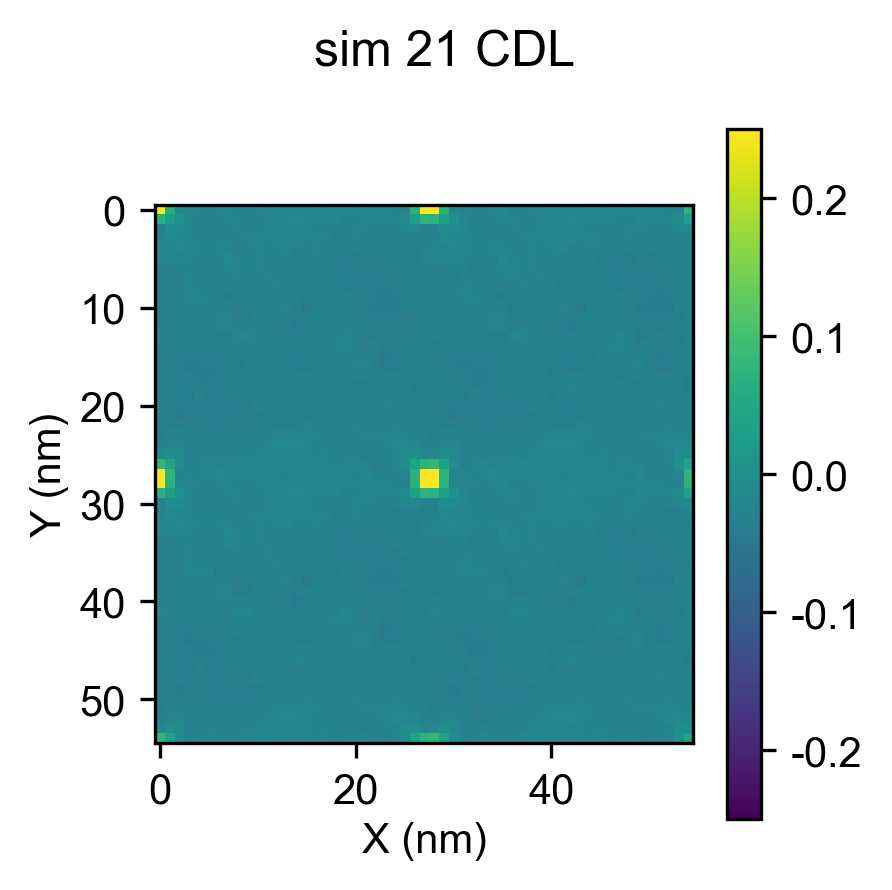

analyzing lipid PG
sim 20
analyzing lipid PC


  0%|          | 0/100 [00:00<?, ?it/s]

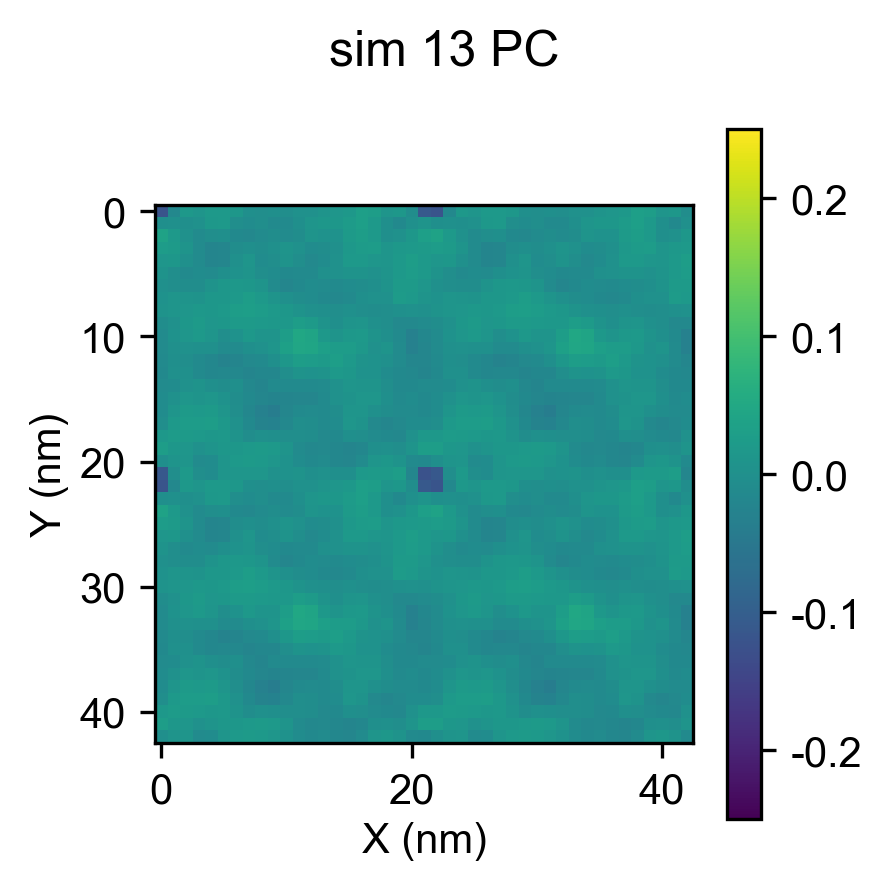

analyzing lipid PE


  0%|          | 0/100 [00:00<?, ?it/s]

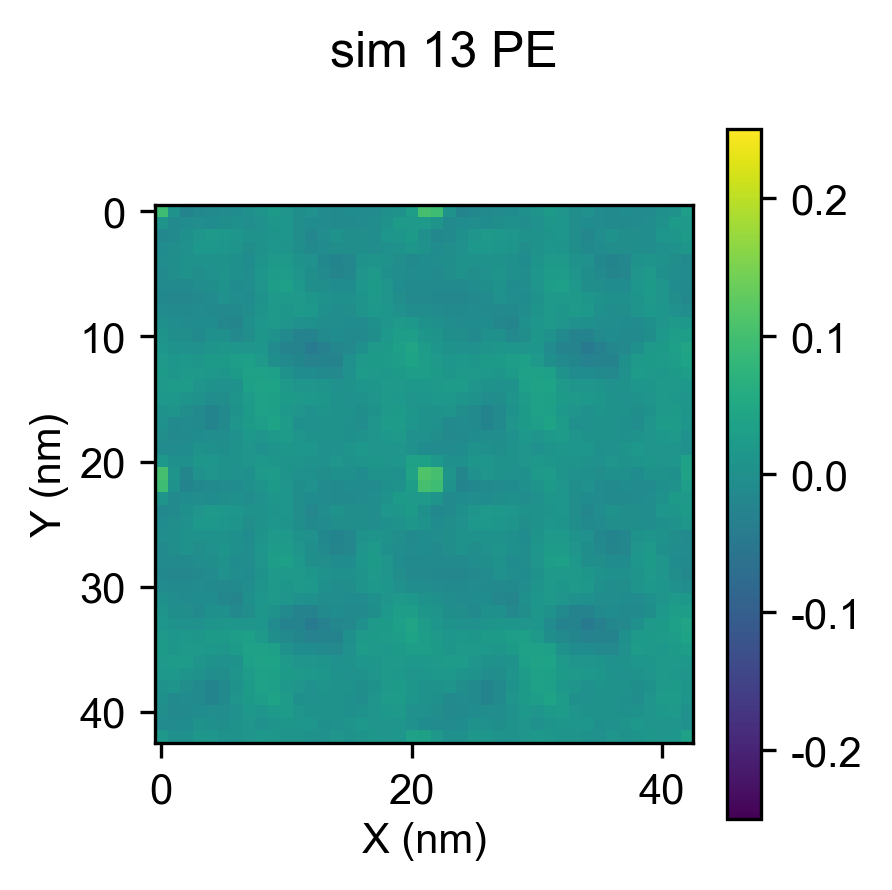

analyzing lipid CDL


  0%|          | 0/100 [00:00<?, ?it/s]

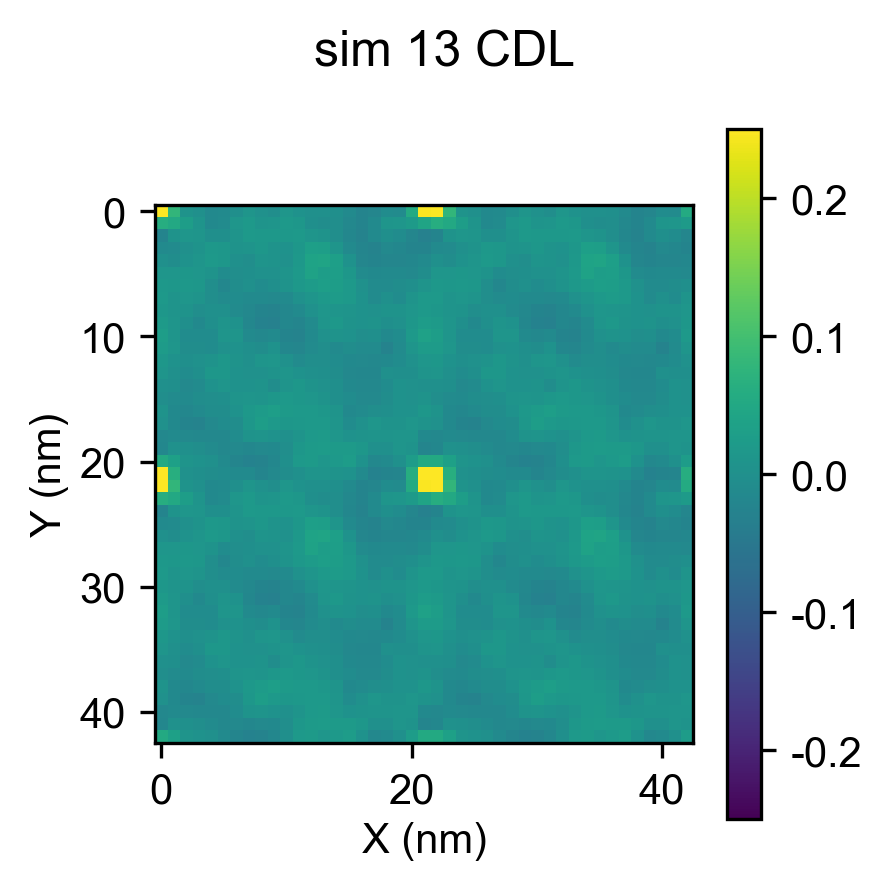

analyzing lipid PG
sim 21
analyzing lipid PC


  0%|          | 0/100 [00:00<?, ?it/s]

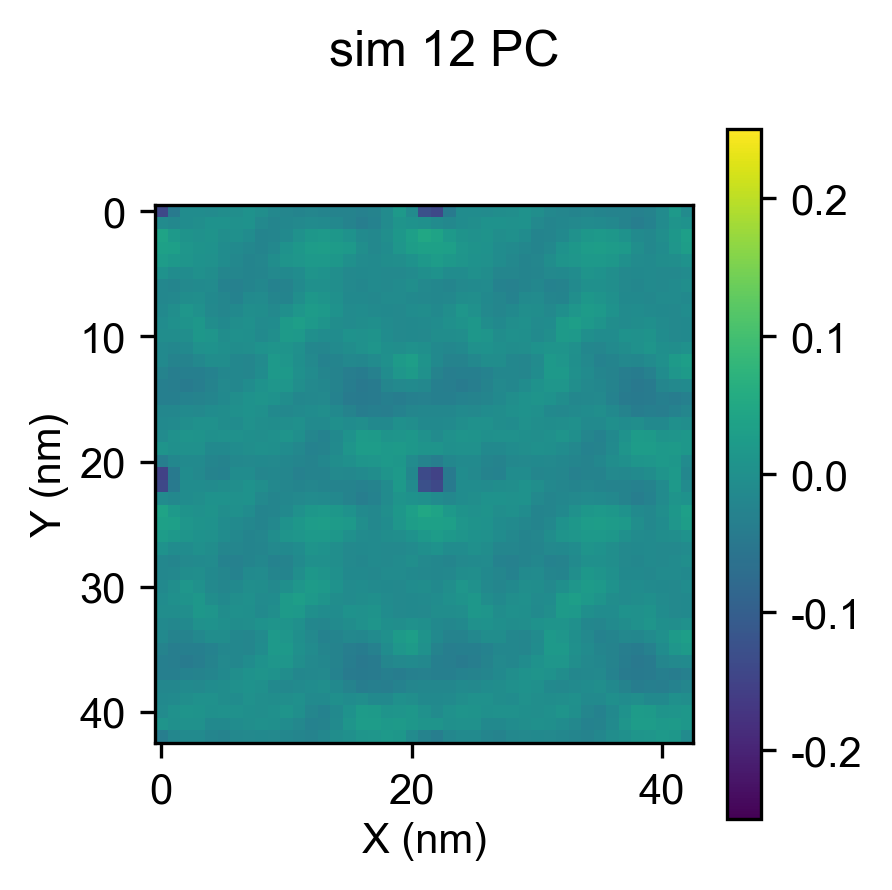

analyzing lipid PE


  0%|          | 0/100 [00:00<?, ?it/s]

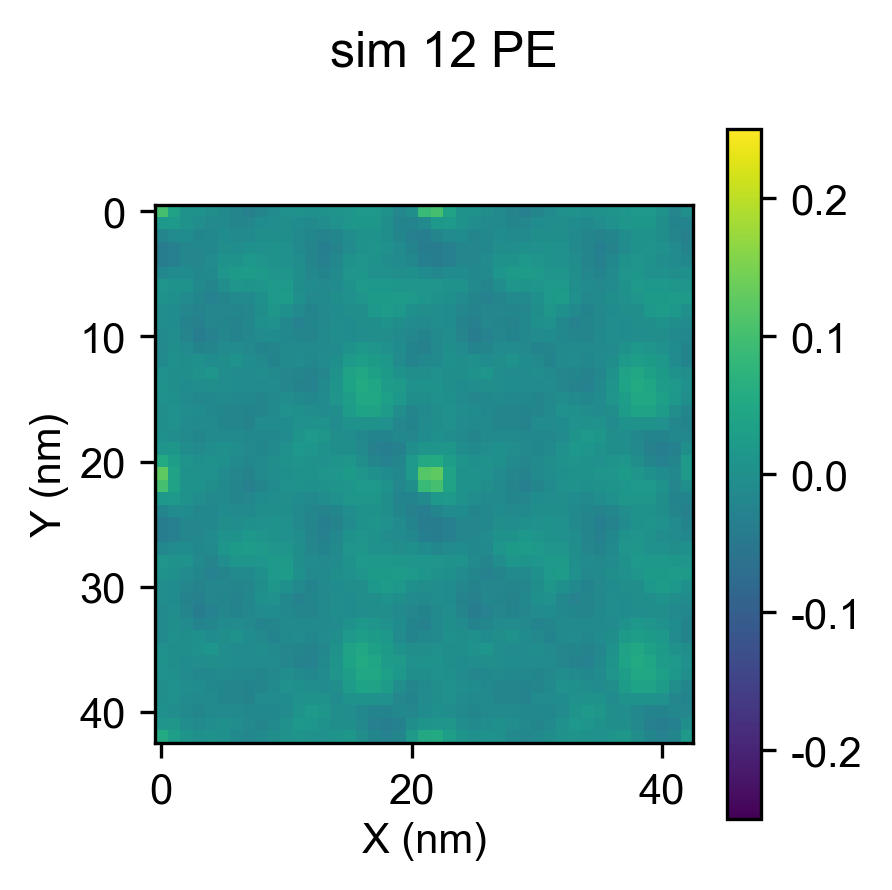

analyzing lipid CDL


  0%|          | 0/100 [00:00<?, ?it/s]

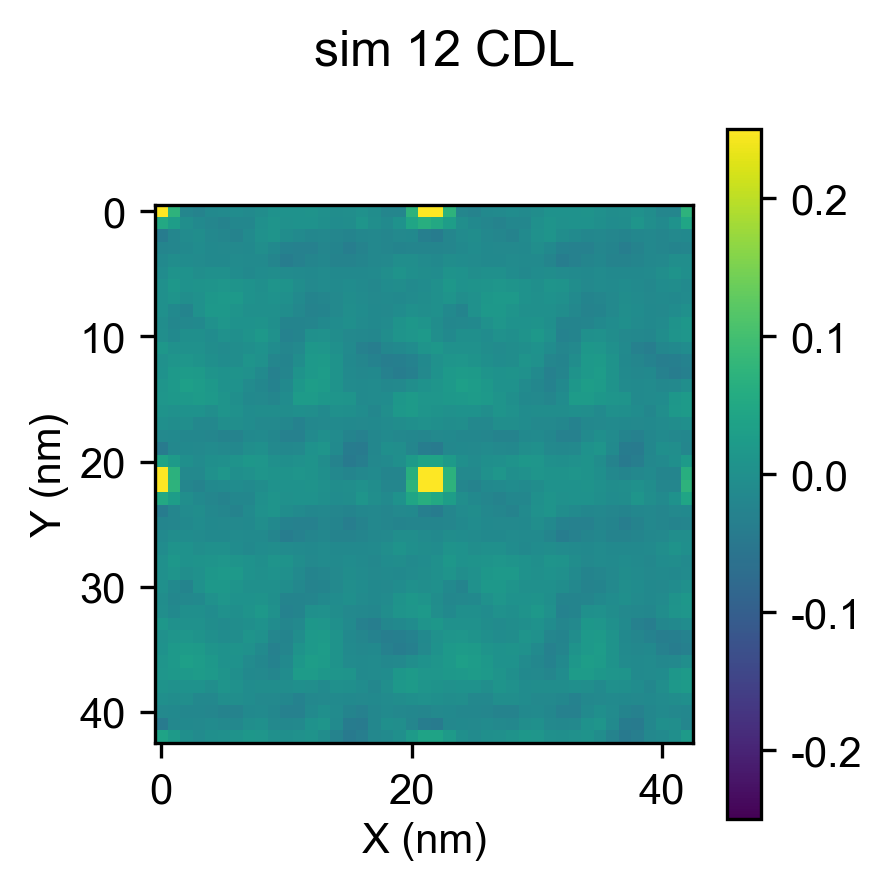

analyzing lipid PG
sim 22
analyzing lipid PC


  0%|          | 0/100 [00:00<?, ?it/s]

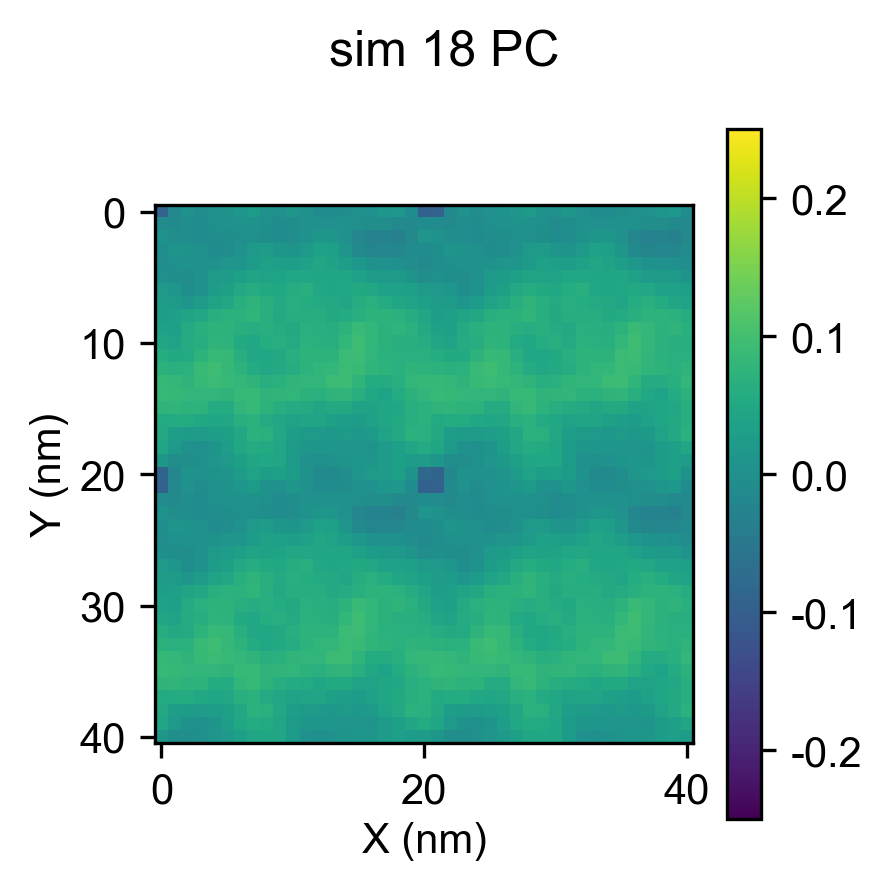

analyzing lipid PE


  0%|          | 0/100 [00:00<?, ?it/s]

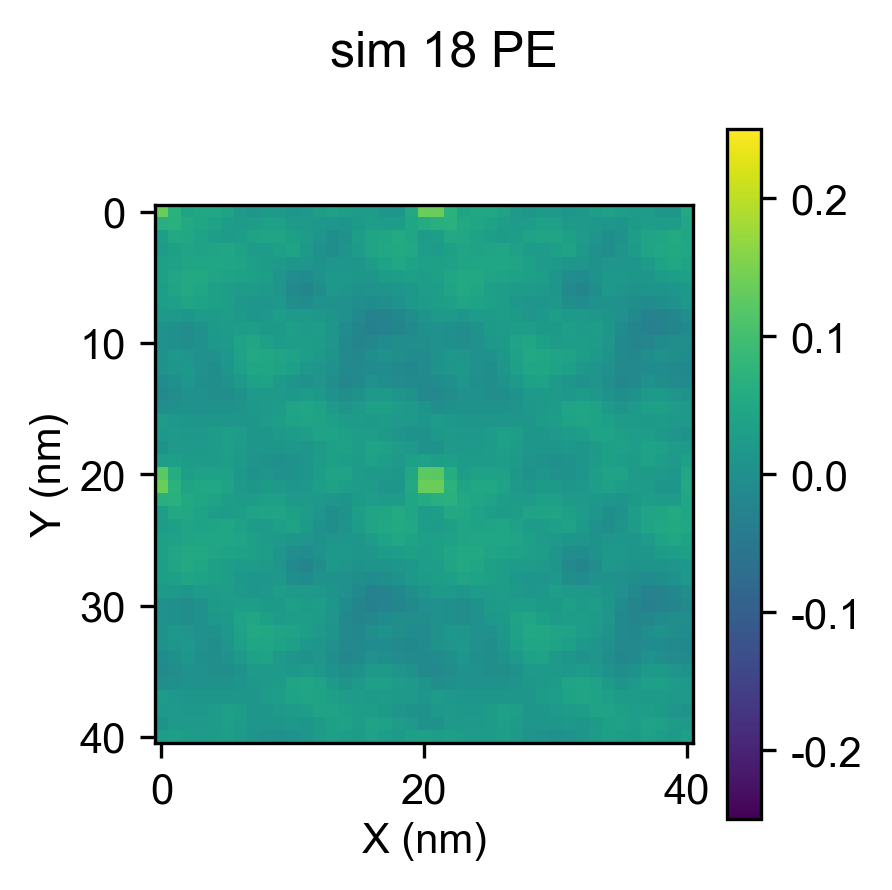

analyzing lipid CDL


  0%|          | 0/100 [00:00<?, ?it/s]

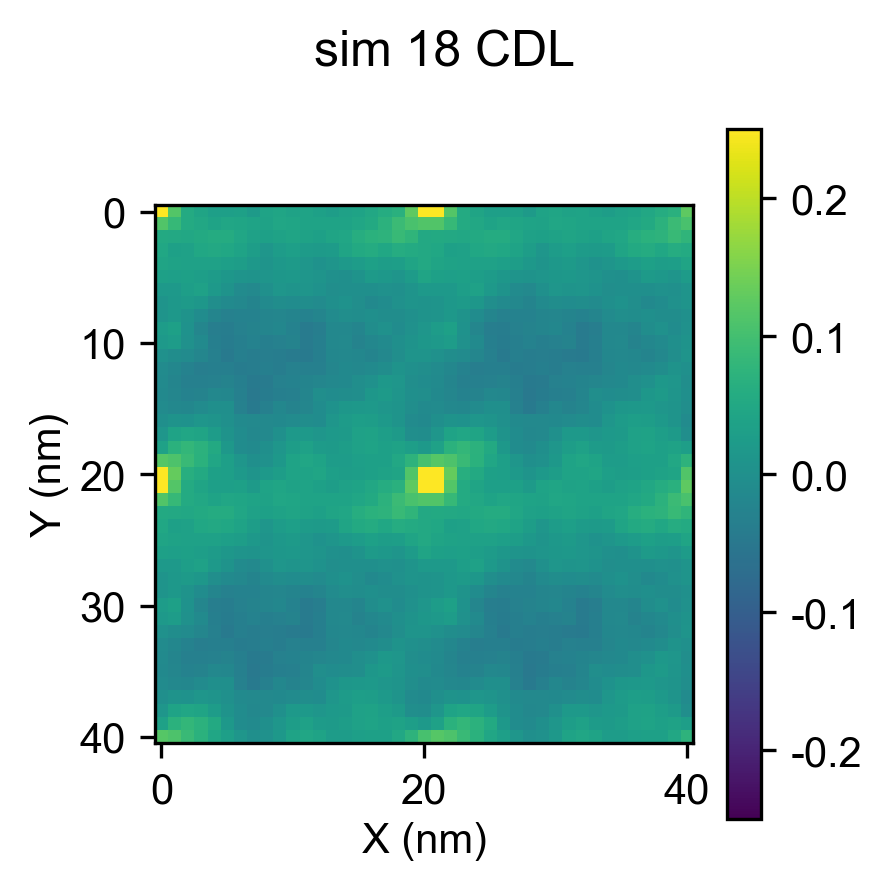

analyzing lipid PG
sim 23
analyzing lipid PC


  0%|          | 0/100 [00:00<?, ?it/s]

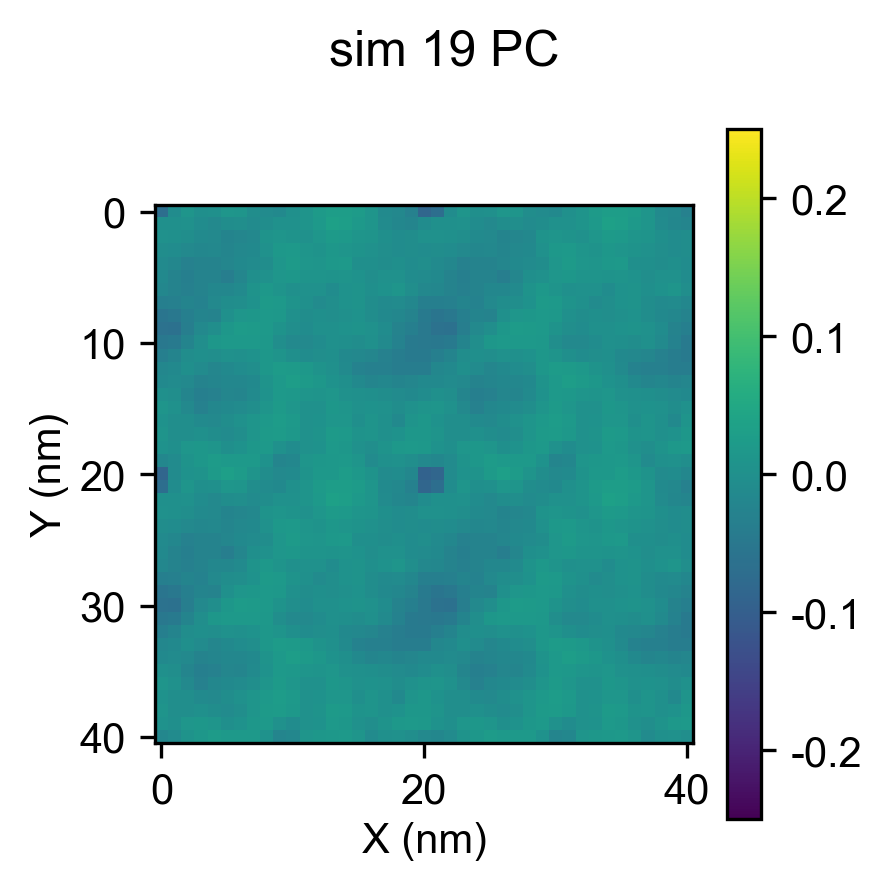

analyzing lipid PE


  0%|          | 0/100 [00:00<?, ?it/s]

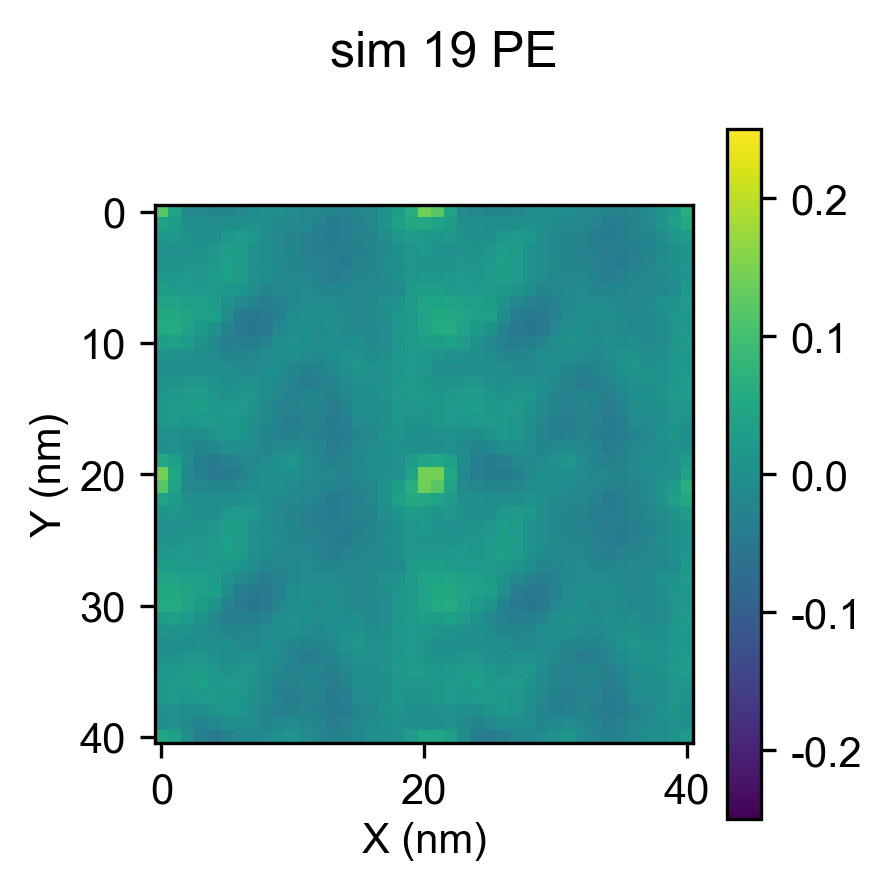

analyzing lipid CDL


  0%|          | 0/100 [00:00<?, ?it/s]

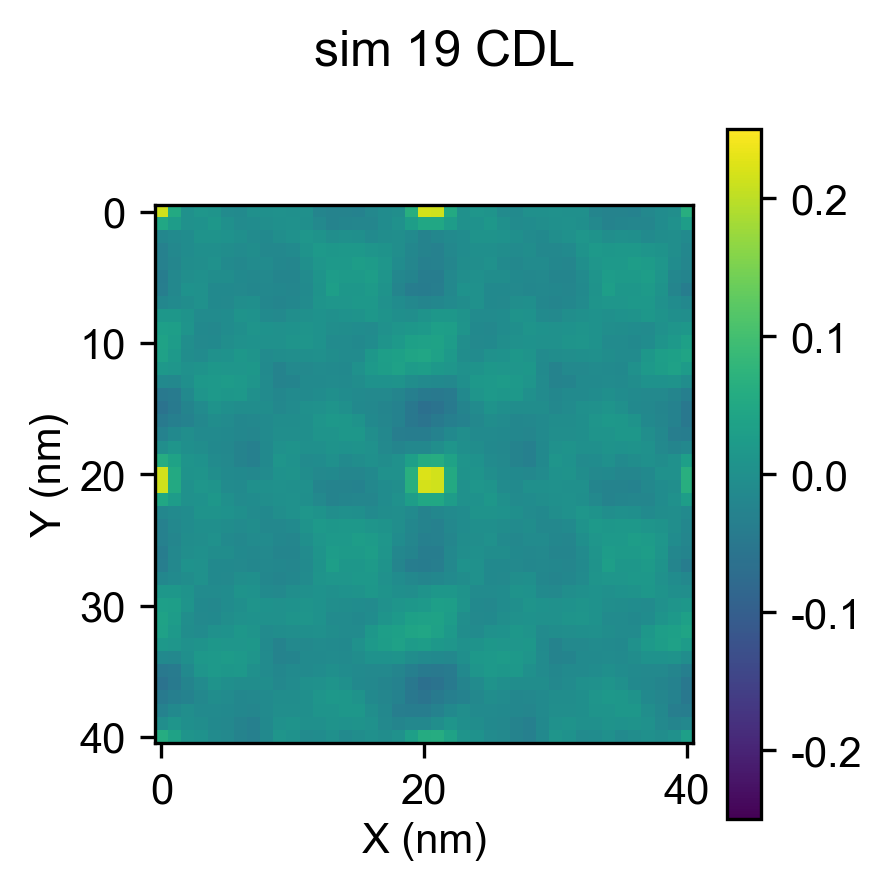

analyzing lipid PG
sim 24
analyzing lipid PC


  0%|          | 0/100 [00:00<?, ?it/s]

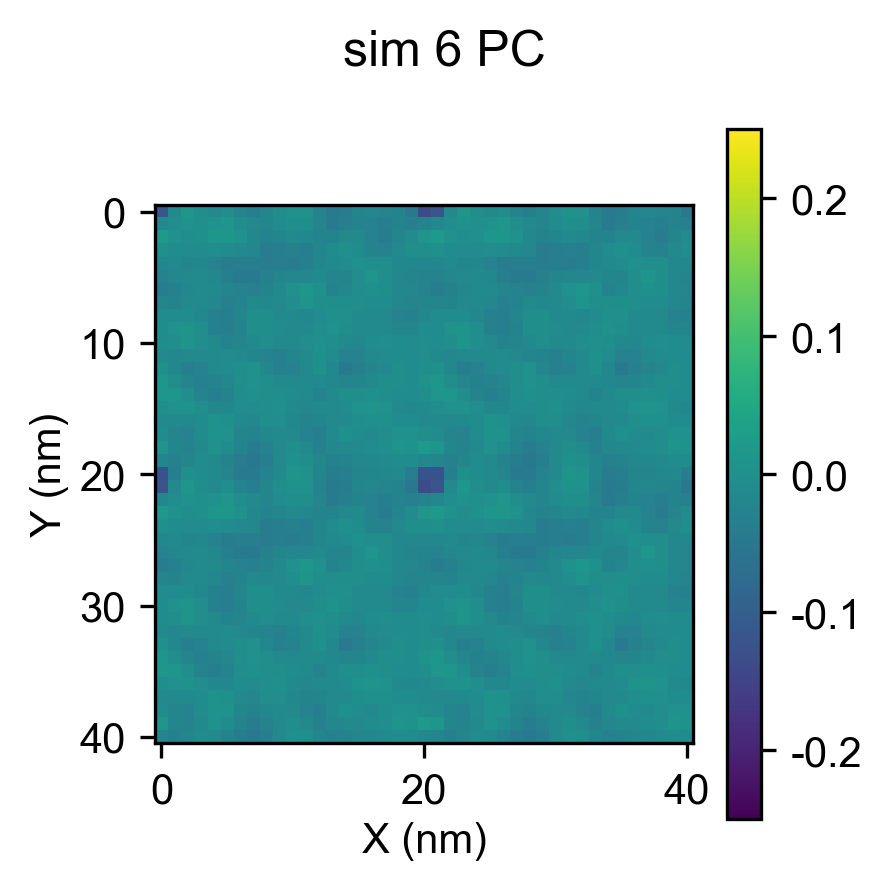

analyzing lipid PE


  0%|          | 0/100 [00:00<?, ?it/s]

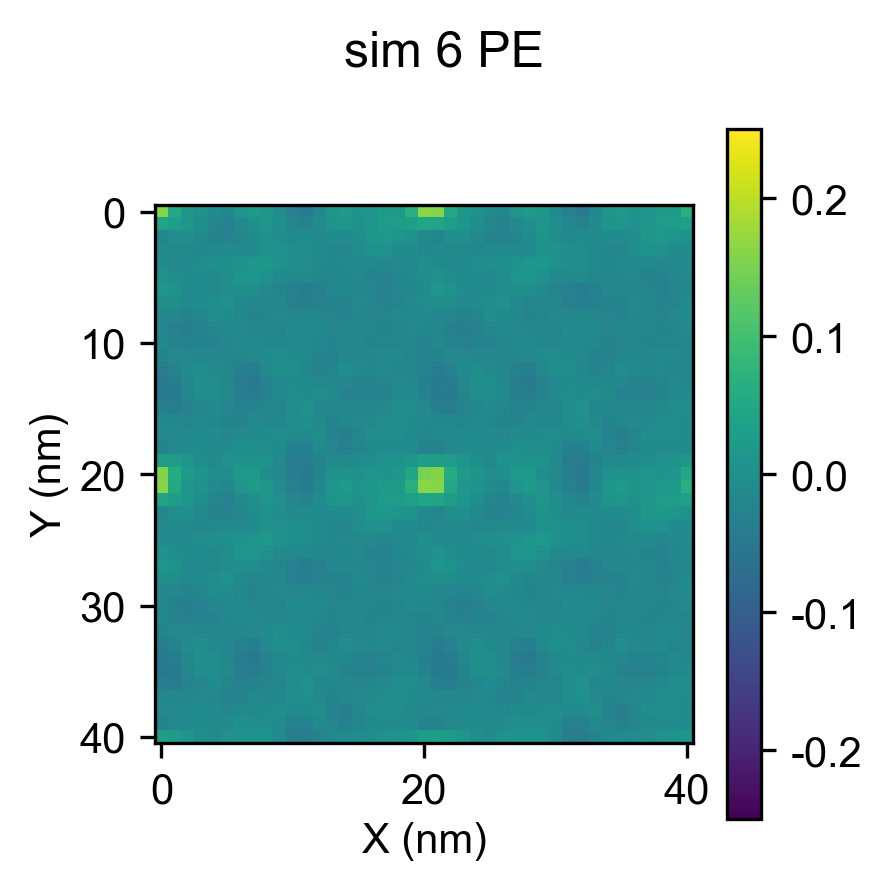

analyzing lipid CDL


  0%|          | 0/100 [00:00<?, ?it/s]

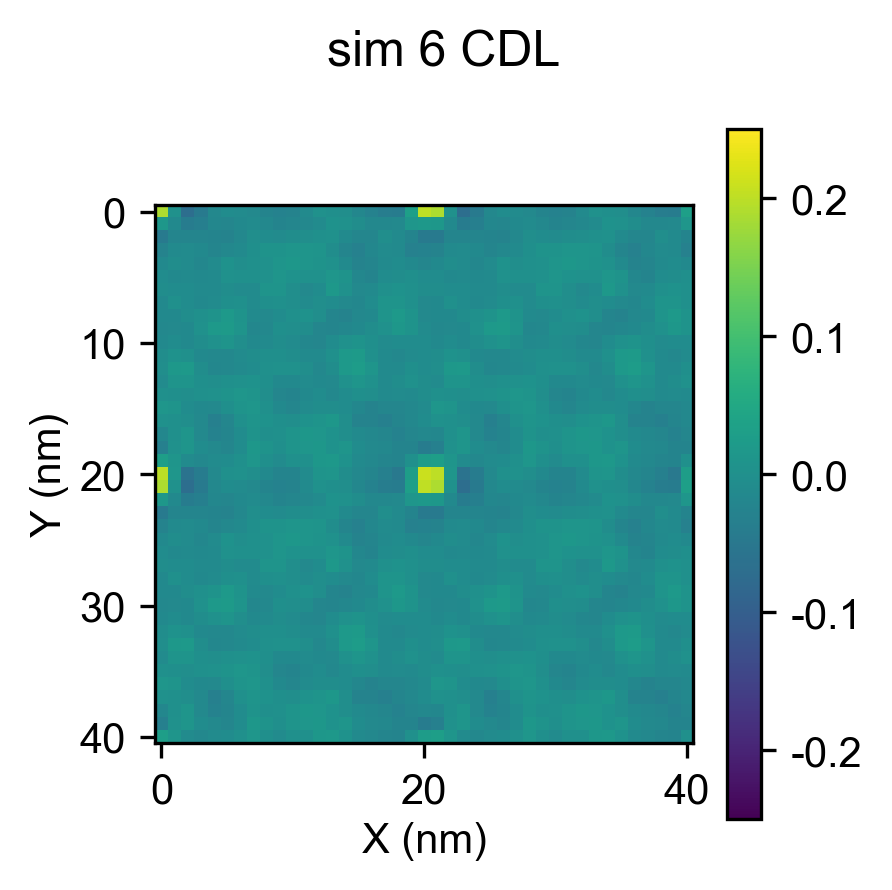

analyzing lipid PG
sim 1_vbt
analyzing lipid PC


  0%|          | 0/100 [00:00<?, ?it/s]

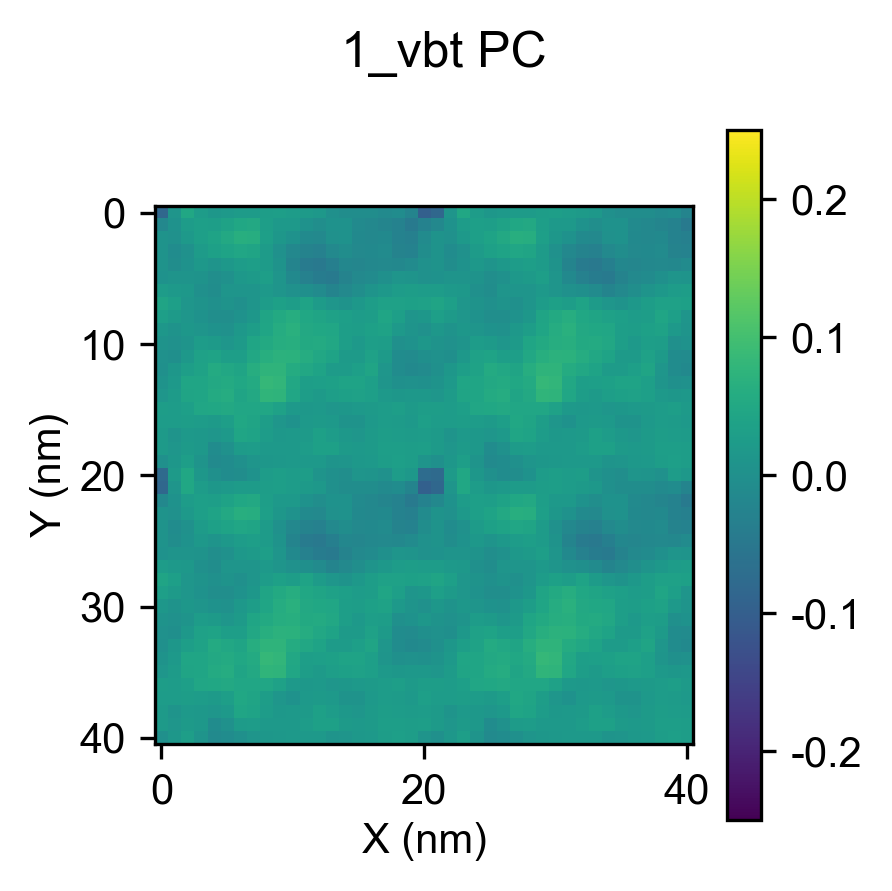

analyzing lipid PE


  0%|          | 0/100 [00:00<?, ?it/s]

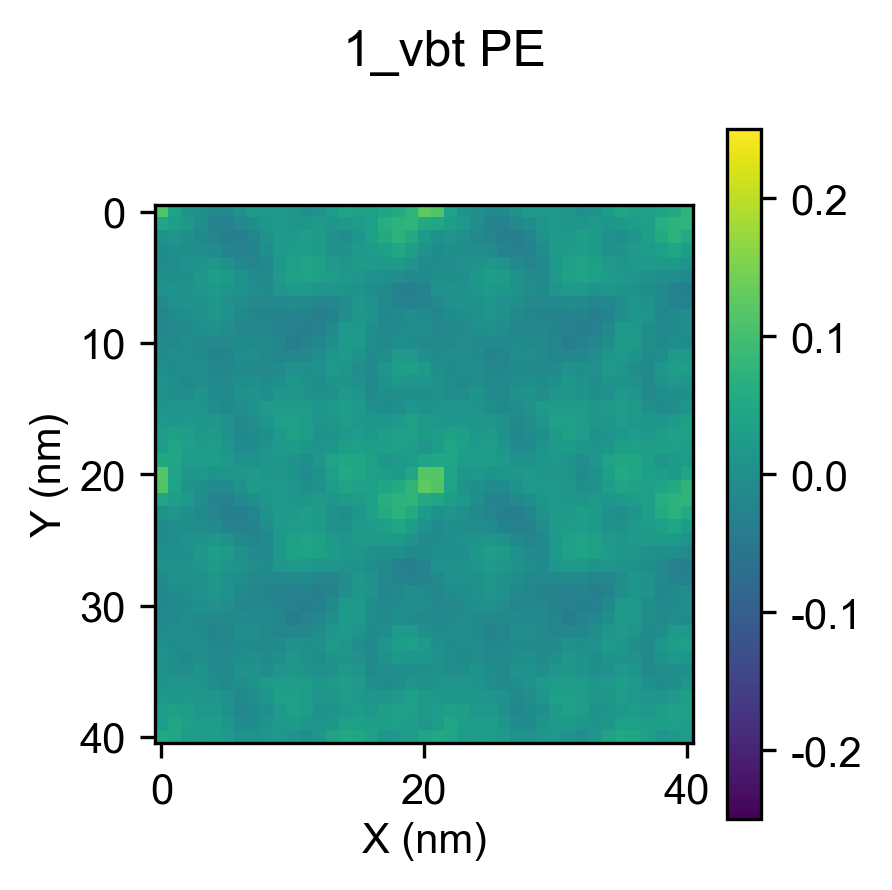

analyzing lipid CDL


  0%|          | 0/100 [00:00<?, ?it/s]

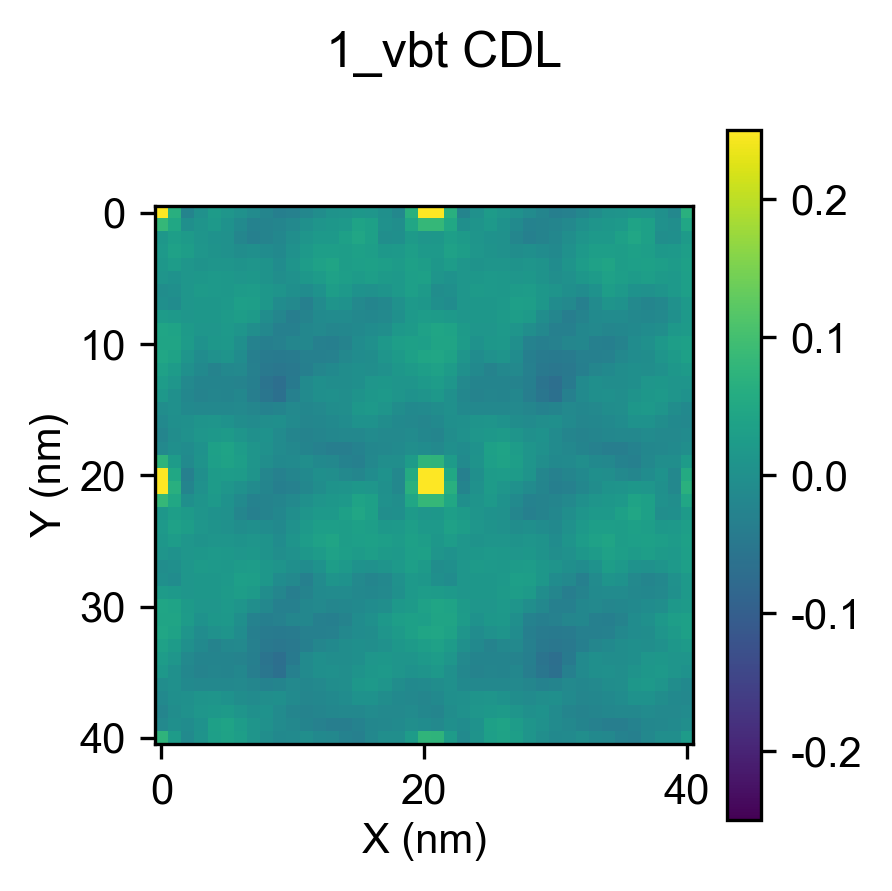

analyzing lipid PG


In [8]:
show_figs = True
curr_fig_path = Path("Figures/lipid_pearsons")
curr_fig_path.mkdir(parents=True, exist_ok=True)

frames_to_average = 10
sets_to_consider = 100


for sim in np.concatenate((util.simulations, ["1_vbt"])):
    print(f"sim {sim}")
    with open(
        util.analysis_path / f"{sim}/membrane_curvature_2nm.pickle", "rb"
    ) as handle:
        mc = pickle.load(handle)

    h = mc.results["height"][1:]
    mean_curvatures = np.zeros_like(h)
    for i in range(h.shape[0]):
        mean_curvatures[i] = mean_curvature(h[i])

    binned_mean_curvatures = np.zeros(
        (sets_to_consider, mean_curvatures.shape[1], mean_curvatures.shape[2])
    )

    gro = util.analysis_path / f"{sim}/po4_only.gro"
    traj = util.analysis_path / f"{sim}/po4_all.xtc"

    u = MDAnalysis.Universe(gro, str(traj), refresh_offsets=True)
    ag = determine_leaflets(u, po4_neighbor_sel)

    for k, query in queries.items():
        print(f"analyzing lipid {k}")

        if len(u.select_atoms(query)) == 0:
            continue

        binned_lipid_density = np.zeros(
            (sets_to_consider, mean_curvatures.shape[1], mean_curvatures.shape[2])
        )

        for i in range(sets_to_consider):
            if i == 0:
                binned_mean_curvatures[i] = np.mean(
                    mean_curvatures[-frames_to_average:],
                    axis=0,
                )
            else:
                binned_mean_curvatures[i] = np.mean(
                    mean_curvatures[-frames_to_average * (i + 1) : -frames_to_average * i],
                    axis=0,
                )

            binned_mean_curvatures[i] -= np.mean(binned_mean_curvatures)

            upper_positions = []
            lower_positions = []

            if i == 0:
                for ts in u.trajectory[-frames_to_average:]:
                    upper_positions.append(
                        ag["upper"].select_atoms(query).positions[:, 0:2]
                    )
                    lower_positions.append(
                        ag["upper"].select_atoms(query).positions[:, 0:2]
                    )
            else:
                for ts in u.trajectory[
                    -frames_to_average * (i + 1) : -frames_to_average * i
                ]:
                    upper_positions.append(
                        ag["upper"].select_atoms(query).positions[:, 0:2]
                    )
                    lower_positions.append(
                        ag["upper"].select_atoms(query).positions[:, 0:2]
                    )
            # Convert to numpy array
            upper_positions = np.vstack(upper_positions)
            lower_positions = np.vstack(lower_positions)

            binned_lipid_density[i], xe, ye = np.histogram2d(
                upper_positions[:, 0],
                upper_positions[:, 1],
                bins=mc.n_x_bins,
                range=[[mc.x_range[0], mc.x_range[1]], [mc.y_range[0], mc.y_range[1]]],
                density=True,
            )
            binned_lipid_density[i] -= np.mean(binned_lipid_density)

        ## COMPUTE 2D SPATIAL CORRELATION
        acr = []
        for i in tqdm(range(sets_to_consider)):
            acr.append(
                signal.correlate2d(
                    binned_mean_curvatures[i],
                    binned_lipid_density[i],
                    boundary="wrap",
                )
                / binned_mean_curvatures.shape[1] ** 2
                / (np.std(binned_mean_curvatures[i]) * np.std(binned_lipid_density[i]))
            )

        acr = np.mean(np.array(acr), axis=0)

        fig, ax = plt.subplots(1, 1, figsize=(3, 3))  # sharex=True,
        im = ax.imshow(acr, vmin=-0.25, vmax=0.25)

        fig.colorbar(im, ax=ax)
        ax.set_ylabel("Y (nm)")
        ax.set_xlabel("X (nm)")

        # limits = (len(acr)/2-5, len(acr)/2+4)
        # ax.set_xlim(*limits)
        # ax.set_ylim(*limits)

        if sim == "1_vbt":
            fig.suptitle(f"1_vbt {k}")
        else:
            fig.suptitle(f"sim {util.sim_to_final_index[int(sim)]} {k}")

        fig.tight_layout()

        if sim == "1_vbt":
            fig.savefig(curr_fig_path / f"1_vbt_correlation_{k}.png", format="png")
            fig.savefig(curr_fig_path / f"1_vbt_correlation_{k}.pdf", format="pdf")
        else:
            fig.savefig(
                curr_fig_path / f"{util.sim_to_final_index[int(sim)]}_correlation_{k}.png",
                format="png",
            )
            fig.savefig(
                curr_fig_path / f"{util.sim_to_final_index[int(sim)]}_correlation_{k}.pdf",
                format="pdf",
            )

        if show_figs:
            plt.show()

        fig.clear()
        plt.close(fig)


range(7, 10)
